In [38]:
from __future__ import print_function

import numpy as np
import yt
import unyt
from yt.units import *
from yt import YTArray
import argparse
import os
import glob
import sys
from astropy.table import Table
from astropy.io import ascii
import matplotlib.pyplot as plt
import random
from scipy import interpolate
#from photutils import detect_threshold, detect_sources, source_properties, EllipticalAperture
from scipy.interpolate import InterpolatedUnivariateSpline as IUS
from scipy.optimize import minimize
import trident
import ast
#import emcee
import numpy.random as rn
from multiprocessing import Pool
import matplotlib.patches as patches
from matplotlib.colors import ListedColormap
from yt.units import kpc, cm
import cmasher as cmr

# These imports are FOGGIE-specific files
from foggie.utils.consistency import *
from foggie.utils.get_refine_box import get_refine_box
from foggie.utils.get_halo_center import get_halo_center
from foggie.utils.get_proper_box_size import get_proper_box_size
from foggie.utils.get_run_loc_etc import get_run_loc_etc
from foggie.utils.yt_fields import *
from foggie.utils.foggie_load import *
from foggie.utils.analysis_utils import *

# These imports for datashader plots
import datashader as dshader
from datashader.utils import export_image
import datashader.transfer_functions as tf
import pandas as pd
import matplotlib as mpl
import h5py
import matplotlib.cm as mtcm
from matplotlib.colors import LogNorm
from matplotlib.lines import Line2D

from foggie.clumps.clump_finder.utils_diskproject import load_disk 
from collections import defaultdict
import pandas as pd
import math
import matplotlib.colors as colors
from mpl_toolkits.axes_grid1 import make_axes_locatable


from foggie.clumps.clump_finder.utils_clump_finder import *
from foggie.clumps.clump_finder.clump_finder_argparser import *
from foggie.clumps.clump_finder.fill_topology import *
from foggie.clumps.clump_finder.clump_load import *
from foggie.clumps.clump_finder.clump_finder import clump_finder



In [68]:
def generate_foggie_paths(halo, run, snap):
    # Define base paths
    foggie_base_dir = "/Users/vidasaeedzadeh/Projects/foggie_data/"
    code_base_path = "/Users/vidasaeedzadeh/Projects/repositories/foggie/foggie/"
    output_base_dir = "/Users/vidasaeedzadeh/Projects/foggie_outputs/"

    # Zero-pad the halo number to 6 digits
    halo_number = halo.zfill(6)

    # Define directory and file paths dynamically
    foggie_dir = os.path.join(foggie_base_dir, f"halo_{halo_number}", run + '/')
    snap_name = os.path.join(foggie_dir, snap, snap)
    halo_c_v_name = os.path.join(code_base_path, f"halo_infos/{halo_number}/{run}/halo_c_v")
    trackname = os.path.join(code_base_path, f"halo_tracks/{halo_number}/nref11n_selfshield_15/halo_track_200kpc_nref9")

    # Output directory (adjust based on needs)
    output_dir = output_base_dir

    # Return paths
    return foggie_dir,code_base_path, snap_name, halo_c_v_name, trackname, output_dir

# specify halo and snapshot

halos = ['5036','8508']#['2392','4123','5016','5036','8508']#['8508','5036','5016','4123','2392']
run = 'nref11c_nref9f'#'ludicrous/nref11c_nref9f.enhance'
snap ='RD0042' 
ions = ['HI','CII','CIII','CIV','OVI','SiII','SiIII','SiIV','MgII']
ions_dict = {'JUNIPER':['CII','CIII','CIV','OVI'], 'MAGPIE':['CIII','CIV','OVI','MgII']}
orientations = ['face','edge']
regions = ['all']
cmap = mtcm.get_cmap('Set1', 10)  

box_name = '100'
resolutions = resolutions = [round(r, 2) for r in [i * 0.3 for i in range(1, int(10 / 0.3) + 1)]]
#bin_size_kpc = '0.27'
#instrument_list = ['JUNIPER','MAGPIE']
output = 'RD0042'
#target_z_list = [0.00095, 0.0051, 0.01]
line_styles = ['solid', 'dashed', 'dotted']
unit_system = 'photons'

log_vals = np.logspace(np.log10(10), np.log10(1e5), num=124).astype(int)

flux_thresholds = {
    'HI': list(log_vals),
    'CII': list(log_vals),
    'CIII': list(log_vals),
    'CIV': list(log_vals),
    'OVI': list(log_vals),
    'MgII': list(log_vals),
    'SiII': list(log_vals),
    'SiIII': list(log_vals),
    'SiIV': list(log_vals)
}


x_lim_dict = {'HI': [-5,10], 'CII': [-15,10], 'CIII': [-10,10], 'CIV': [-5,10], 'OVI': [-1,10], 'SiII': [-15,10], 'SiIII': [-15,10], 'SiIV': [-15,10], 'MgII': [-15,10]}

def add_ion_fields(ds, ions):
    # Ensure ions is a list
    if isinstance(ions, str):
        ions = ions.split(',')  # Split the string into a list if necessary
    
    # Preprocess ions to ensure they are in the format expected by Trident
    formatted_ions = [trident_dict.get(ion, ion) for ion in ions]  # Replace using the dictionary if available
    
    # Add the formatted ions to the dataset
    trident.add_ion_fields(ds, formatted_ions)
    return ds




ions_number_density_dict = {'Lyalpha':'LyAlpha', 'HI':'H_p0_number_density', 'CII':'C_p1_number_density', 'CIII':'C_p2_number_density',
                                'CIV':'C_p3_number_density','OVI':'O_p5_number_density','SiII':'Si_p1_number_density','SiIII':'Si_p2_number_density',
                                 'SiIV':'Si_p3_number_density','MgII':'Mg_p1_number_density'}
trident_dict = { 'HI':'H I', 'CII':'C II','CIII':'C III',
                'CIV':'C IV','OVI':'O VI','SiII':'Si II','SiIII':'Si III','SiIV':'Si IV','MgII':'Mg II'}

def get_flux_threshold_dict(instrument_name, unit_system):
    if instrument_name == 'JUNIPER':
        if unit_system == 'photons':
            flux_threshold_dict = {'CII':1588.24, 'CIII':9000.00,'CIV':3857.14, 'OVI':1800.00} #photons/s/cm^2/sr
        elif unit_system == 'erg':
            flux_threshold_dict = {'OVI': 4e-19} 
        
    elif instrument_name == 'ASPERA':
        flux_threshold_dict = {'OVI': 3e-19} #ergs/s/cm^2/arcsec^2

    elif instrument_name == 'MAGPIE':
        if unit_system == 'photons':
            flux_threshold_dict = {'CIII': 675,'CIV': 650,'OVI': 270, 'MgII':675} #photons/s/cm^2/sr
        elif unit_system == 'erg':
            flux_threshold_dict = {'OVI': 3e-19} #ergs/s/cm^2/arcsec^2

    elif instrument_name == 'MUSE':
        if unit_system == 'erg':
            flux_threshold_dict = {'OVI': 3e-19} #ergs/s/cm^2/arcsec^2

    elif instrument_name == 'HWO':
        if unit_system == 'photons':
            flux_threshold_dict = {'OVI': 200} #photons/s/cm^2/sr
        elif unit_system == 'erg':
            flux_threshold_dict = {'OVI': 1.5e-20} #ergs/s/cm^2/arcsec^2  
    else:
        flux_threshold_dict = {}
    return flux_threshold_dict





/var/folders/03/8m_yf9p11xd_2mlw7w_4dw4w0000gn/T/ipykernel_47312/2157706118.py:31: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = mtcm.get_cmap('Set1', 10)


IndexError: list index out of range

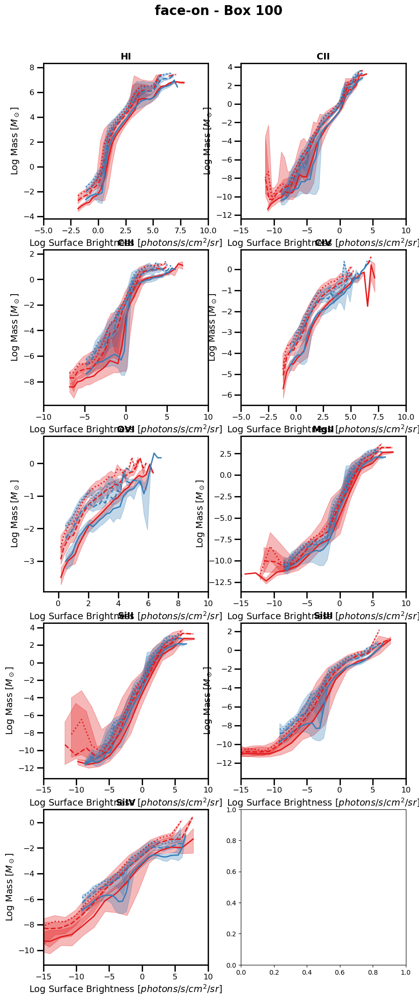

In [56]:
# Define resolutions and flux thresholds



all_ions = list(flux_thresholds.keys())

for orientation in orientations:
    mass_fraction_list = []
    spatial_res_list = []
    num_ions = len(all_ions)
    cols = __builtins__.min(2, num_ions)
    rows = math.ceil(num_ions / cols)
    fig, axes = plt.subplots(rows, cols, figsize=(5 * cols, 5 * rows), squeeze=False)
    plt.suptitle(f"{orientation}-on - Box {box_name}", fontsize=20, fontweight='bold', y=0.93)

    for res_index, resolution in enumerate(resolutions):
        for halo_index, halo in enumerate(halos):
            
            line_style = line_styles[res_index]
            foggie_dir, code_path, snap_name, halo_c_v_name, trackname, output_dir = generate_foggie_paths(halo, run, snap)
            prefix = output_dir + '/' + 'plots_halo_00'+ halo + '/' + run +'/FOGGIE' + '/'+ output + '/' + 'box_' + box_name + '/' + str(resolution) + '/'
            
            os.path.join(output_dir, 'FOGGIE', output, f'box_{box_name}', str(resolution))
            save_path = os.path.join(prefix, 'FRBs')
            halo_name = halo_dict[halo]
            color = cmap(halo_index)

            for region in regions:
                for ion_index, ion in enumerate(all_ions):
                    row, col = divmod(ion_index, cols)
                    ax = axes[row][col]

                    file_path = os.path.join(save_path, f"{halo_name}_emission_maps.hdf5")

                    try:
                        with h5py.File(file_path, 'r') as f:
                            grp = f['z=0.0']
                            spatial_res = grp.attrs['FRB_pixel_size_kpc']
                            spatial_res_list.append(spatial_res)
                    except Exception as e:
                        print(f"Failed to read pixel size from {file_path}: {e}")
                        continue

                    mass_dataset_name = f"z=0.0/{ion}_mass_{orientation}_{region}"
                    emission_dataset_name = f"z=0.0/{ion}_emission_{orientation}_{region}"

                    try:
                        with h5py.File(file_path, 'r') as f:
                            if mass_dataset_name not in f or emission_dataset_name not in f:
                                continue
                            mass_data = np.array(f[mass_dataset_name]).flatten()
                            emission_data = np.array(f[emission_dataset_name]).flatten()
                    except Exception as e:
                        print(f"Skipping {file_path} at {z} for {ion}: {e}")
                        continue

                    valid = (emission_data > 1e-40) & (mass_data > 0)
                    if not np.any(valid): continue

                    log_emission = np.log10(emission_data[valid])
                    log_mass = np.log10(mass_data[valid])

                    bins = np.linspace(log_emission.min(), log_emission.max(), 30)
                    bin_centers = 0.5 * (bins[:-1] + bins[1:])
                    median_values = []
                    lower_bounds = []
                    upper_bounds = []

                    for j in range(len(bins) - 1):
                        bin_mask = (log_emission >= bins[j]) & (log_emission < bins[j+1])
                        if np.any(bin_mask):
                            median_values.append(np.median(log_mass[bin_mask]))
                            lower_bounds.append(np.percentile(log_mass[bin_mask], 25))
                            upper_bounds.append(np.percentile(log_mass[bin_mask], 75))
                        else:
                            median_values.append(np.nan)
                            lower_bounds.append(np.nan)
                            upper_bounds.append(np.nan)

                    ax.plot(bin_centers, median_values, label=f'{halo_name}', color=color, linestyle=line_style, linewidth=2)
                    ax.fill_between(bin_centers, lower_bounds, upper_bounds, color=color, alpha=0.3)

                    ax.set_xlabel('Log Surface Brightness [$photons/s/cm^2/sr$]', fontsize=14)
                    ax.set_ylabel('Log Mass [$M_\\odot$]', fontsize=14)
                    ax.set_xlim(x_lim_dict.get(ion, [-15, 10]))
                    ax.set_title(ion, fontsize=14, fontweight='bold')

                    for spine in ax.spines.values():
                        spine.set_linewidth(2)
                        spine.set_color("k")

                    ax.tick_params(axis='both', which='major', labelsize=12, length=10, width=2, color="k")
                    ax.tick_params(axis='both', which='minor', length=5, width=1, color="k")

    plt.tight_layout(rect=[0, 0, 1, 0.96])
    halo_legend = [Line2D([0], [0], color=cmap(i), lw=3) for i in range(len(halos))]
    halo_labels = [halo_dict[halo] for halo in halos]

    ls_legend = [Line2D([0], [0], color='k', linestyle=line_styles[i], lw=2) for i in range(len(resolutions))]
    ls_labels = [f"z = {z}" for z in resolutions]

    unique_res = sorted(set(resolutions))
    print(unique_res)
    res_legend = [Line2D([0], [0], color='k', linestyle=line_styles[i], lw=2) for i in range(len(unique_res))]
    res_labels = [f"{res}" for res in unique_res]

    fig.legend(halo_legend, halo_labels, title="Halo", loc="upper center", bbox_to_anchor=(0.3, 1.0), ncol=len(halos), fontsize=9, title_fontsize=11)
    fig.legend(res_legend, res_labels, title="Spatial resolution [kpc]", loc="upper center", bbox_to_anchor=(0.8, 1.0), ncol=len(unique_res), fontsize=9, title_fontsize=11)

    plot_dir = os.path.join(output_dir, "allhalos_mass_vs_emission_plots")
    os.makedirs(plot_dir, exist_ok=True)
    plot_filename = f"allhalos_combined_{orientation}_mass_vs_emission_median.png"
    plt.savefig(os.path.join(plot_dir, plot_filename))
    plt.show()
    plt.close()

    


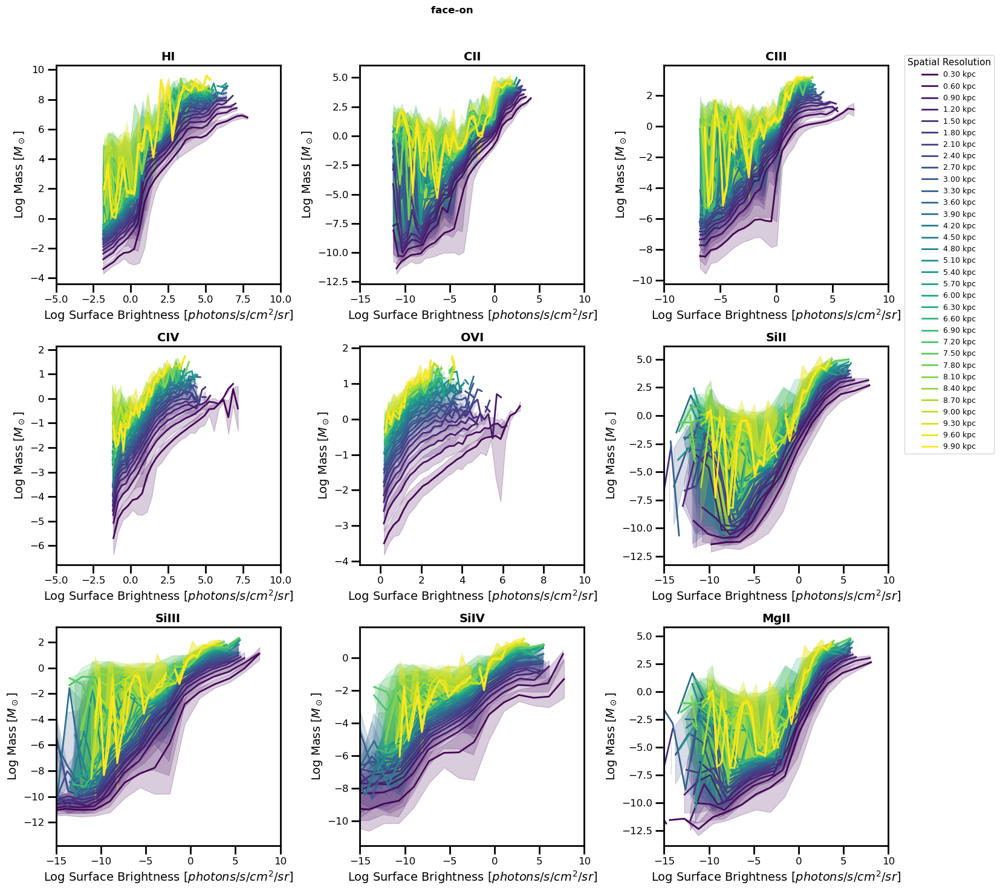

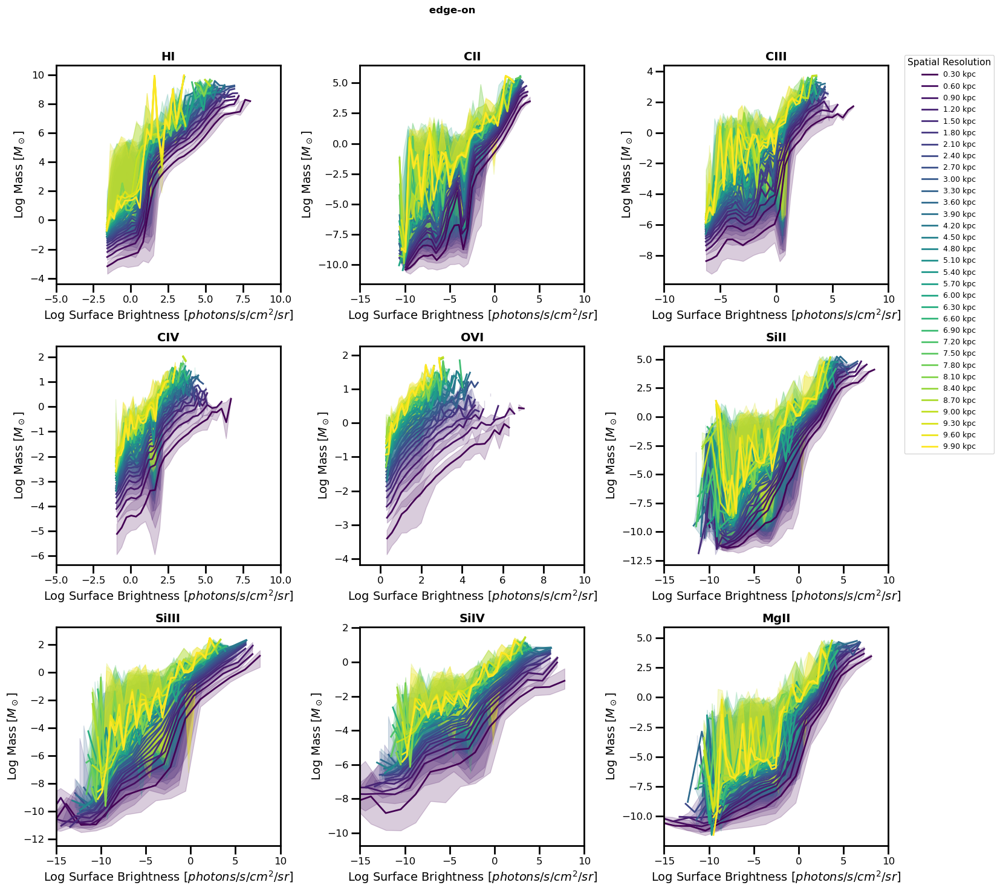

In [59]:
# Start main plotting loop

def print_group_attrs(file_path, group_path="z=0.0"):
    if not os.path.exists(file_path):
        print(f"File not found: {file_path}")
        return
    with h5py.File(file_path, 'r') as f:
        if group_path in f:
            grp = f[group_path]
            print(f"Attributes for group '{group_path}':")
            for key, val in grp.attrs.items():
                print(f"  {key}: {val}")
        else:
            print(f"Group '{group_path}' not found in {file_path}")


colors = plt.cm.viridis(np.linspace(0, 1, len(resolutions)))

for orientation in orientations:
    all_ions = ions
    num_ions = len(all_ions)
    cols = __builtins__.min(3, num_ions) 
    rows = math.ceil(num_ions / cols)
    fig, axes = plt.subplots(rows, cols, figsize=(5 * cols, 5 * rows), squeeze=False)
    plt.suptitle(f" {orientation}-on", fontsize=12, fontweight='bold', y=0.98)

    for ion_index, ion in enumerate(all_ions):
        row, col = divmod(ion_index, cols)
        ax = axes[row][col]

        for i, resolution in enumerate(resolutions):
            all_log_emission = []
            all_log_mass = []

            for halo in halos:
                foggie_dir, code_path, snap_name, halo_c_v_name, trackname, output_dir = generate_foggie_paths(halo, run, snap)
                prefix = output_dir + '/' + 'plots_halo_00'+ halo + '/' + run +'/FOGGIE' + '/'+ output + '/' + 'box_' + box_name + '/' + str(resolution) + '/'
                save_path = os.path.join(prefix, 'FRBs')
                halo_name = halo_dict[halo]

                for region in regions:
                    file_path = os.path.join(save_path, f"{halo_name}_emission_maps.hdf5")
                    try:
                        with h5py.File(file_path, 'r') as f:
                            mass_dataset = f"z=0.0/{ion}_mass_{orientation}_{region}"
                            emission_dataset = f"z=0.0/{ion}_emission_{orientation}_{region}"

                            if mass_dataset not in f or emission_dataset not in f:
                                continue

                            mass_data = np.array(f[mass_dataset]).flatten()
                            emission_data = np.array(f[emission_dataset]).flatten()

                            valid = (emission_data > 1e-40) & (mass_data > 0)
                            if not np.any(valid):
                                continue

                            log_emission = np.log10(emission_data[valid])
                            log_mass = np.log10(mass_data[valid])

                            all_log_emission.append(log_emission)
                            all_log_mass.append(log_mass)
                    except Exception as e:
                        continue

            if not all_log_emission:
                continue

            log_emission = np.concatenate(all_log_emission)
            log_mass = np.concatenate(all_log_mass)

            bins = np.linspace(log_emission.min(), log_emission.max(), 30)
            bin_centers = 0.5 * (bins[:-1] + bins[1:])
            median_values = []
            lower_bounds = []
            upper_bounds = []

            for j in range(len(bins) - 1):
                bin_mask = (log_emission >= bins[j]) & (log_emission < bins[j+1])
                if np.any(bin_mask):
                    median_values.append(np.median(log_mass[bin_mask]))
                    lower_bounds.append(np.percentile(log_mass[bin_mask], 16))
                    upper_bounds.append(np.percentile(log_mass[bin_mask], 84))
                else:
                    median_values.append(np.nan)
                    lower_bounds.append(np.nan)
                    upper_bounds.append(np.nan)

            ax.plot(bin_centers, median_values, label=f"{resolution:.2f} kpc", color=colors[i], linewidth=2)
            ax.fill_between(bin_centers, lower_bounds, upper_bounds, color=colors[i], alpha=0.2)

        ax.set_xlabel('Log Surface Brightness [$photons/s/cm^2/sr$]', fontsize=14)
        ax.set_ylabel('Log Mass [$M_\\odot$]', fontsize=14)
        ax.set_xlim(x_lim_dict.get(ion, [-15,10]))
        ax.set_title(ion, fontsize=14, fontweight='bold')

        for spine in ax.spines.values():
            spine.set_linewidth(2)
            spine.set_color("k")
        ax.tick_params(axis='both', which='major', labelsize=12, length=10, width=2, color="k")
        ax.tick_params(axis='both', which='minor', length=5, width=1, color="k")

    plt.tight_layout(rect=[0, 0, 1, 0.96])
    # Add legend for spatial resolution
    legend_handles = [Line2D([0], [0], color=colors[i], lw=2, label=f"{res:.2f} kpc") for i, res in enumerate(resolutions)]
    fig.legend(handles=legend_handles, title="Spatial Resolution", loc="upper center", bbox_to_anchor=(1.05, 0.93), ncol = 1, fontsize=9, title_fontsize=11)

    plot_dir = os.path.join(output_dir, "allhalos_mass_vs_emission_plots")
    os.makedirs(plot_dir, exist_ok=True)
    plot_filename = f"allhalos_combined_{orientation}_mass_vs_emission_median_by_resolution.png"
    plt.savefig(os.path.join(plot_dir, plot_filename))
    plt.show()
    plt.close()


In [69]:


output_data = []

for orientation in orientations:
    for halo in halos:
        for resolution in resolutions:
            
            foggie_dir, code_path, snap_name, halo_c_v_name, trackname, output_dir = generate_foggie_paths(halo, run, snap)
            halo_name = halo_dict[halo]

            prefix = output_dir + '/' + 'plots_halo_00'+ halo + '/' + run +'/FOGGIE' + '/'+ output + '/' + 'box_' + box_name + '/' + str(resolution) + '/'
            save_path = os.path.join(prefix, 'FRBs')
            file_path = os.path.join(save_path, f"{halo_name}_emission_maps.hdf5")

            try:
                with h5py.File(file_path, 'r') as f:
                    spatial_res = f['z=0.0'].attrs['FRB_pixel_size_kpc']
            except:
                continue

            for region in regions:
                for ion in ions:
                    if ion not in flux_thresholds:
                        continue

                    try:
                        with h5py.File(file_path, 'r') as f:
                            mass_data = np.array(f[f'z=0.0/{ion}_mass_{orientation}_{region}']).flatten()
                            emission_data = np.array(f[f'z=0.0/{ion}_emission_{orientation}_{region}']).flatten()
                    except:
                        continue

                    valid = (emission_data > 1e-40) & (mass_data > 0)
                    if not np.any(valid):
                        continue

                    emission_valid = emission_data[valid]
                    mass_valid = mass_data[valid]
                    total_mass = mass_valid.sum()

                    for thresh in flux_thresholds[ion]:
                        mass_above = mass_valid[emission_valid >= thresh].sum()
                        frac = (mass_above / total_mass) * 100 if total_mass > 0 else np.nan

                        output_data.append({
                            'halo': halo_name,
                            'ion': ion,
                            'orientation': orientation,
                            'spatial_res_kpc': spatial_res,
                            'flux_threshold': thresh,
                            'mass_fraction': frac
                        })

# Save to CSV
df = pd.DataFrame(output_data)
out_dir = os.path.join(output_dir, "allhalos_mass_fraction_summary")
os.makedirs(out_dir, exist_ok=True)
out_path = os.path.join(out_dir, "mass_fraction_by_threshold.csv")
df.to_csv(out_path, index=False)
print(f"Saved {len(df)} rows to {out_path}")


Saved 147312 rows to /Users/vidasaeedzadeh/Projects/foggie_outputs/allhalos_mass_fraction_summary/mass_fraction_by_threshold.csv


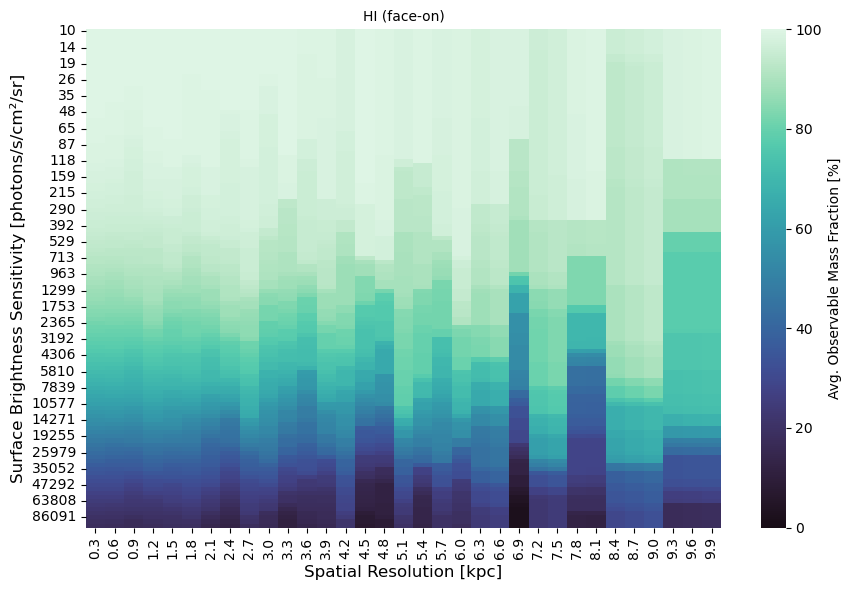

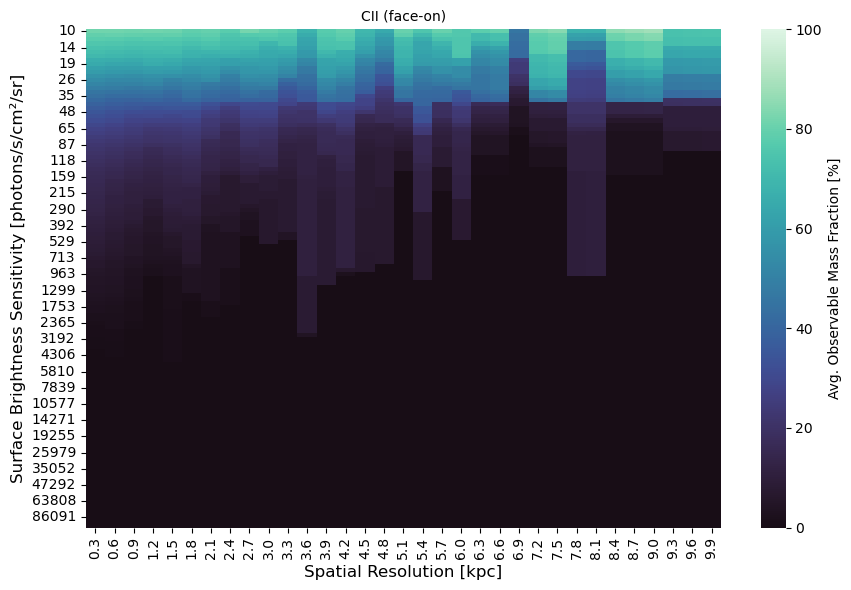

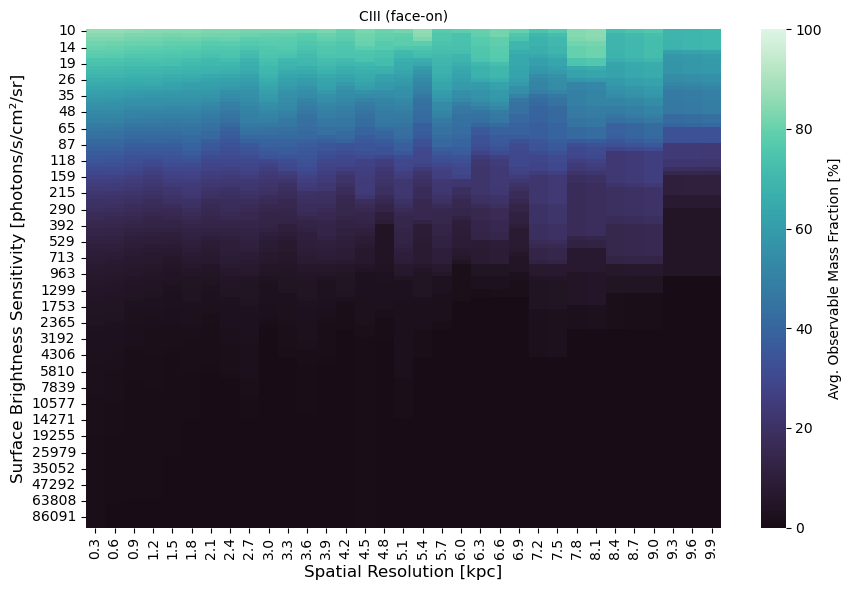

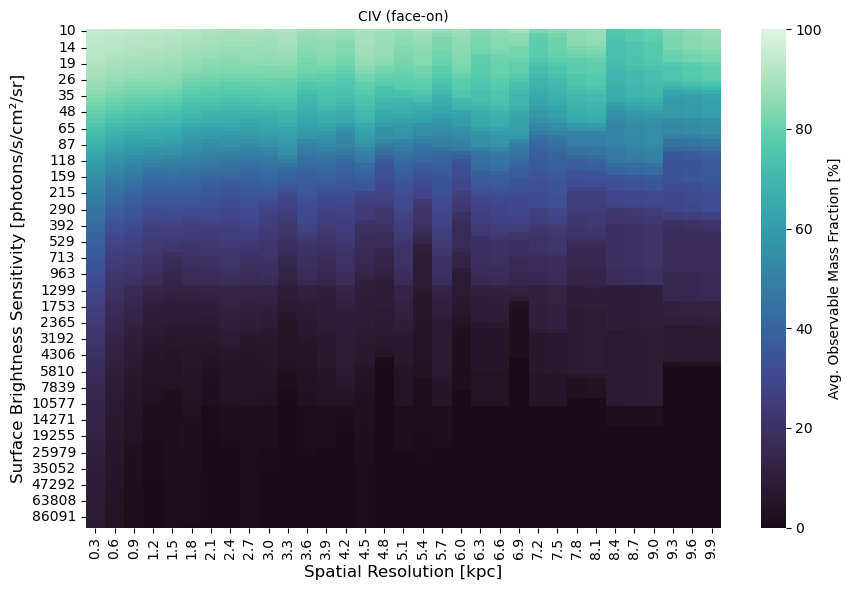

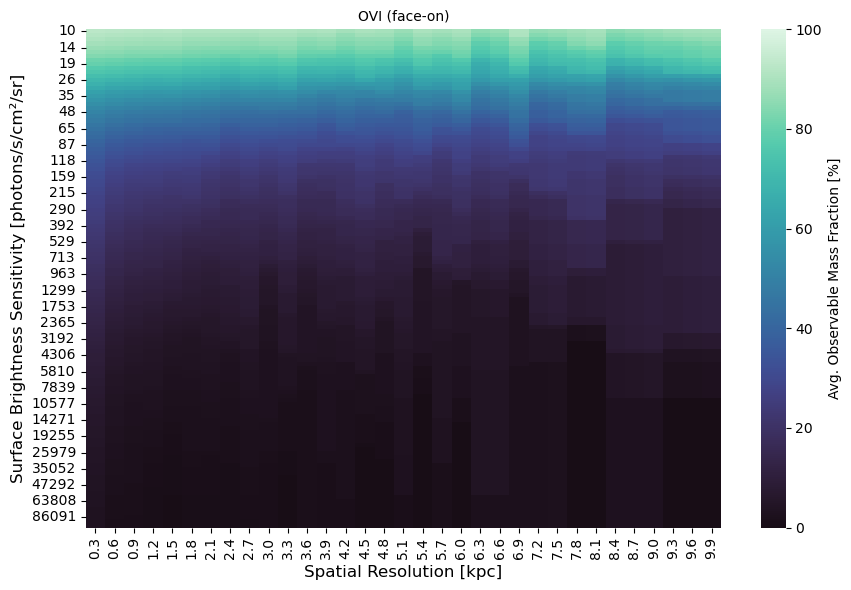

...

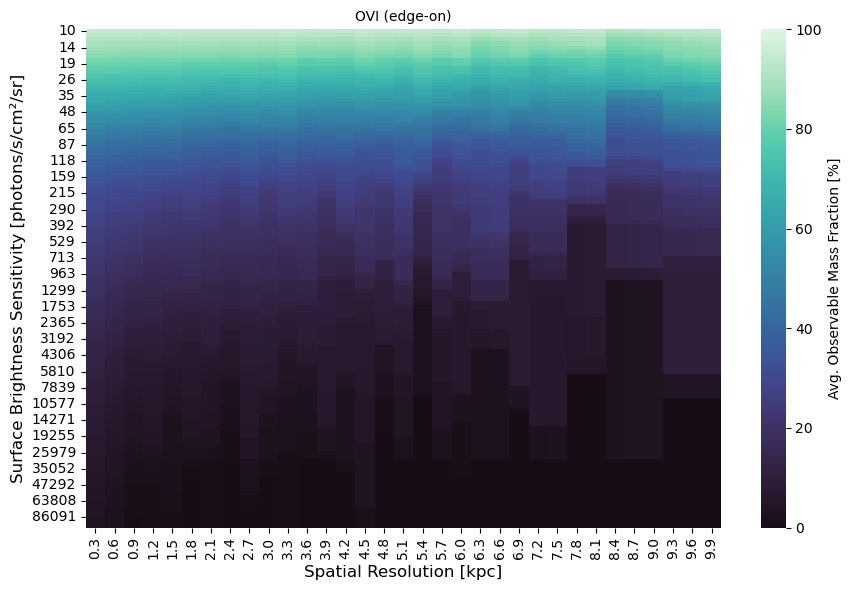

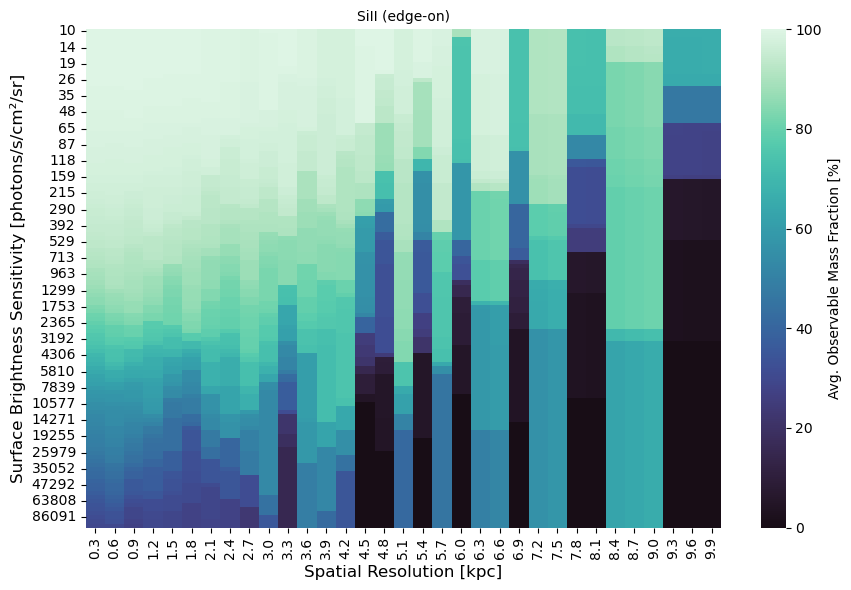

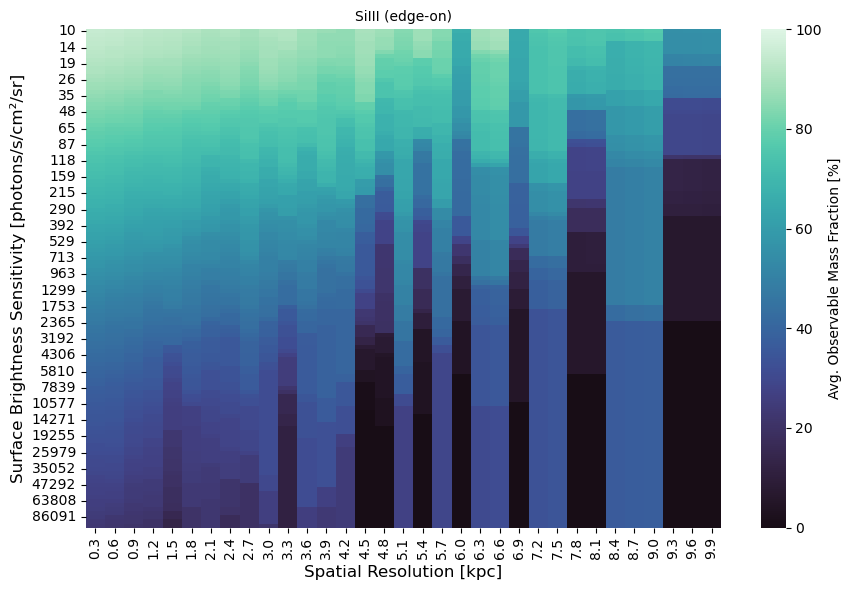

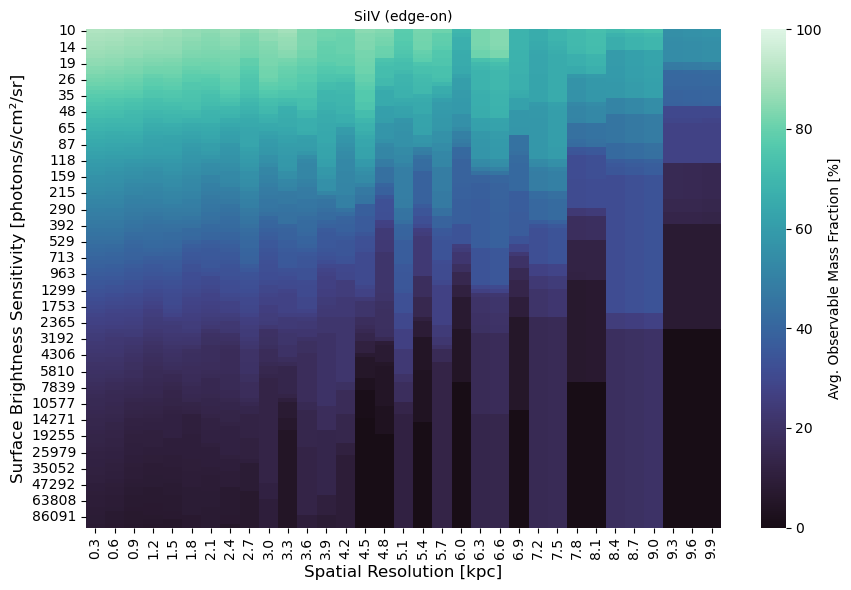

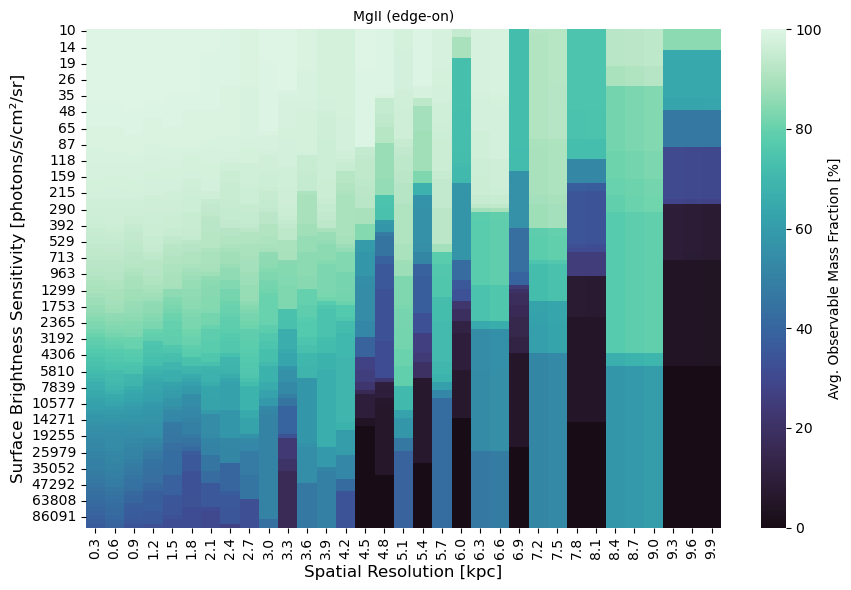

In [70]:
ion_list = ions
unit_system = 'photons'

# Path to the unified mass fraction CSV
csv_path = os.path.join(output_dir, "allhalos_mass_fraction_summary", "mass_fraction_by_threshold.csv")
df_all = pd.read_csv(csv_path)

# Loop over orientations and ions
for orientation in orientations:
    df_orientation = df_all[df_all['orientation'] == orientation]

    for ion in ion_list:
        df_ion = df_orientation[df_orientation['ion'] == ion]
        if df_ion.empty:
            print(f"Skipping {ion} ({orientation}) — no data available.")
            continue

        # Group and pivot for heatmap
        pivot_df = df_ion.groupby(['flux_threshold', 'spatial_res_kpc'])['mass_fraction'].mean().reset_index()
        pivot_table = pivot_df.pivot(index='flux_threshold', columns='spatial_res_kpc', values='mass_fraction')
        pivot_table = pivot_table.sort_index(axis=0)
        pivot_table = pivot_table.sort_index(axis=1)

        # Plot
        fig, ax = plt.subplots(figsize=(9, 6))
        sns.heatmap(
            pivot_table,
            cmap=cmr.get_sub_cmap('mako', 0.05, 1),
            vmin=0,
            vmax=100,
            cbar_kws={'label': 'Avg. Observable Mass Fraction [%]'},
            annot=False,
            fmt=".1f",
            ax=ax
        )

        ax.set_xlabel("Spatial Resolution [kpc]", fontsize=12)
        ax.set_ylabel("Surface Brightness Sensitivity [photons/s/cm²/sr]", fontsize=12)
        ax.set_title(f"{ion} ({orientation}-on)", fontsize=10)
        
        # Save
        plot_dir = os.path.join(output_dir, "allhalos_mass_vs_spatial_res_plots")
        os.makedirs(plot_dir, exist_ok=True)
        plot_filename = f"allhalos_Heatmap_{ion}_{orientation}_fluxlimit_vs_spatialres.png"
        plt.savefig(os.path.join(plot_dir, plot_filename))

        plt.tight_layout()
        plt.show()


Plots with instrument specifications

In [ ]:



# Start main plotting loop
def print_group_attrs(file_path, group_path="z=0.0"):
            if not os.path.exists(file_path):
                print(f"File not found: {file_path}")
                return

            with h5py.File(file_path, 'r') as f:
                if group_path in f:
                    grp = f[group_path]
                    print(f"Attributes for group '{group_path}':")
                    for key, val in grp.attrs.items():
                        print(f"  {key}: {val}")
                else:
                    print(f"Group '{group_path}' not found in {file_path}")




for instrument_name in instrument_list:
    flux_threshold_dict = get_flux_threshold_dict(instrument_name, unit_system)
    
    ions = ions_dict[instrument_name]
    print(ions)
    for orientation in orientations:
        mass_fraction_list = []
        spatial_res_list = []
        num_ions = len(ions)
        cols = __builtins__.min(2, num_ions)  # Limit to max 3 columns per row
        rows = math.ceil(num_ions / cols)
        fig, axes = plt.subplots(rows, cols, figsize=(5 * cols, 5 * rows), squeeze=False)
        plt.suptitle(f'{instrument_name} - {orientation}-on - Box {box_name}', fontsize=20, fontweight='bold', y = 0.93)

        for halo_index, halo in enumerate(halos):
            for z_index, z in enumerate(target_z_list):
                target_z = str(z)
                line_style = line_styles[z_index]
                foggie_dir, code_path, snap_name, halo_c_v_name, trackname, output_dir = generate_foggie_paths(halo, run, snap)
                prefix = output_dir + '/FOGGIE' + '/' + output + '/' + 'box_' + box_name + '/' + resolution + '/'
                #prefix = output_dir + 'plots_halo_00'+ halo + '/' + run + '/' + instrument_name + '/' + output + '/' + 'target_z_' + target_z + '/'+ 'box_' + box_name + '/'
                save_path = os.path.join(prefix, 'FRBs/')
                halo_name = halo_dict[halo]
                color = cmap(halo_index)

                for region in regions:
                    for ion_index, ion in enumerate(ions):
                        row, col = divmod(ion_index, cols)
                        ax = axes[row][col]

                        file_path = os.path.join(save_path, f"{halo_name}_emission_maps.hdf5")

                        #print_group_attrs(file_path, group_path="z=0.0")

                        try:
                            with h5py.File(file_path, 'r') as f:
                                grp = f['z=0.0']
                                spatial_res = grp.attrs['FRB_pixel_size_kpc']
                                spatial_res_list.append(spatial_res)
                        except Exception as e:
                            print(f"Failed to read pixel size from {file_path}: {e}")
                            continue

                        

                        mass_dataset_name = f"z=0.0/{ion}_mass_{orientation}_{region}"
                        emission_dataset_name = f"z=0.0/{ion}_emission_{orientation}_{region}"

                        
                        try:
                            with h5py.File(file_path, 'r') as f:
                                if mass_dataset_name not in f or emission_dataset_name not in f:
                                    continue

                                mass_data = np.array(f[mass_dataset_name]).flatten()
                                emission_data = np.array(f[emission_dataset_name]).flatten()
                        except Exception as e:
                            print(f"Skipping {file_path} at {z_str} for {ion}: {e}")
                            continue

                        valid = (emission_data > 1e-40) & (mass_data > 0)
                        if not np.any(valid): continue

                        log_emission = np.log10(emission_data[valid])
                        log_mass = np.log10(mass_data[valid])

                        bins = np.linspace(log_emission.min(), log_emission.max(), 30)
                        bin_centers = 0.5 * (bins[:-1] + bins[1:])
                        median_values = []
                        lower_bounds = []
                        upper_bounds = []

                        for j in range(len(bins) - 1):
                            bin_mask = (log_emission >= bins[j]) & (log_emission < bins[j+1])
                            if np.any(bin_mask):
                                median_values.append(np.median(log_mass[bin_mask]))
                                lower_bounds.append(np.percentile(log_mass[bin_mask], 25))
                                upper_bounds.append(np.percentile(log_mass[bin_mask], 75))
                            else:
                                median_values.append(np.nan)
                                lower_bounds.append(np.nan)
                                upper_bounds.append(np.nan)

                        
                        ax.plot(bin_centers, median_values, label=f'{halo_name} z={z}', color=color, linestyle=line_style, linewidth=2)
                        ax.fill_between(bin_centers, lower_bounds, upper_bounds, color=color, alpha=0.3)

                        # Surface brightness threshold
                        flux_threshold_dict = get_flux_threshold_dict(instrument_name, unit_system)
                        if ion in flux_threshold_dict:
                            sb_thresh = np.log10(flux_threshold_dict[ion])
                            ax.axvline(sb_thresh, linestyle='--', color='k', linewidth=1)

                            mass_above_thresh = mass_data[valid][log_emission >= sb_thresh].sum()
                            total_mass = mass_data[valid].sum()
                            if total_mass > 0:
                                if total_mass > 0:
                                    frac_mass = (mass_above_thresh / total_mass)*100 # Convert to percentage
                                    
                                    mass_fraction_list.append({
                                                                "instrument": instrument_name,
                                                                "orientation": orientation,
                                                                "halo": halo_name,
                                                                "ion": ion,
                                                                "redshift": z,
                                                                "mass_fraction": frac_mass,
                                                                "spatial_res_kpc": spatial_res  # pulled from the HDF5 group attribute
                                                            })



                        # Format plot
                        ax.set_xlabel('Log Surface Brightness [$photons/s/cm^2/sr$]', fontsize=14)
                        ax.set_ylabel('Log Mass [$M_\\odot$]', fontsize=14)
                        ax.set_xlim(x_lim_dict.get(ion, [-15,10]))
                        ax.set_title(ion, fontsize=14, fontweight='bold')

                        for spine in ax.spines.values():
                            spine.set_linewidth(2)
                            spine.set_color("k")

                        ax.tick_params(axis='both', which='major', labelsize=12, length=10, width=2, color="k")
                        ax.tick_params(axis='both', which='minor', length=5, width=1, color="k")

        # Clean legends
        
        # for ax in axes.flatten():
        #     handles, labels = ax.get_legend_handles_labels()
        #     by_label = dict(zip(labels, handles))
        #     if by_label:
        #         ax.legend(by_label.values(), by_label.keys(), fontsize=10)

        plt.tight_layout(rect=[0, 0, 1, 0.96])
        # Halo color legend
        halo_legend = [Line2D([0], [0], color=cmap(i), lw=3) for i in range(len(halos))]
        halo_labels = [halo_dict[halo] for halo in halos]

        # Redshift linestyle legend
        ls_legend = [Line2D([0], [0], color='k', linestyle=line_styles[i], lw=2) for i in range(len(target_z_list))]
        ls_labels = [f"z = {z}" for z in target_z_list]

        #resolution legend
        unique_res = sorted(set(spatial_res_list))
        res_legend = [Line2D([0], [0], color='k', linestyle=line_styles[i], lw=2) for i in range(len(unique_res))]
        res_labels = [f"{res}" for res in unique_res]


        # Add legends once for the whole figure
        fig.legend(halo_legend, halo_labels, title="Halo", loc="upper center", bbox_to_anchor=(0.3, 1.0), ncol=len(halos), fontsize=9, title_fontsize=11)
        fig.legend(res_legend, res_labels, title="Spatial resolution [kpc]", loc="upper center", bbox_to_anchor=(0.8, 1.0), ncol=len(target_z_list), fontsize=9, title_fontsize=11)
        plot_dir = os.path.join(output_dir, "allhalos_mass_vs_emission_plots")
        os.makedirs(plot_dir, exist_ok=True)
        plot_filename = f"allhalos_{instrument_name}_{orientation}_mass_vs_emission_median.png"
        plt.savefig(os.path.join(plot_dir, plot_filename))
        plt.show()
        plt.close()

        # Save after plotting for this orientation
        df_mass_fractions = pd.DataFrame(mass_fraction_list)
        csv_path = os.path.join(plot_dir, f"mass_fraction_summary_{instrument_name}_{orientation}.csv")
        df_mass_fractions.to_csv(csv_path, index=False)

print(f"Saved {len(df_mass_fractions)} rows to {csv_path}")


In [ ]:
# Start main plotting loop

def print_group_attrs(file_path, group_path="z=0.0"):
    if not os.path.exists(file_path):
        print(f"File not found: {file_path}")
        return
    with h5py.File(file_path, 'r') as f:
        if group_path in f:
            grp = f[group_path]
            print(f"Attributes for group '{group_path}':")
            for key, val in grp.attrs.items():
                print(f"  {key}: {val}")
        else:
            print(f"Group '{group_path}' not found in {file_path}")

cmap_res = mtcm.get_cmap('plasma', 5)  

for instrument_name in instrument_list:
    flux_threshold_dict = get_flux_threshold_dict(instrument_name, unit_system)
    ions = ions_dict[instrument_name]
    for orientation in orientations:
        mass_fraction_list = []
        spatial_res_list = []
        num_ions = len(ions)
        cols = __builtins__.min(2, num_ions)
        rows = math.ceil(num_ions / cols)
        fig, axes = plt.subplots(rows, cols, figsize=(5 * cols, 5 * rows), squeeze=False)
        plt.suptitle(f'{instrument_name} - {orientation}-on - Box {box_name}', fontsize=20, fontweight='bold', y=0.93)

        for ion_index, ion in enumerate(ions):
            row, col = divmod(ion_index, cols)
            ax = axes[row][col]

            for z_index, z in enumerate(target_z_list):
                target_z = str(z)
                line_style = line_styles[z_index]
                #color = cmap_res(z_index)

                all_log_emission = []
                all_log_mass = []

                for halo_index, halo in enumerate(halos):
                    foggie_dir, code_path, snap_name, halo_c_v_name, trackname, output_dir = generate_foggie_paths(halo, run, snap)
                    prefix = output_dir + 'plots_halo_00'+ halo + '/' + run + '/' + instrument_name + '/' + output + '/' + 'target_z_' + target_z + '/'+ 'box_' + box_name + '/'
                    save_path = os.path.join(prefix, 'FRBs/')
                    halo_name = halo_dict[halo]

                    for region in regions:
                        file_path = os.path.join(save_path, f"{halo_name}_emission_maps.hdf5")
                        try:
                            with h5py.File(file_path, 'r') as f:
                                grp = f['z=0.0']
                                spatial_res = grp.attrs['FRB_pixel_size_kpc']
                                if spatial_res < 0.27:
                                    spatial_res = 0.27
                                spatial_res_list.append(spatial_res)
                        except:
                            continue

                        mass_dataset_name = f"z=0.0/{ion}_mass_{orientation}_{region}"
                        emission_dataset_name = f"z=0.0/{ion}_emission_{orientation}_{region}"
                        

                        try:
                            with h5py.File(file_path, 'r') as f:
                                if mass_dataset_name not in f or emission_dataset_name not in f:
                                    continue
                                mass_data = np.array(f[mass_dataset_name]).flatten()
                                emission_data = np.array(f[emission_dataset_name]).flatten()
                        except:
                            continue

                        valid = (emission_data > 1e-40)# & (mass_data > 0)
                        if not np.any(valid): continue

                        all_log_emission.append(np.log10(emission_data[valid]))
                        all_log_mass.append(np.log10(mass_data[valid]))

                if not all_log_emission: continue

                log_emission = np.concatenate(all_log_emission)
                log_mass = np.concatenate(all_log_mass)

                bins = np.linspace(log_emission.min(), log_emission.max(), 30)
                bin_centers = 0.5 * (bins[:-1] + bins[1:])
                median_values = []
                lower_bounds = []
                upper_bounds = []

                for j in range(len(bins) - 1):
                    bin_mask = (log_emission >= bins[j]) & (log_emission < bins[j+1])
                    if np.any(bin_mask):
                        median_values.append(np.median(log_mass[bin_mask]))
                        lower_bounds.append(np.percentile(log_mass[bin_mask], 16))
                        upper_bounds.append(np.percentile(log_mass[bin_mask], 84))
                    else:
                        median_values.append(np.nan)
                        lower_bounds.append(np.nan)
                        upper_bounds.append(np.nan)

                ax.plot(bin_centers, median_values, color=cmap_res(1), linestyle=line_style, linewidth=2, label=f'z={z}')
                ax.fill_between(bin_centers, lower_bounds, upper_bounds, color=cmap_res(1), alpha=0.2)

            # Flux limit shading
            if ion in flux_threshold_dict:
                sb_thresh = np.log10(flux_threshold_dict[ion])
                ax.axvspan(sb_thresh, 10, color='yellow', alpha=0.1)

            ax.set_xlabel('Log Surface Brightness [$photons/s/cm^2/sr$]', fontsize=14)
            ax.set_ylabel('Log Mass [$M_\\odot$]', fontsize=14)
            ax.set_xlim(x_lim_dict.get(ion, [-15,10]))
            ax.set_title(ion, fontsize=14, fontweight='bold')
            for spine in ax.spines.values():
                spine.set_linewidth(2)
                spine.set_color("k")
            ax.tick_params(axis='both', which='major', labelsize=12, length=10, width=2, color="k")
            ax.tick_params(axis='both', which='minor', length=5, width=1, color="k")

        plt.tight_layout(rect=[0, 0, 1, 0.96])
        # Spatial resolution legend
        unique_res = sorted(set(spatial_res_list))
        res_legend = [Line2D([0], [0], color='k', linestyle=line_styles[i], lw=2) for i in range(len(unique_res))]
        res_labels = [f"{res:.2f} kpc" for res in unique_res]

        fig.legend(res_legend, res_labels, title="Spatial Resolution [kpc]", loc="upper center",
           bbox_to_anchor=(0.5, 1.0), ncol=len(unique_res), fontsize=9, title_fontsize=11)


        plot_dir = os.path.join(output_dir, "allhalos_mass_vs_emission_plots")
        os.makedirs(plot_dir, exist_ok=True)
        plot_filename = f"allhalos_{instrument_name}_{orientation}_stacked_mass_vs_emission_median.png"
        plt.savefig(os.path.join(plot_dir, plot_filename))
        plt.show()
        plt.close()

<>:141: SyntaxWarning: invalid escape sequence '\o'
<>:141: SyntaxWarning: invalid escape sequence '\o'
/var/folders/03/8m_yf9p11xd_2mlw7w_4dw4w0000gn/T/ipykernel_39636/1740695613.py:141: SyntaxWarning: invalid escape sequence '\o'
  ax.set_ylabel('Log Mass [$M_\odot$]', fontsize=14)


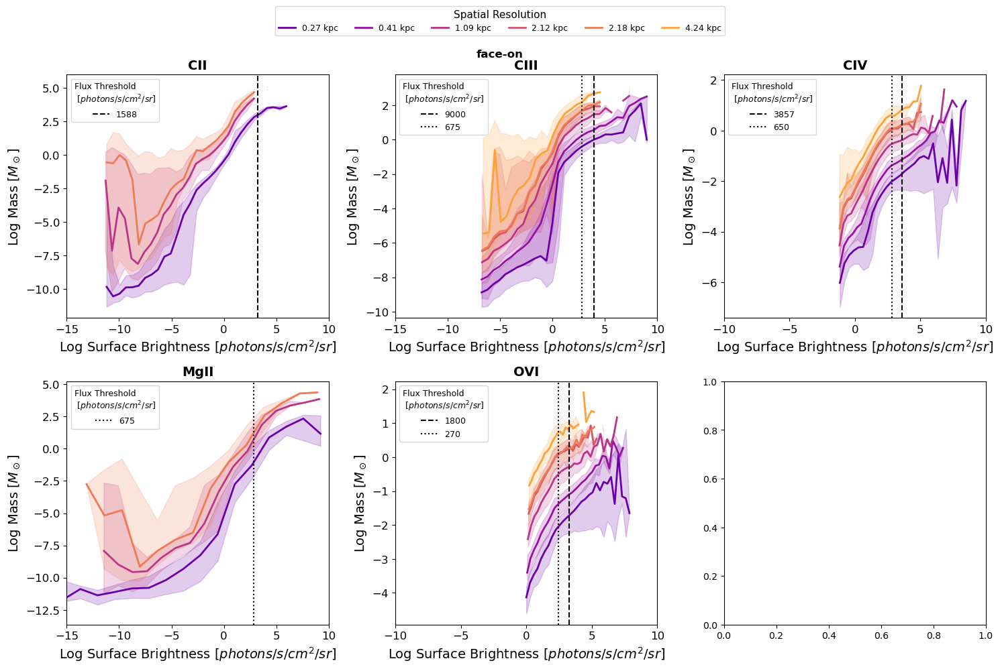

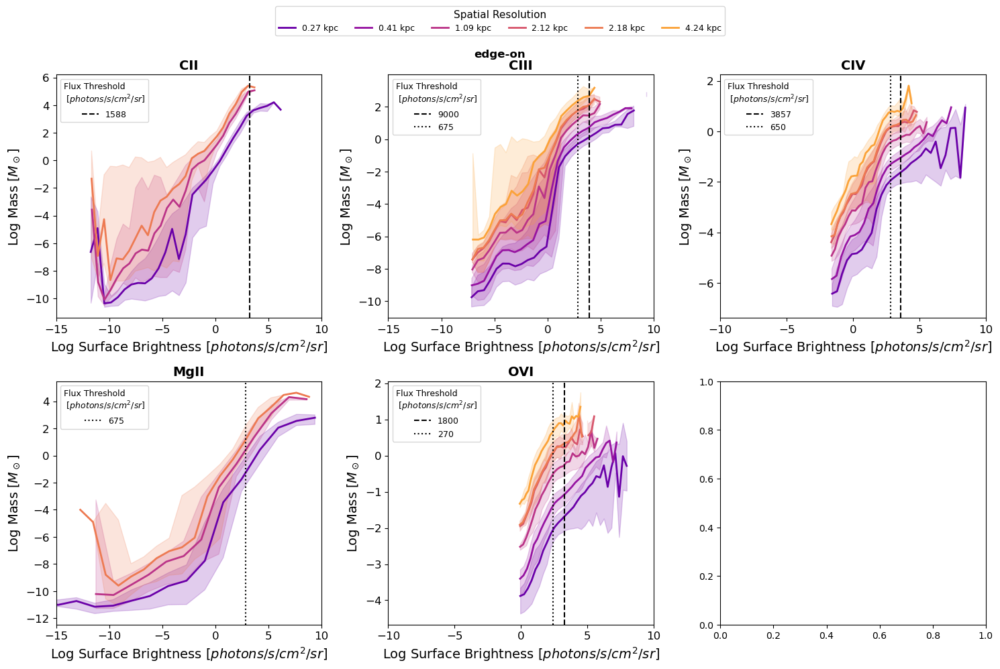

In [ ]:

cmap_res = cmr.get_sub_cmap('plasma', 0.2, 0.9)  # resolution color map
unit_system = 'photons'
all_ions = sorted(set([ion for inst in instrument_list for ion in ions_dict[inst]]))

# Build ion -> {flux_threshold: linestyle} dict
ion_thresholds = {}
for inst in instrument_list:
    th_dict = get_flux_threshold_dict(inst, unit_system)
    for ion, val in th_dict.items():
        if ion not in ion_thresholds:
            ion_thresholds[ion] = {}
        linestyle = '--' if val not in ion_thresholds[ion] else ':'
        ion_thresholds[ion][val] = linestyle

# Loop over orientations
for orientation in orientations:
    num_ions = len(all_ions)
    cols = __builtins__.min(3, num_ions)
    rows = math.ceil(num_ions / cols)
    fig, axes = plt.subplots(rows, cols, figsize=(5 * cols, 5 * rows), squeeze=True)
    plt.suptitle(f"{orientation}-on", fontsize=12, fontweight='bold', y=0.93)

    for ion_index, ion in enumerate(all_ions):
        row, col = divmod(ion_index, cols)
        ax = axes[row][col]

        all_log_emission_by_res = {}
        all_log_mass_by_res = {}
        all_res = []

        for instrument_name in instrument_list:
            if ion not in ions_dict[instrument_name]:
                continue

            for z_index, z in enumerate(target_z_list):
                target_z = str(z)
                for halo in halos:
                    foggie_dir, code_path, snap_name, halo_c_v_name, trackname, output_dir = generate_foggie_paths(halo, run, snap)
                    prefix = os.path.join(output_dir, f'plots_halo_00{halo}', run, instrument_name, output, f'target_z_{target_z}', f'box_{box_name}')
                    save_path = os.path.join(prefix, 'FRBs')
                    halo_name = halo_dict[halo]

                    for region in regions:
                        file_path = os.path.join(save_path, f"{halo_name}_emission_maps.hdf5")
                        try:
                            with h5py.File(file_path, 'r') as f:
                                grp = f['z=0.0']
                                spatial_res = round(float(grp.attrs['FRB_pixel_size_kpc']), 2)
                        except:
                            continue

                        mass_dataset = f"z=0.0/{ion}_mass_{orientation}_{region}"
                        emission_dataset = f"z=0.0/{ion}_emission_{orientation}_{region}"

                        try:
                            with h5py.File(file_path, 'r') as f:
                                if mass_dataset not in f or emission_dataset not in f:
                                    continue
                                mass_data = np.array(f[mass_dataset]).flatten()
                                emission_data = np.array(f[emission_dataset]).flatten()
                        except:
                            continue

                        valid = (emission_data > 1e-40) & (mass_data > 0)
                        if not np.any(valid):
                            continue

                        log_em = np.log10(emission_data[valid])
                        log_mass = np.log10(mass_data[valid])

                        if spatial_res not in all_log_emission_by_res:
                            all_log_emission_by_res[spatial_res] = []
                            all_log_mass_by_res[spatial_res] = []

                        all_log_emission_by_res[spatial_res].append(log_em)
                        all_log_mass_by_res[spatial_res].append(log_mass)

        # Plot combined median + bounds for each resolution
        unique_resolutions = sorted(all_log_emission_by_res.keys())
        for i, res in enumerate(unique_resolutions):
            all_log_em = np.concatenate(all_log_emission_by_res[res])
            all_log_mass = np.concatenate(all_log_mass_by_res[res])

            bins = np.linspace(all_log_em.min(), all_log_em.max(), 30)
            bin_centers = 0.5 * (bins[:-1] + bins[1:])
            median_vals, low_bounds, high_bounds = [], [], []

            for j in range(len(bins) - 1):
                mask = (all_log_em >= bins[j]) & (all_log_em < bins[j+1])
                if np.any(mask):
                    median_vals.append(np.median(all_log_mass[mask]))
                    low_bounds.append(np.percentile(all_log_mass[mask], 16))
                    high_bounds.append(np.percentile(all_log_mass[mask], 84))
                else:
                    median_vals.append(np.nan)
                    low_bounds.append(np.nan)
                    high_bounds.append(np.nan)

            color = cmap_res(i / len(unique_resolutions))
            ax.plot(bin_centers, median_vals, color=color, linestyle='-', lw=2, label=f"{res:.2f} kpc")
            ax.fill_between(bin_centers, low_bounds, high_bounds, color=color, alpha=0.2)

        # Add flux threshold lines
        # Plot vertical lines for flux thresholds and store handles for legend
        flux_handles = []
        for inst in instrument_list:
            inst_flux_dict = get_flux_threshold_dict(inst, unit_system)
            if ion not in inst_flux_dict:
                continue

            sb_thresh = np.log10(inst_flux_dict[ion])
            linestyle = '--' if inst == 'JUNIPER' else ':'
            label = f"{inst_flux_dict[ion]:.0f}"
            
            # Plot the vertical line
            ax.axvline(sb_thresh, color='k', linestyle=linestyle, linewidth=1.5)

            # Prepare legend handle
            handle = Line2D([0], [0], color='k', linestyle=linestyle, linewidth=1.5, label=label)
            flux_handles.append(handle)

        # Add flux threshold legend inside the subplot
        if flux_handles:
            ax.legend(handles=flux_handles, title="Flux Threshold \n [$photons/s/cm^2/sr$]", fontsize=9, title_fontsize=9,
                    loc='upper left', frameon=True)


        # Format
        
        ax.set_xlabel('Log Surface Brightness [$photons/s/cm^2/sr$]', fontsize=14)
        ax.set_ylabel('Log Mass [$M_\odot$]', fontsize=14)
        ax.set_xlim(x_lim_dict.get(ion, [-15, 10]))
        ax.set_title(ion, fontsize=14, fontweight='bold')
        ax.tick_params(axis='both', which='major', labelsize=12)

    plt.tight_layout(rect=[0, 0, 1, 0.96])
    # Unique spatial resolutions & color mapping
    unique_res = sorted(set(spatial_res_list))
    res_handles = []
    for i, res in enumerate(unique_res):
        color = cmap_res(i / len(unique_res))
        handle = Line2D([0], [0], color=color, linestyle='-', linewidth=2, label=f"{res:.2f} kpc")
        res_handles.append(handle)

    # Add spatial resolution legend to the top center of the figure
    fig.legend(res_handles, [h.get_label() for h in res_handles],
            title="Spatial Resolution", title_fontsize=11,
            loc="upper center", bbox_to_anchor=(0.5, 1.0),
            fontsize=9, ncol=len(res_handles), frameon=True)

    plot_dir = os.path.join(output_dir, "allhalos_mass_vs_emission_plots")
    os.makedirs(plot_dir, exist_ok=True)
    plot_filename = f"allhalos_combined_{orientation}_stacked_mass_vs_emission.png"
    plt.savefig(os.path.join(plot_dir, plot_filename))
    plt.show()
    plt.close()

['CII', 'CIII', 'CIV', 'OVI']


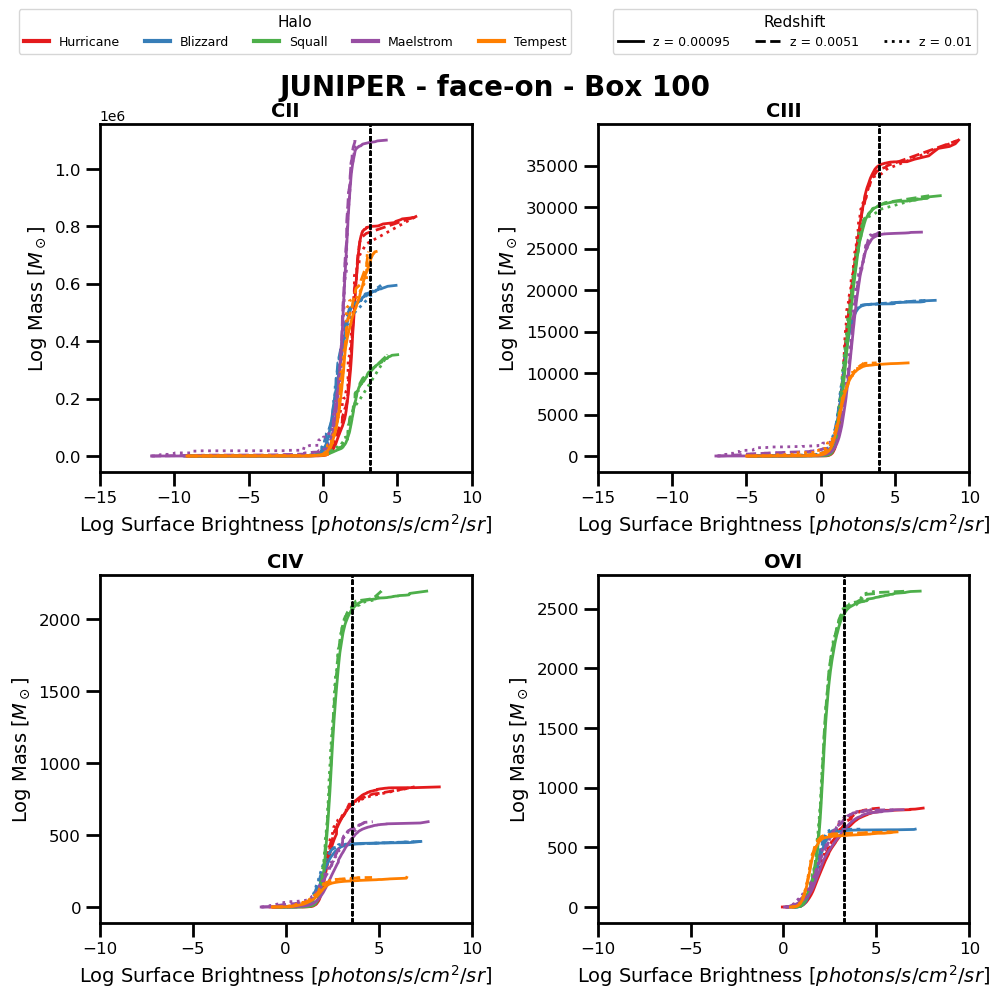

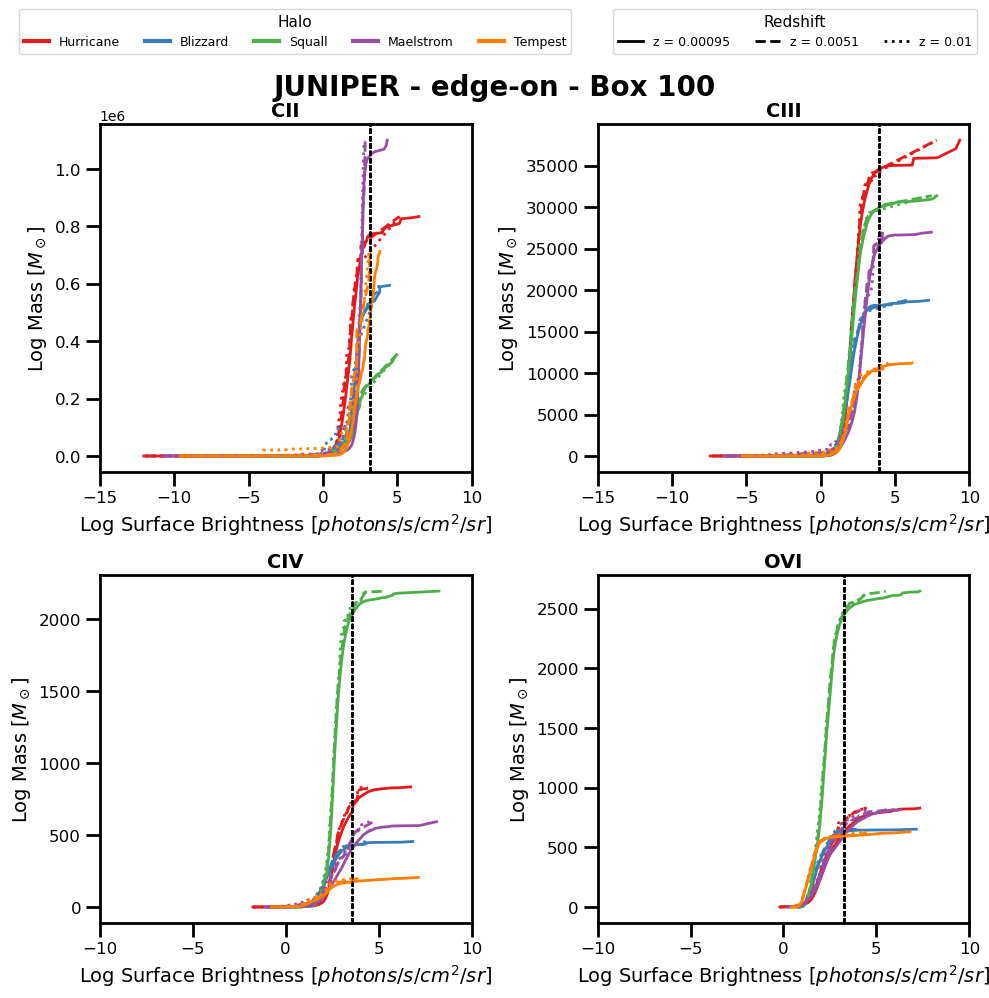

['CIII', 'CIV', 'OVI', 'MgII']


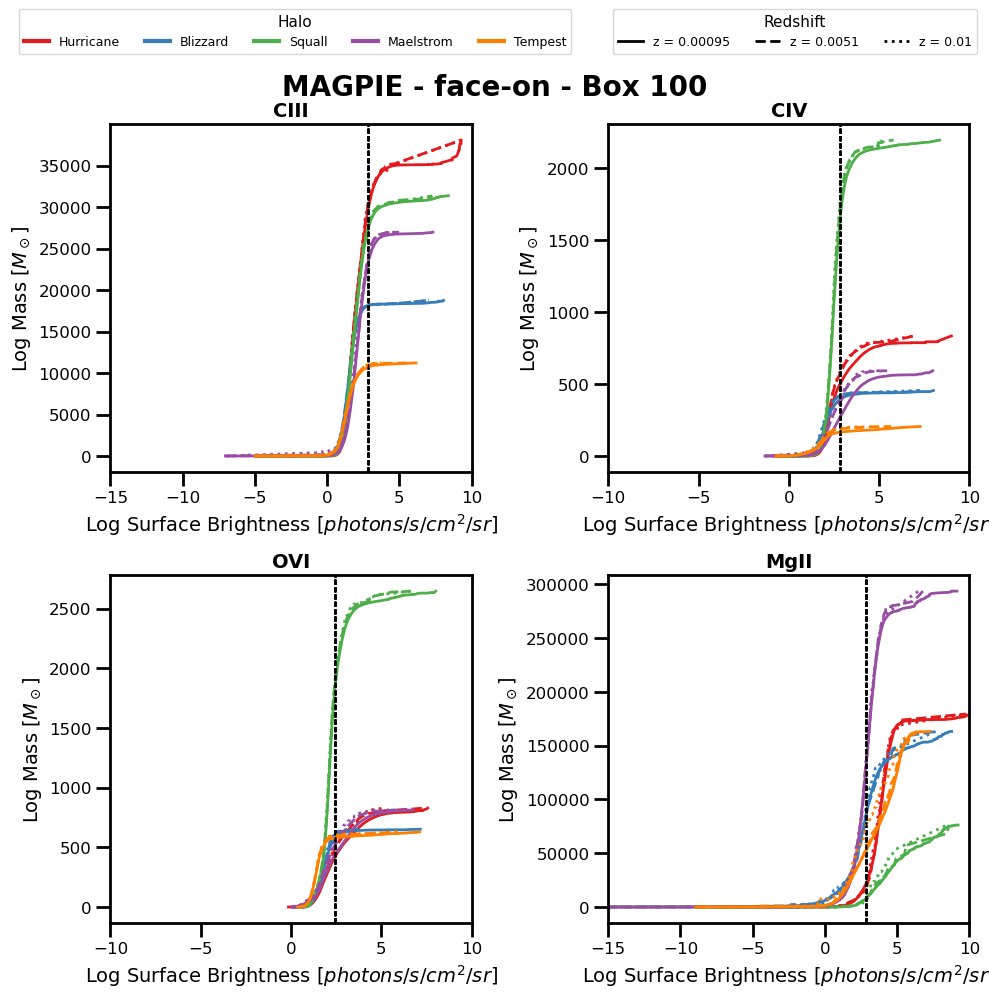

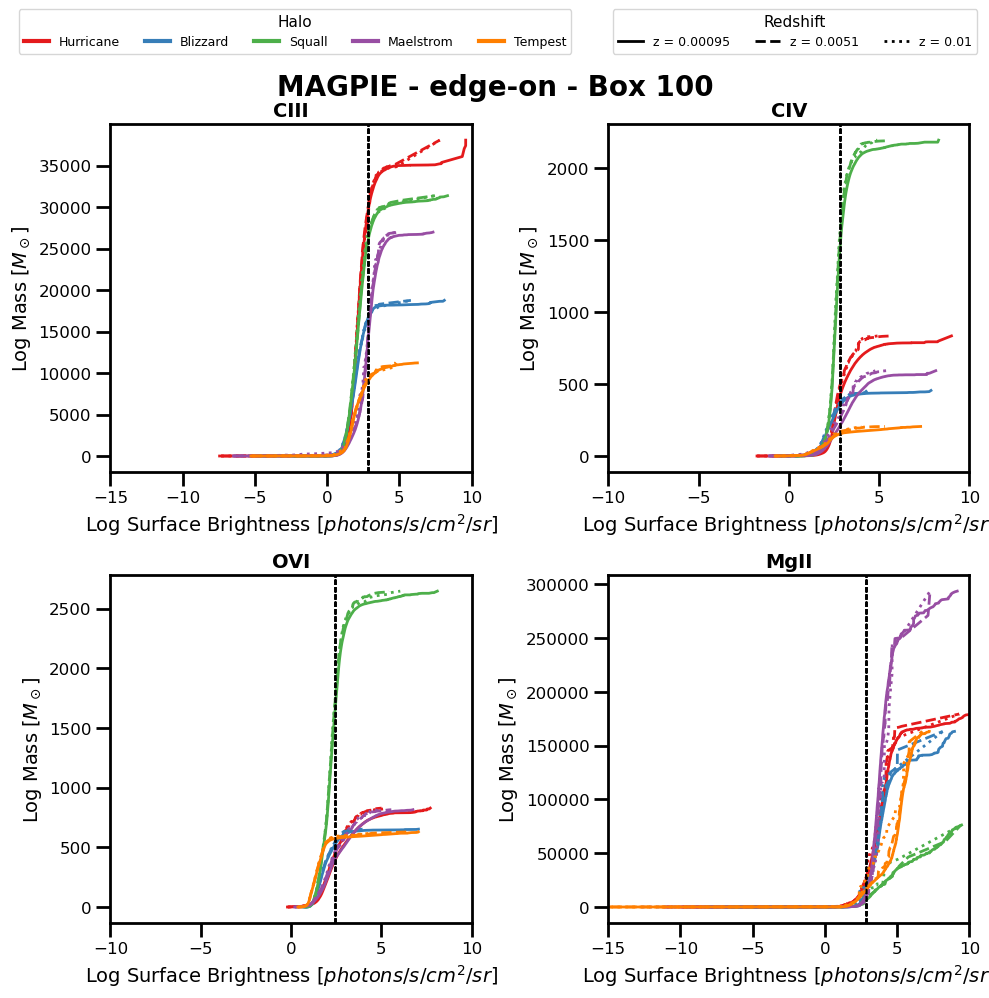

Saved 60 rows to /Users/vidasaeedzadeh/Projects/foggie_outputs/allhalos_mass_vs_emission_plots/mass_fraction_summary_MAGPIE_edge.csv


In [39]:
# Start main plotting loop
def print_group_attrs(file_path, group_path="z=0.0"):
            if not os.path.exists(file_path):
                print(f"File not found: {file_path}")
                return

            with h5py.File(file_path, 'r') as f:
                if group_path in f:
                    grp = f[group_path]
                    print(f"Attributes for group '{group_path}':")
                    for key, val in grp.attrs.items():
                        print(f"  {key}: {val}")
                else:
                    print(f"Group '{group_path}' not found in {file_path}")




for instrument_name in instrument_list:
    flux_threshold_dict = flux_threshold_dict.get(instrument_name, {})
    ions = ions_dict[instrument_name]
    print(ions)
    for orientation in orientations:
        mass_fraction_list = []
        num_ions = len(ions)
        cols = __builtins__.min(2, num_ions)  # Limit to max 3 columns per row
        rows = math.ceil(num_ions / cols)
        fig, axes = plt.subplots(rows, cols, figsize=(5 * cols, 5 * rows), squeeze=False)
        plt.suptitle(f'{instrument_name} - {orientation}-on - Box {box_name}', fontsize=20, fontweight='bold', y = 0.93)

        for halo_index, halo in enumerate(halos):
            for z_index, z in enumerate(target_z_list):
                target_z = str(z)
                line_style = line_styles[z_index]
                foggie_dir, code_path, snap_name, halo_c_v_name, trackname, output_dir = generate_foggie_paths(halo, run, snap)
                prefix = output_dir + 'plots_halo_00'+ halo + '/' + run + '/' + instrument_name + '/' + output + '/' + 'target_z_' + target_z + '/'+ 'box_' + box_name + '/'
                save_path = os.path.join(prefix, 'FRBs/')
                halo_name = halo_dict[halo]
                color = cmap(halo_index)

                for region in regions:
                    for ion_index, ion in enumerate(ions):
                        row, col = divmod(ion_index, cols)
                        ax = axes[row][col]

                        file_path = os.path.join(save_path, f"{halo_name}_emission_maps.hdf5")

                        #print_group_attrs(file_path, group_path="z=0.0")

                        try:
                            with h5py.File(file_path, 'r') as f:
                                grp = f['z=0.0']
                                spatial_res = grp.attrs['FRB_pixel_size_kpc']
                        except Exception as e:
                            print(f"Failed to read pixel size from {file_path}: {e}")
                            continue

                        

                        mass_dataset_name = f"z=0.0/{ion}_mass_{orientation}_{region}"
                        emission_dataset_name = f"z=0.0/{ion}_emission_{orientation}_{region}"

                        
                        try:
                            with h5py.File(file_path, 'r') as f:
                                if mass_dataset_name not in f or emission_dataset_name not in f:
                                    continue

                                mass_data = np.array(f[mass_dataset_name]).flatten()
                                emission_data = np.array(f[emission_dataset_name]).flatten()
                        except Exception as e:
                            print(f"Skipping {file_path} at {z_str} for {ion}: {e}")
                            continue

                        valid = (emission_data > 1e-40) & (mass_data > 0)
                        if not np.any(valid): continue

                        log_emission = np.log10(emission_data[valid])
                        log_mass = np.log10(mass_data[valid])

                        # Sort by surface brightness (log_emission)
                        sorted_idx = np.argsort(log_emission)
                        log_emission_sorted = log_emission[sorted_idx]
                        mass_sorted = mass_data[valid][sorted_idx]

                        # Cumulative mass from high SB to low SB
                        cumulative_mass = np.cumsum(mass_sorted)

                        # Plot cumulative mass vs SB
                        ax.plot(log_emission_sorted, cumulative_mass, label=f'{halo_name} z={z}',
                                color=color, linestyle=line_style, linewidth=2)

                        #ax.fill_between(bin_centers, lower_bounds, upper_bounds, color=color, alpha=0.3)

                        # Surface brightness threshold
                        flux_threshold_dict = get_flux_threshold_dict(instrument_name, unit_system)
                        if ion in flux_threshold_dict:
                            sb_thresh = np.log10(flux_threshold_dict[ion])
                            ax.axvline(sb_thresh, linestyle='--', color='k', linewidth=1)

                            mass_above_thresh = mass_data[valid][log_emission >= sb_thresh].sum()
                            total_mass = mass_data[valid].sum()
                            if total_mass > 0:
                                if total_mass > 0:
                                    frac_mass = (mass_above_thresh / total_mass)*100 # Convert to percentage
                                    #print('target z', z,'ion',ion,'mass frac',frac_mass, 'halo:',halo)
                                    mass_fraction_list.append({
                                                                "instrument": instrument_name,
                                                                "orientation": orientation,
                                                                "halo": halo_name,
                                                                "ion": ion,
                                                                "redshift": z,
                                                                "mass_fraction": frac_mass,
                                                                "spatial_res_kpc": spatial_res  # pulled from the HDF5 group attribute
                                                            })



                        # Format plot
                        ax.set_xlabel('Log Surface Brightness [$photons/s/cm^2/sr$]', fontsize=14)
                        ax.set_ylabel('Log Mass [$M_\\odot$]', fontsize=14)
                        ax.set_xlim(x_lim_dict.get(ion, [-15,10]))
                        ax.set_title(ion, fontsize=14, fontweight='bold')

                        for spine in ax.spines.values():
                            spine.set_linewidth(2)
                            spine.set_color("k")

                        ax.tick_params(axis='both', which='major', labelsize=12, length=10, width=2, color="k")
                        ax.tick_params(axis='both', which='minor', length=5, width=1, color="k")

        # Clean legends
        
        # for ax in axes.flatten():
        #     handles, labels = ax.get_legend_handles_labels()
        #     by_label = dict(zip(labels, handles))
        #     if by_label:
        #         ax.legend(by_label.values(), by_label.keys(), fontsize=10)

        plt.tight_layout(rect=[0, 0, 1, 0.96])
        # Halo color legend
        halo_legend = [Line2D([0], [0], color=cmap(i), lw=3) for i in range(len(halos))]
        halo_labels = [halo_dict[halo] for halo in halos]

        # Redshift linestyle legend
        ls_legend = [Line2D([0], [0], color='k', linestyle=line_styles[i], lw=2) for i in range(len(target_z_list))]
        ls_labels = [f"z = {z}" for z in target_z_list]

        # Add legends once for the whole figure
        fig.legend(halo_legend, halo_labels, title="Halo", loc="upper center", bbox_to_anchor=(0.3, 1.0), ncol=len(halos), fontsize=9, title_fontsize=11)
        fig.legend(ls_legend, ls_labels, title="Redshift", loc="upper center", bbox_to_anchor=(0.8, 1.0), ncol=len(target_z_list), fontsize=9, title_fontsize=11)
        plot_dir = os.path.join(output_dir, "allhalos_mass_vs_emission_plots")
        os.makedirs(plot_dir, exist_ok=True)
        plot_filename = f"allhalos_{instrument_name}_{orientation}_mass_vs_emission_median.png"
        plt.savefig(os.path.join(plot_dir, plot_filename))
        plt.show()
        plt.close()

        # Save after plotting for this orientation
        df_mass_fractions = pd.DataFrame(mass_fraction_list)
        csv_path = os.path.join(plot_dir, f"mass_fraction_summary_{instrument_name}_{orientation}.csv")
        df_mass_fractions.to_csv(csv_path, index=False)

print(f"Saved {len(df_mass_fractions)} rows to {csv_path}")


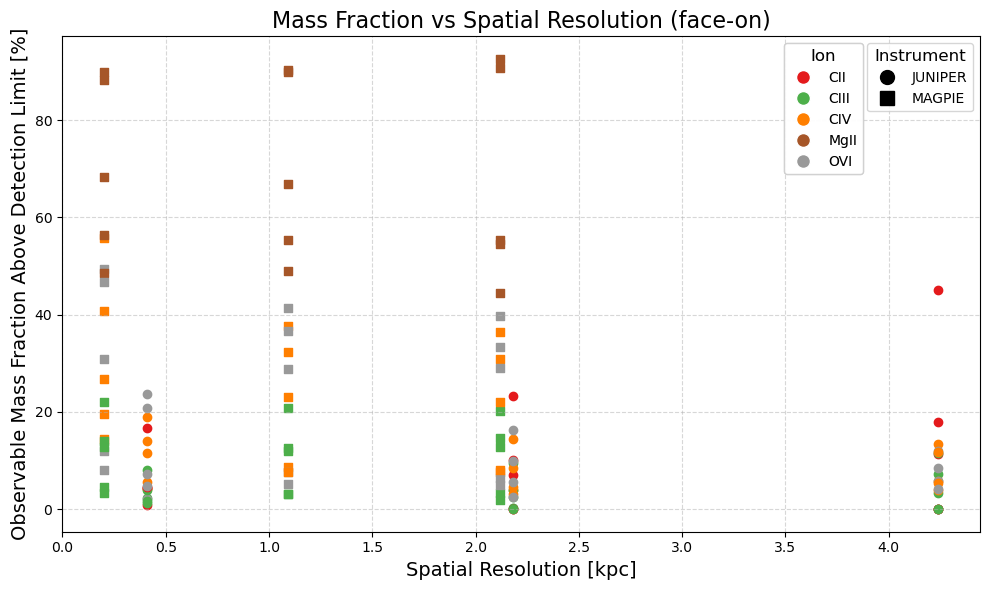

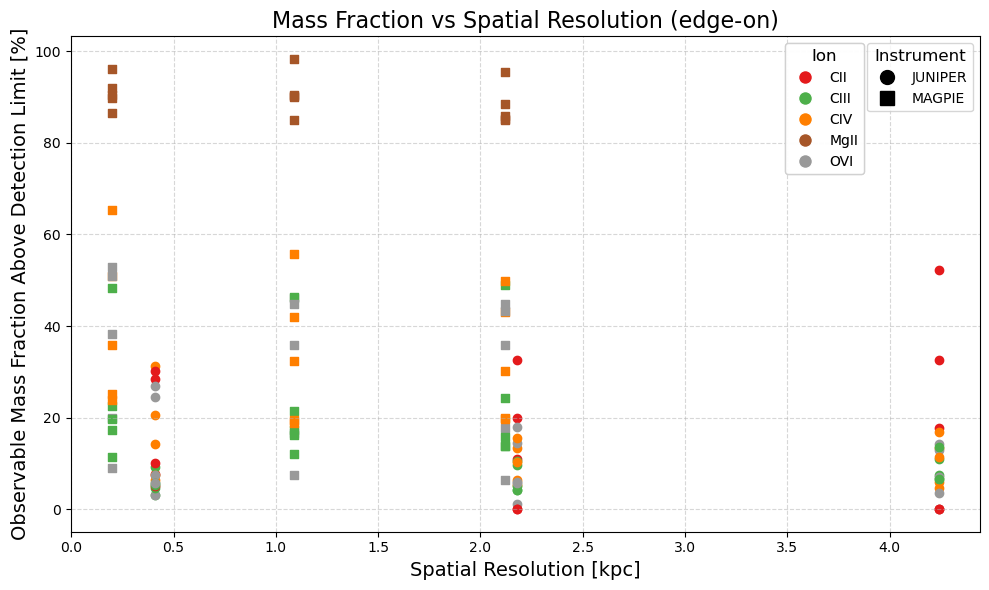

In [31]:
for orientation in orientations:

    fig, ax = plt.subplots(figsize=(10, 6))

    # Read and plot data from CSVs
    all_ions = set()  
    marker_dict = {'JUNIPER': 'o', 'MAGPIE': 's'}

    # First pass: collect all ions across all files
    for instrument in instrument_list:
        
        csv_path = os.path.join(output_dir, "allhalos_mass_vs_emission_plots", 
                                f"mass_fraction_summary_{instrument}_{orientation}.csv")
        if os.path.exists(csv_path):
            df = pd.read_csv(csv_path)
            all_ions.update(df['ion'].unique())  

    # Now convert to sorted list and build colormap
    all_ions = sorted(all_ions)
    ion_colors = plt.cm.Set1(np.linspace(0, 1, len(all_ions)))
    ion_color_map = dict(zip(all_ions, ion_colors))

    # Second pass: plot points
    for instrument in instrument_list:
        
        csv_path = os.path.join(output_dir, "allhalos_mass_vs_emission_plots", 
                                f"mass_fraction_summary_{instrument}_{orientation}.csv")
        if not os.path.exists(csv_path):
            print(f"Missing CSV: {csv_path}")
            continue

        df = pd.read_csv(csv_path)

        for idx, row in df.iterrows():
            ion = row['ion']
            if ion not in ion_color_map:
                continue
            mass_fraction = row['mass_fraction']
            
            spatial_res = row['spatial_res_kpc']
            instr = row['instrument']
            #if ion == 'CII':
                #print(ion,mass_fraction,spatial_res,instr)
            ax.scatter(spatial_res, mass_fraction,
                        color=ion_color_map[ion],
                        marker=marker_dict[instr],
                        label=f"{ion} ({instr})")

    # Build custom legends
    ion_handles = [Line2D([0], [0], marker='o', color='w', label=ion,
                        markerfacecolor=ion_color_map[ion], markersize=10)
                for ion in all_ions]

    instrument_handles = [Line2D([0], [0], marker=marker_dict[inst], color='k', label=inst,
                                linestyle='None', markersize=10)
                        for inst in instrument_list]

    # Plot formatting
    ax.set_xlabel("Spatial Resolution [kpc]", fontsize=14)
    ax.set_ylabel("Observable Mass Fraction Above Detection Limit [%]", fontsize=14)
    ax.set_title(f"Mass Fraction vs Spatial Resolution ({orientation}-on)", fontsize=16)
    ax.grid(True, linestyle='--', alpha=0.5)

    # Add legends
    # Position both legends side-by-side in the upper right
    legend1 = ax.legend(handles=instrument_handles, title="Instrument",
                        loc="upper right", bbox_to_anchor=(1.0, 1.0),
                        fontsize=10, title_fontsize=12)

    legend2 = ax.legend(handles=ion_handles, title="Ion",
                        loc="upper right", bbox_to_anchor=(0.88, 1.0),
                        fontsize=10, title_fontsize=12)

    # Add both legends to the figure
    ax.add_artist(legend1)
    ax.add_artist(legend2)

    plot_dir = os.path.join(output_dir, "allhalos_mass_vs_spatial_res_plots")
    os.makedirs(plot_dir, exist_ok=True)
    plot_filename = f"allhalos_{orientation}_massfrac_vs_spatialres.png"
    plt.savefig(os.path.join(plot_dir, plot_filename))
    plt.tight_layout()
    plt.show()


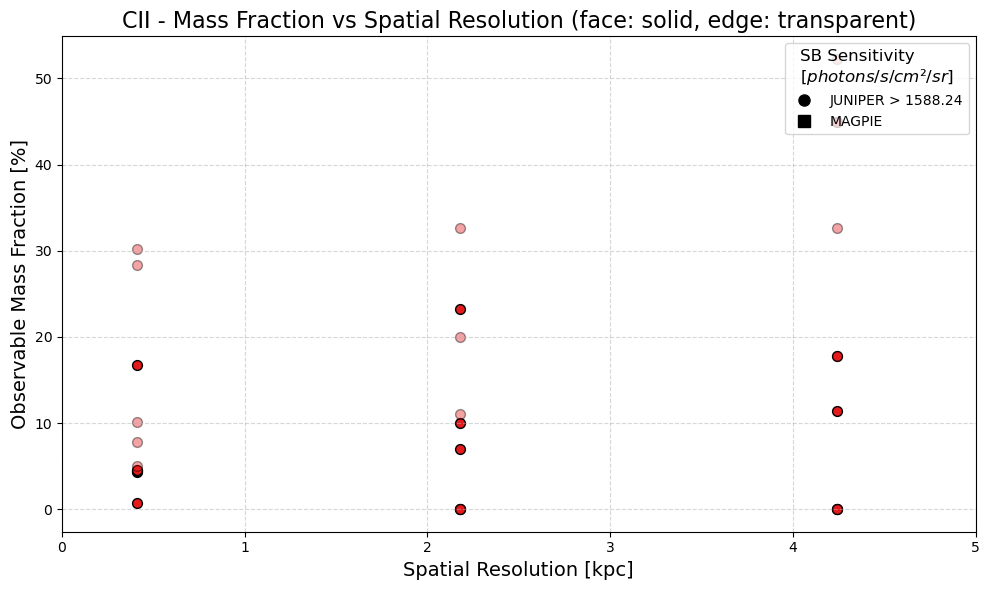

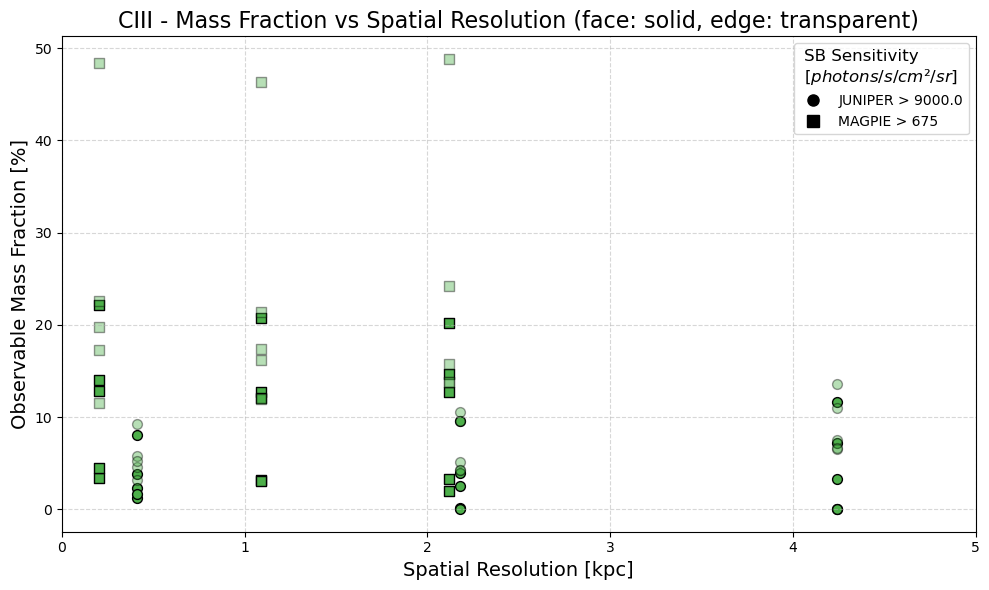

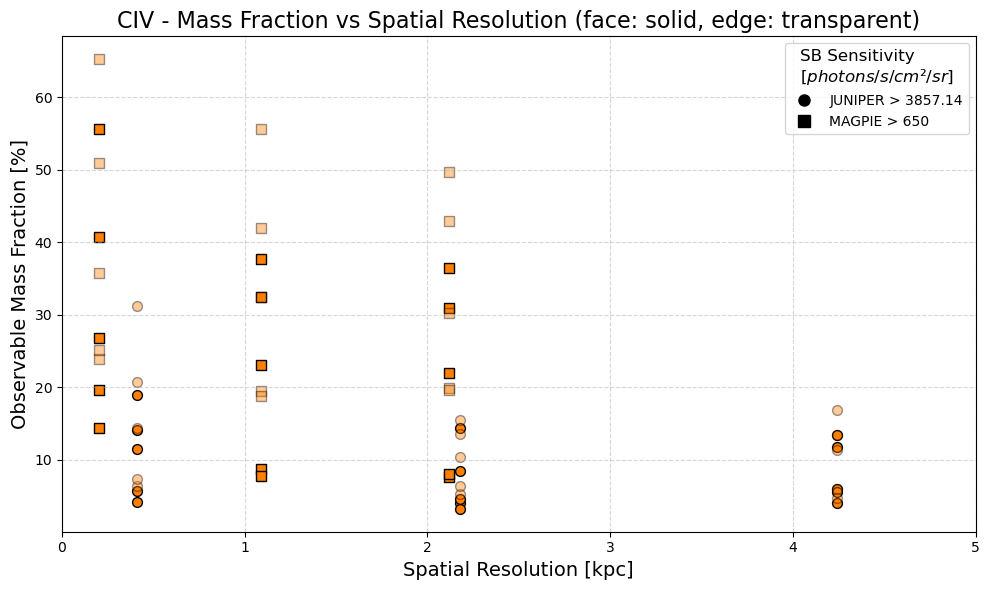

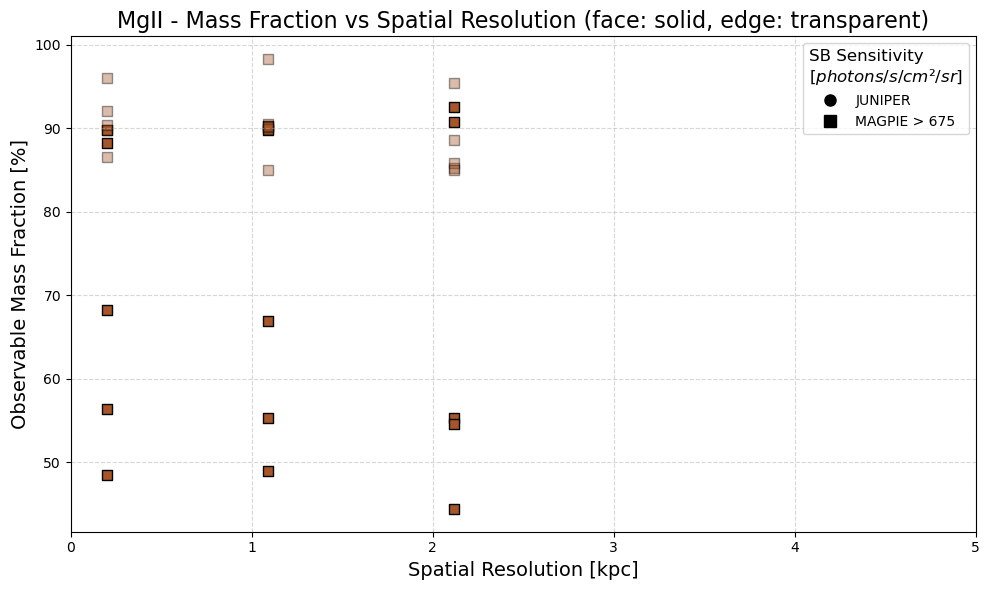

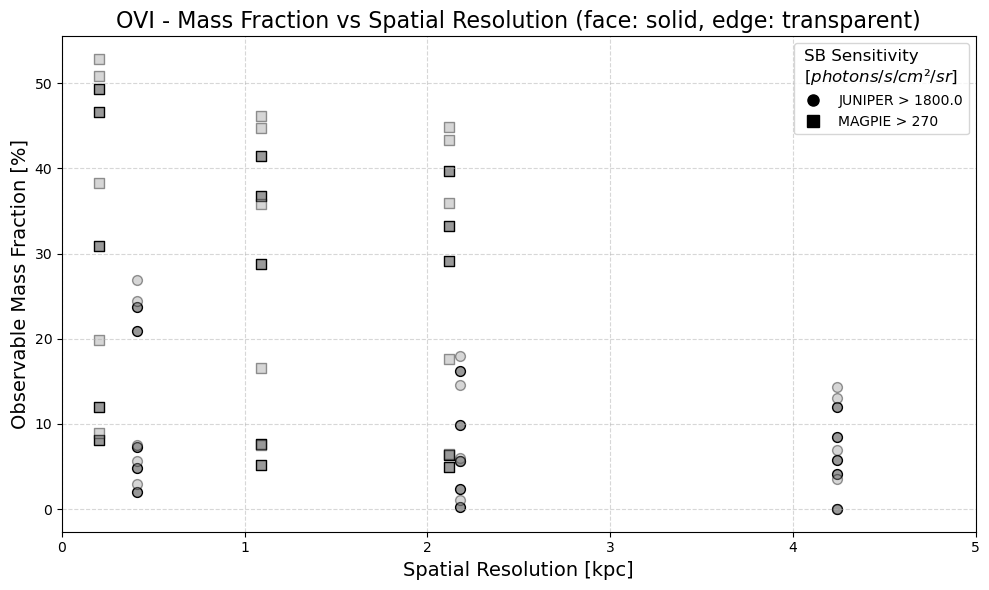

In [35]:
all_ions = set()  
marker_dict = {'JUNIPER': 'o', 'MAGPIE': 's'}

# First pass: collect all ions across all orientations
for orientation in orientations:
    for instrument in instrument_list:
        csv_path = os.path.join(output_dir, "allhalos_mass_vs_emission_plots", 
                                f"mass_fraction_summary_{instrument}_{orientation}.csv")
        if os.path.exists(csv_path):
            df = pd.read_csv(csv_path)
            all_ions.update(df['ion'].unique())  

# Sort and map colors
all_ions = sorted(all_ions)
ion_colors = plt.cm.Set1(np.linspace(0, 1, len(all_ions)))
ion_color_map = dict(zip(all_ions, ion_colors))

# ➤ One figure per ion
for ion_to_plot in all_ions:
    fig, ax = plt.subplots(figsize=(10, 6))

    for orientation in orientations:
        alpha_val = 1.0 if orientation == 'face' else 0.4  # distinguish by transparency

        for instrument in instrument_list:
            csv_path = os.path.join(output_dir, "allhalos_mass_vs_emission_plots", 
                                    f"mass_fraction_summary_{instrument}_{orientation}.csv")
            if not os.path.exists(csv_path):
                print(f"Missing CSV: {csv_path}")
                continue

            df = pd.read_csv(csv_path)
            df_ion = df[df['ion'] == ion_to_plot]

            for _, row in df_ion.iterrows():
                mass_fraction = row['mass_fraction']
                spatial_res = row['spatial_res_kpc']
                instr = row['instrument']
                ax.scatter(spatial_res, mass_fraction,
                           color=ion_color_map[ion_to_plot],
                           marker=marker_dict[instr],
                           alpha=alpha_val,
                           edgecolors='k',
                           s=50)

    # Build instrument legend (with thresholds)
    instrument_handles = []
    for inst in instrument_list:
        flux_threshold_dict = get_flux_threshold_dict(inst, unit_system)
        threshold = flux_threshold_dict.get(ion_to_plot, None)
        label = f"{inst} > {threshold}" if threshold is not None else inst
        handle = Line2D([0], [0], marker=marker_dict[inst], color='k',
                        label=label, linestyle='None', markersize=8)
        instrument_handles.append(handle)

    # Plot formatting
    ax.set_xlabel("Spatial Resolution [kpc]", fontsize=14)
    ax.set_xlim(0,5)
    ax.set_ylabel("Observable Mass Fraction [%]", fontsize=14)
    ax.set_title(f"{ion_to_plot} - Mass Fraction vs Spatial Resolution (face: solid, edge: transparent)", fontsize=16)
    ax.grid(True, linestyle='--', alpha=0.5)

    ax.legend(handles=instrument_handles, title="SB Sensitivity \n[$photons/s/cm²/sr$]", loc="upper right", fontsize=10, title_fontsize=12)

    plot_dir = os.path.join(output_dir, "allhalos_mass_vs_spatial_res_plots")
    os.makedirs(plot_dir, exist_ok=True)
    plot_filename = f"allhalos_{ion_to_plot}_massfrac_vs_spatialres.png"
    plt.savefig(os.path.join(plot_dir, plot_filename))

    plt.tight_layout()
    plt.show()


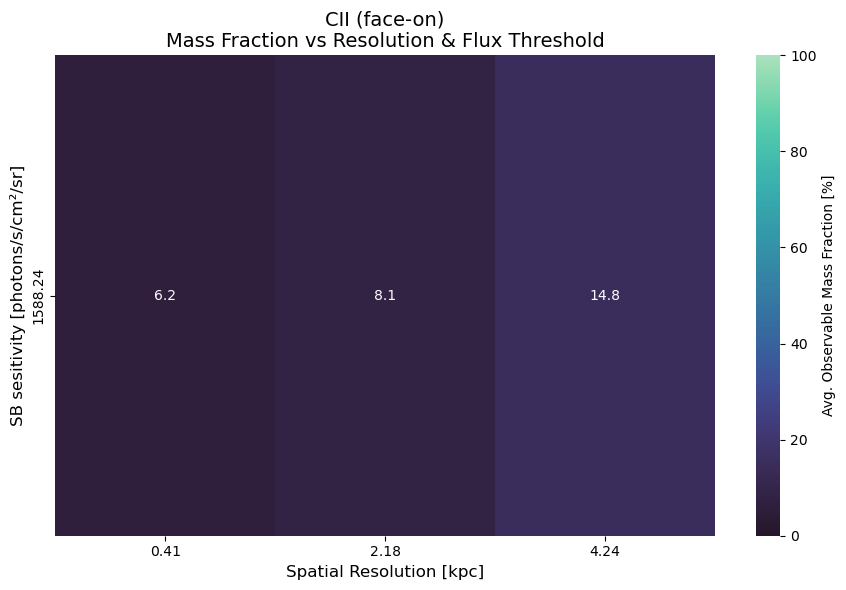

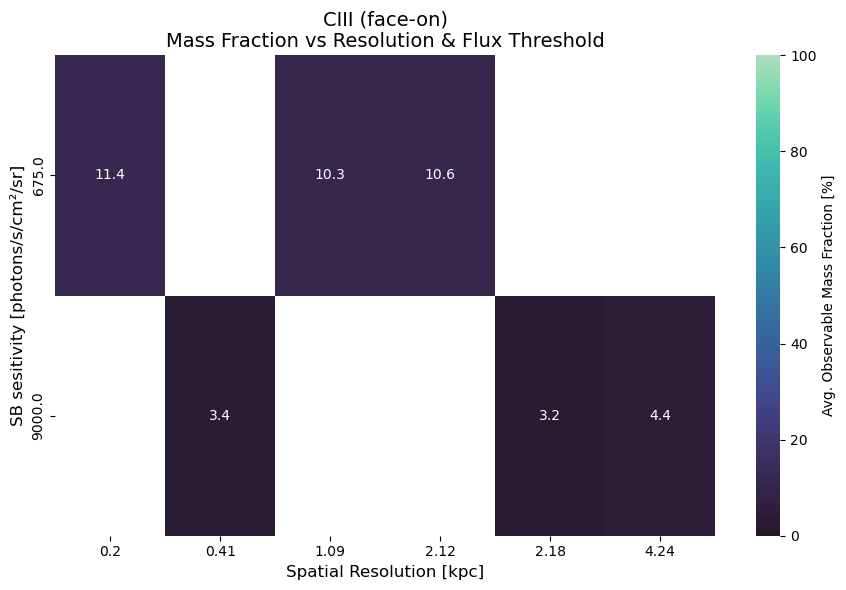

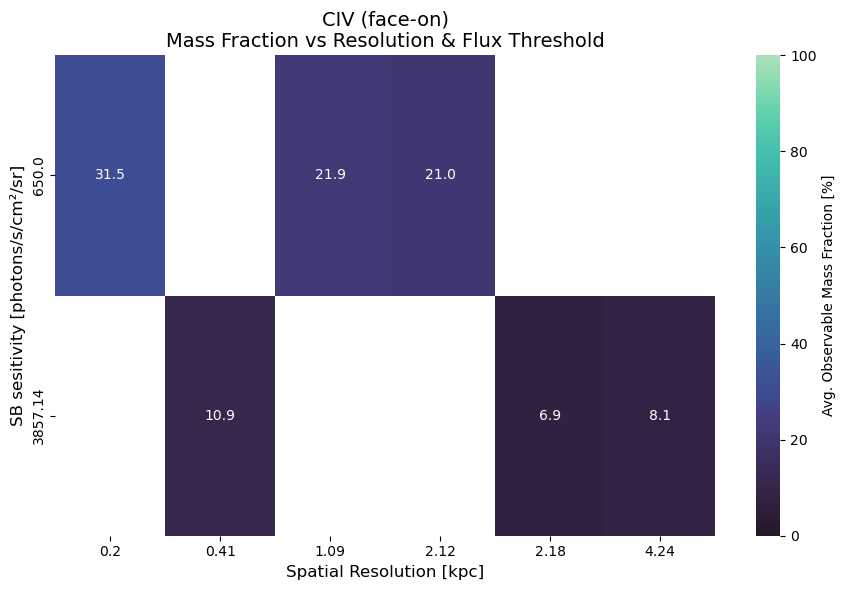

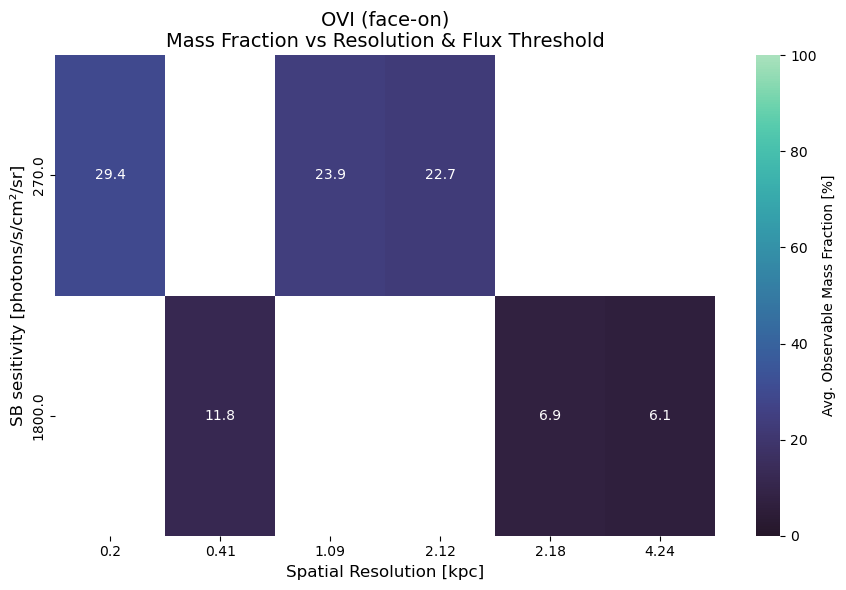

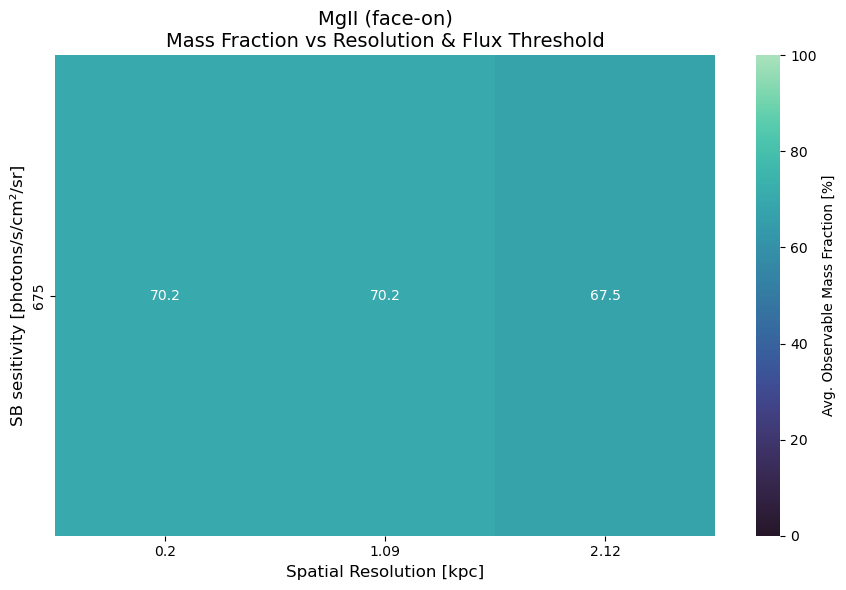

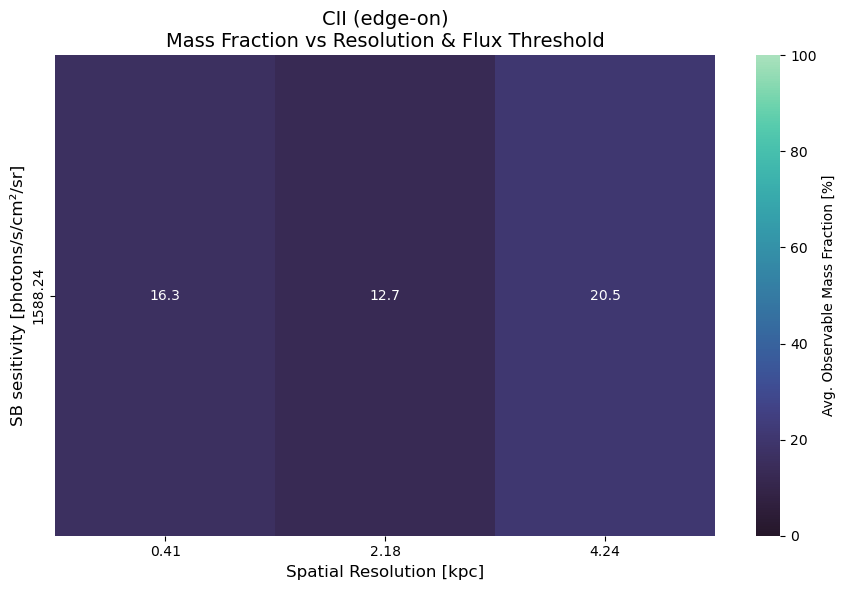

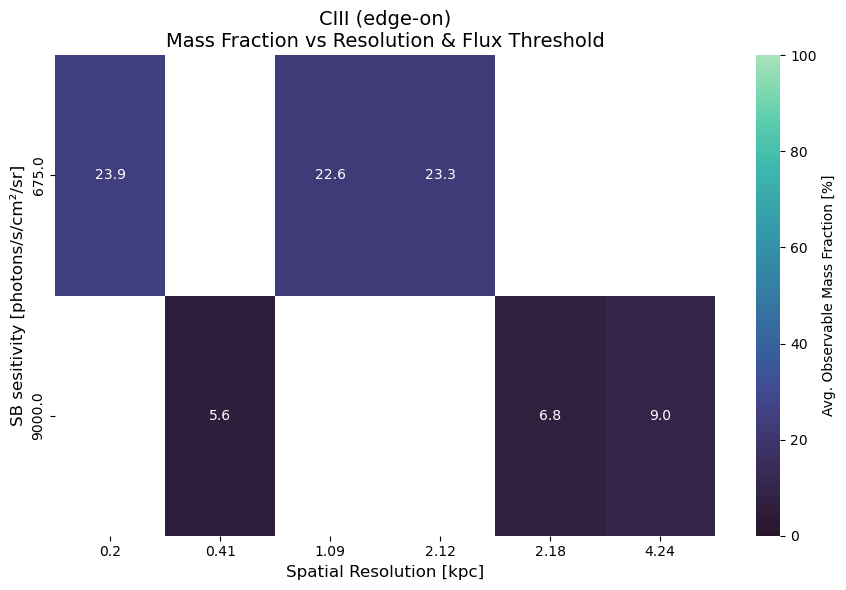

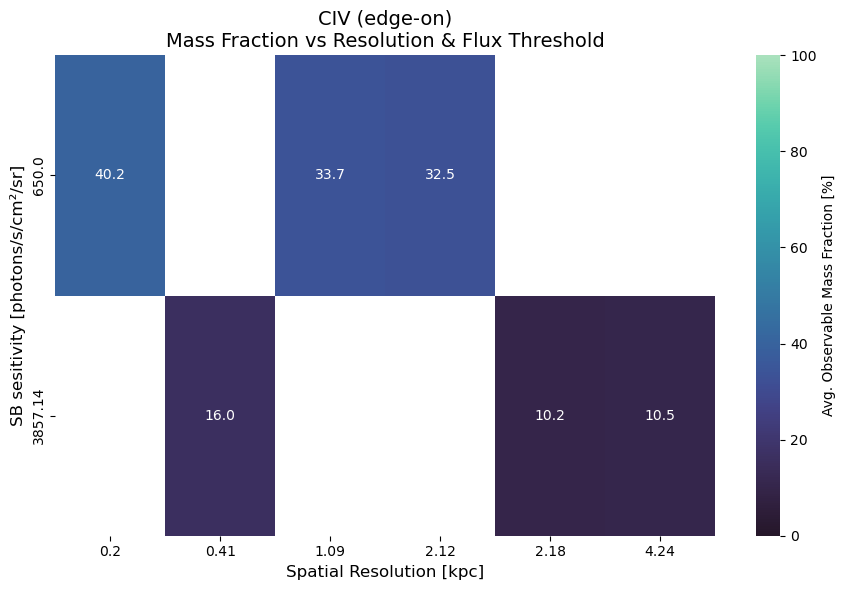

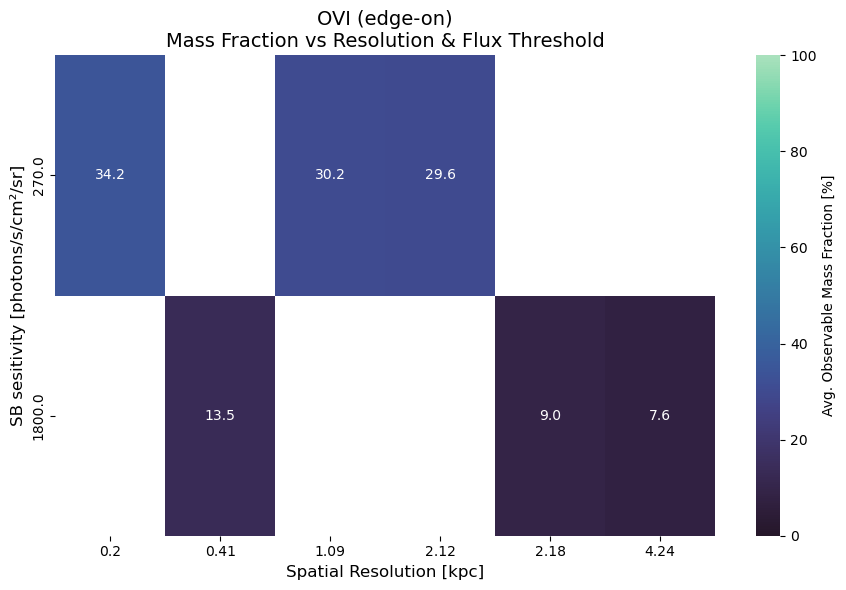

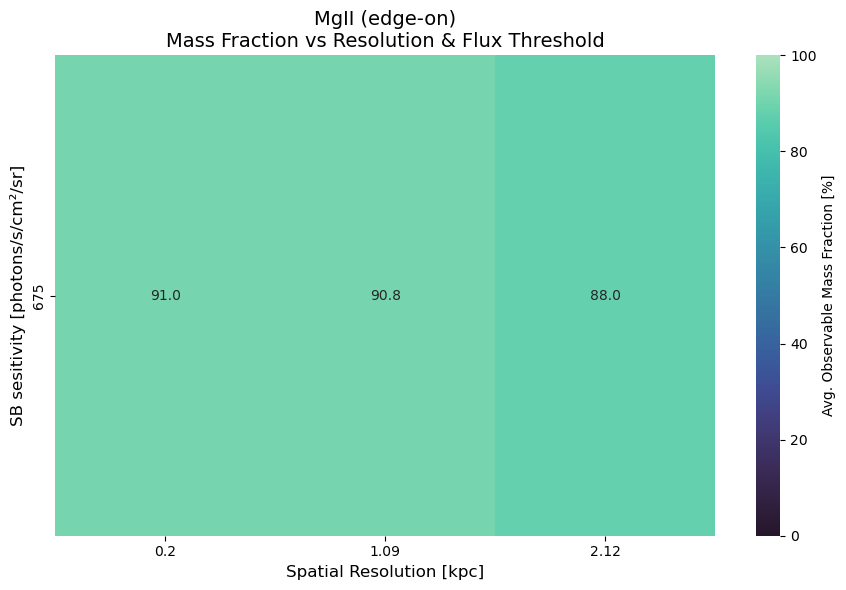

In [37]:


unit_system = 'photons'
ion_list = ['CII', 'CIII', 'CIV', 'OVI', 'MgII']

# Start loop over ions
for orientation in orientations:
    for ion in ion_list:
        all_records = []

        for instrument in instrument_list:
            # Get flux threshold
            flux_threshold_dict = get_flux_threshold_dict(instrument, unit_system)
            if ion not in flux_threshold_dict:
                continue  # skip if this instrument doesn't support this ion

            flux_thresh = flux_threshold_dict[ion]

            # Load CSV
            csv_path = os.path.join(output_dir, "allhalos_mass_vs_emission_plots",
                                    f"mass_fraction_summary_{instrument}_{orientation}.csv")
            if not os.path.exists(csv_path):
                continue

            df = pd.read_csv(csv_path)
            df = df[df['ion'] == ion]

            # Add flux threshold column
            df['flux_threshold'] = flux_thresh
            df['instrument'] = instrument
            all_records.append(df)

        # Combine all instruments for this ion
        if len(all_records) == 0:
            print(f"Skipping {ion} — no data available.")
            continue

        df_all = pd.concat(all_records, ignore_index=True)

        # Group by (flux threshold, spatial resolution) and average over halos
        pivot_df = df_all.groupby(['flux_threshold', 'spatial_res_kpc'])['mass_fraction'].mean().reset_index()
        pivot_table = pivot_df.pivot(index='flux_threshold', columns='spatial_res_kpc', values='mass_fraction')

        # Sort for cleaner axes
        pivot_table = pivot_table.sort_index(axis=0)  # by flux threshold
        pivot_table = pivot_table.sort_index(axis=1)  # by resolution

        # Plot heatmap
        fig, ax = plt.subplots(figsize=(9, 6))
        sns.heatmap(
                    pivot_table,
                    cmap = cmr.get_sub_cmap('mako', 0.1, 0.9), #'mako',
                    vmin=0,             
                    vmax=100,          
                    cbar_kws={'label': 'Avg. Observable Mass Fraction [%]'},
                    annot=True,
                    fmt=".1f",
                    ax=ax
                )

        ax.set_xlabel("Spatial Resolution [kpc]", fontsize=12)
        ax.set_ylabel("SB sesitivity [photons/s/cm²/sr]", fontsize=12)
        ax.set_title(f"{ion} ({orientation}-on)\nMass Fraction vs Resolution & Flux Threshold", fontsize=14)

        plot_dir = os.path.join(output_dir, "allhalos_mass_vs_spatial_res_plots")
        os.makedirs(plot_dir, exist_ok=True)
        plot_filename = f"allhalos_Heatmap_{ion}_{orientation}_fluxlimit_vs_spatialres.png"
        plt.savefig(os.path.join(plot_dir, plot_filename))

        plt.tight_layout()
        plt.show()


In [32]:
# Define your custom flux thresholds per ion (photons/s/cm^2/sr)
# flux_thresholds = {
#     'CII': [1000, 1588],
#     'CIII': [500, 9000],
#     'CIV': [650, 3857],
#     'OVI': [270, 1800],
#     'MgII': [675],
# }

# flux_thresholds = {
#     'CII': list(range(10, 4001, 100)),
#     'CIII': list(range(10, 4001, 100)),
#     'CIV': list(range(10, 4001, 100)),
#     'OVI': list(range(10, 4001, 100)),
#     'MgII': list(range(10, 4001, 100)),
# }


log_vals = np.logspace(np.log10(10), np.log10(1e5), num=128).astype(int)

flux_thresholds = {
    'CII': list(log_vals),
    'CIII': list(log_vals),
    'CIV': list(log_vals),
    'OVI': list(log_vals),
    'MgII': list(log_vals),
}


output_data = []

for orientation in orientations:
    for halo in halos:
        for z in target_z_list:
            target_z = str(z)
            foggie_dir, code_path, snap_name, halo_c_v_name, trackname, output_dir = generate_foggie_paths(halo, run, snap)
            halo_name = halo_dict[halo]

            for instrument_name in instrument_list:
                ions = ions_dict[instrument_name]

                prefix = os.path.join(output_dir, f"plots_halo_00{halo}", run, instrument_name, output, f"target_z_{target_z}", f"box_{box_name}")
                save_path = os.path.join(prefix, 'FRBs')
                file_path = os.path.join(save_path, f"{halo_name}_emission_maps.hdf5")

                try:
                    with h5py.File(file_path, 'r') as f:
                        spatial_res = f['z=0.0'].attrs['FRB_pixel_size_kpc']
                except:
                    continue

                for region in regions:
                    for ion in ions:
                        if ion not in flux_thresholds:
                            continue

                        try:
                            with h5py.File(file_path, 'r') as f:
                                mass_data = np.array(f[f'z=0.0/{ion}_mass_{orientation}_{region}']).flatten()
                                emission_data = np.array(f[f'z=0.0/{ion}_emission_{orientation}_{region}']).flatten()
                        except:
                            continue

                        valid = (emission_data > 1e-40) & (mass_data > 0)
                        if not np.any(valid):
                            continue

                        emission_valid = emission_data[valid]
                        mass_valid = mass_data[valid]
                        total_mass = mass_valid.sum()

                        for thresh in flux_thresholds[ion]:
                            mass_above = mass_valid[emission_valid >= thresh].sum()
                            frac = (mass_above / total_mass) * 100 if total_mass > 0 else np.nan

                            output_data.append({
                                'halo': halo_name,
                                'ion': ion,
                                'orientation': orientation,
                                'redshift': z,
                                'spatial_res_kpc': spatial_res,
                                'flux_threshold': thresh,
                                'mass_fraction': frac
                            })

# Save to CSV
df = pd.DataFrame(output_data)
out_dir = os.path.join(output_dir, "allhalos_mass_fraction_summary")
os.makedirs(out_dir, exist_ok=True)
out_path = os.path.join(out_dir, "mass_fraction_by_threshold.csv")
df.to_csv(out_path, index=False)
print(f"Saved {len(df)} rows to {out_path}")


Saved 30720 rows to /Users/vidasaeedzadeh/Projects/foggie_outputs/allhalos_mass_fraction_summary/mass_fraction_by_threshold.csv


In [5]:
ion_list = ['CII', 'CIII', 'CIV', 'OVI', 'MgII']
unit_system = 'photons'

# Path to the unified mass fraction CSV
csv_path = os.path.join(output_dir, "allhalos_mass_fraction_summary", "mass_fraction_by_threshold.csv")
df_all = pd.read_csv(csv_path)

# Loop over orientations and ions
for orientation in orientations:
    df_orientation = df_all[df_all['orientation'] == orientation]

    for ion in ion_list:
        df_ion = df_orientation[df_orientation['ion'] == ion]
        if df_ion.empty:
            print(f"Skipping {ion} ({orientation}) — no data available.")
            continue

        # Group and pivot for heatmap
        pivot_df = df_ion.groupby(['flux_threshold', 'spatial_res_kpc'])['mass_fraction'].mean().reset_index()
        pivot_table = pivot_df.pivot(index='flux_threshold', columns='spatial_res_kpc', values='mass_fraction')
        pivot_table = pivot_table.sort_index(axis=0)
        pivot_table = pivot_table.sort_index(axis=1)

        # Plot
        fig, ax = plt.subplots(figsize=(9, 6))
        sns.heatmap(
            pivot_table,
            cmap=cmr.get_sub_cmap('mako', 0.05, 1),#mako
            vmin=0,
            vmax=100,
            cbar_kws={'label': 'Avg. Observable Mass Fraction [%]'},
            annot=False,
            fmt=".1f",
            ax=ax
        )

        # Update x-axis tick labels
        xticks = pivot_table.columns
        xtick_labels = [f"{0.27:.2f}" if abs(x - 0.27) < 1e-1 else f"{x:.2f}" for x in xticks]
        ax.set_xticks(np.arange(len(xticks)) + 0.5)
        ax.set_xticklabels(xtick_labels, rotation=45, ha='right')

        # Annotate only rows where flux threshold is a multiple of 1000
        # for i, flux in enumerate(pivot_table.index):
        #     if flux % 54 != 0:
        #         continue
        #     for j, res in enumerate(pivot_table.columns):
        #         val = pivot_table.loc[flux, res]
        #         if not np.isnan(val):
        #             ax.text(j + 0.5, i + 0.5, f"{val:.1f}", ha='center', va='center', color='w', fontsize=8)



        ax.set_xlabel("Spatial Resolution [kpc]", fontsize=12)
        ax.set_ylabel("Surface Brightness Sensitivity [photons/s/cm²/sr]", fontsize=12)
        ax.set_title(f"{ion} ({orientation}-on)", fontsize=10)
        
        # Save
        plot_dir = os.path.join(output_dir, "allhalos_mass_vs_spatial_res_plots")
        os.makedirs(plot_dir, exist_ok=True)
        plot_filename = f"allhalos_Heatmap_{ion}_{orientation}_fluxlimit_vs_spatialres.png"
        plt.savefig(os.path.join(plot_dir, plot_filename))

        plt.tight_layout()
        plt.show()


NameError: name 'os' is not defined

In [8]:
6.37*24


152.88

<>:65: SyntaxWarning: invalid escape sequence '\o'
<>:65: SyntaxWarning: invalid escape sequence '\o'
/var/folders/03/8m_yf9p11xd_2mlw7w_4dw4w0000gn/T/ipykernel_35444/2766618746.py:65: SyntaxWarning: invalid escape sequence '\o'
  ax.set_ylabel('Log Mass [$M_{\odot}$]', fontsize=16)


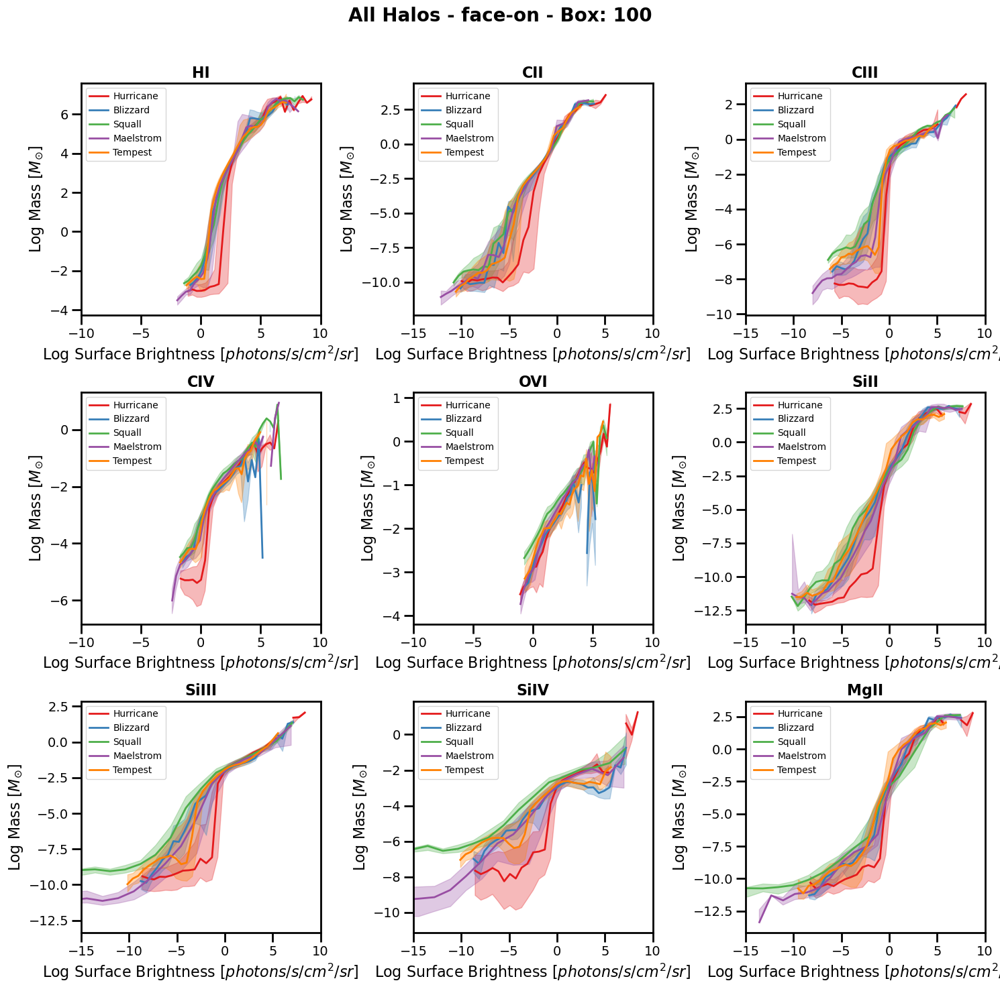

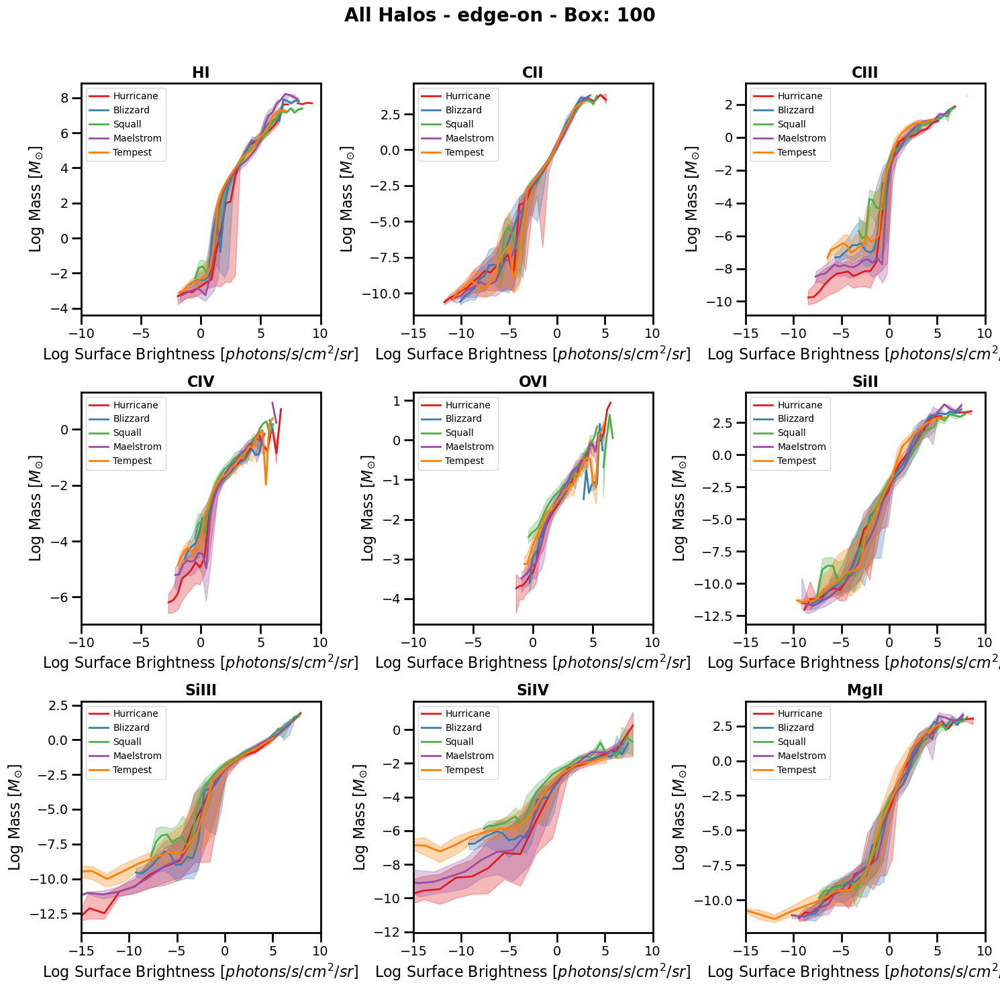

In [68]:
for orientation in orientations:
    num_ions = len(ions)
    cols = __builtins__.min(3, num_ions)  # Limit to max 3 columns per row
    rows = math.ceil(num_ions / cols)  # Compute required rows
    fig, axes = plt.subplots(rows, cols, figsize=(5 * cols, 5 * rows), squeeze=False)
    plt.suptitle(f'All Halos - {orientation}-on - Box: {box_name}', fontsize=20, fontweight='bold')
    
    for halo_index, halo in enumerate(halos):
        foggie_dir, code_path, snap_name, halo_c_v_name, trackname, output_dir = generate_foggie_paths(halo, run, snap)
        snap_name = foggie_dir + snap + '/' + snap
        prefix = output_dir + f'plots_halo_00{halo}/{run}/res_{resolution}/box_{box_name}/'
        
        halo_name = halo_dict[halo]
        color = cmap(halo_index) 
        
        for region in regions:
            for index, ion in enumerate(ions):
                row, col = divmod(index, cols)
                ax = axes[row, col]  # Select corresponding subplot
                
                save_path = prefix + 'FRBs/'
                file_path = os.path.join(save_path, f"{halo_name}_emission_maps.hdf5")
                
                mass_dataset_name = f"z=0.0/{ion}_mass_{orientation}_{region}"
                emission_dataset_name = f"z=0.0/{ion}_emission_{orientation}_{region}"
                
                with h5py.File(file_path, 'r') as f:
                    mass_data = np.array(f[mass_dataset_name]).flatten()
                    emission_data = np.array(f[emission_dataset_name]).flatten()
                    
                    valid_indices = (emission_data > 1e-40) & (mass_data > 0)
                    emission_data = emission_data[valid_indices]
                    mass_data = mass_data[valid_indices]
                    
                    # Log scale transformation
                    log_emission = np.log10(emission_data)
                    log_mass = np.log10(mass_data)
                    
                    # Compute median and spread
                    bins = np.linspace(log_emission.min(), log_emission.max(), 30)
                    bin_centers = 0.5 * (bins[:-1] + bins[1:])
                    median_values = []
                    lower_bounds = []
                    upper_bounds = []
                    
                    for j in range(len(bins) - 1):
                        bin_mask = (log_emission >= bins[j]) & (log_emission < bins[j+1])
                        if np.any(bin_mask):
                            median_values.append(np.median(log_mass[bin_mask]))
                            lower_bounds.append(np.percentile(log_mass[bin_mask], 25))
                            upper_bounds.append(np.percentile(log_mass[bin_mask], 75))
                        else:
                            median_values.append(np.nan)
                            lower_bounds.append(np.nan)
                            upper_bounds.append(np.nan)
                    
                    median_values = np.array(median_values)
                    lower_bounds = np.array(lower_bounds)
                    upper_bounds = np.array(upper_bounds)
                    
                    ax.plot(bin_centers, median_values, color=color, linewidth=2, label=halo_name)
                    ax.fill_between(bin_centers, lower_bounds, upper_bounds, color=color, alpha=0.3)
                
                ax.set_xlabel('Log Surface Brightness [$photons/s/cm^2/sr$]', fontsize=16)
                ax.set_ylabel('Log Mass [$M_{\odot}$]', fontsize=16)
                ax.set_xlim(x_lim_dict[ion][0], x_lim_dict[ion][1])
                ax.set_title(f'{ion}', fontsize=16, fontweight='bold')
                
                # Formatting axes
                for spine in ax.spines.values():
                    spine.set_linewidth(2)
                    spine.set_color("k")
                
                ax.tick_params(axis='both', which='major', labelsize=14, length=10, width=2, color="k", labelcolor="k", direction="out", top=False, right=False)
                ax.tick_params(axis='both', which='minor', labelsize=14, length=5, width=1, color="k", labelcolor="k", direction="out", top=False, right=False)
                
                ax.legend(loc='upper left', fontsize=10, handletextpad=0.5)
    
    plt.tight_layout(rect=[0, 0, 1, 0.96])  # Leaves space for suptitle
    
    # Save the figure
    plot_dir = os.path.join(output_dir, "allhalos_mass_vs_emission_plots")
    os.makedirs(plot_dir, exist_ok=True)
    plt.savefig(os.path.join(plot_dir, f"allhalos_{orientation}_mass_vs_emission_median.png"))
    plt.show()
    plt.close()


orientation face
region all
orientation face
region all
orientation face
region all
orientation face
region all
orientation face
region all


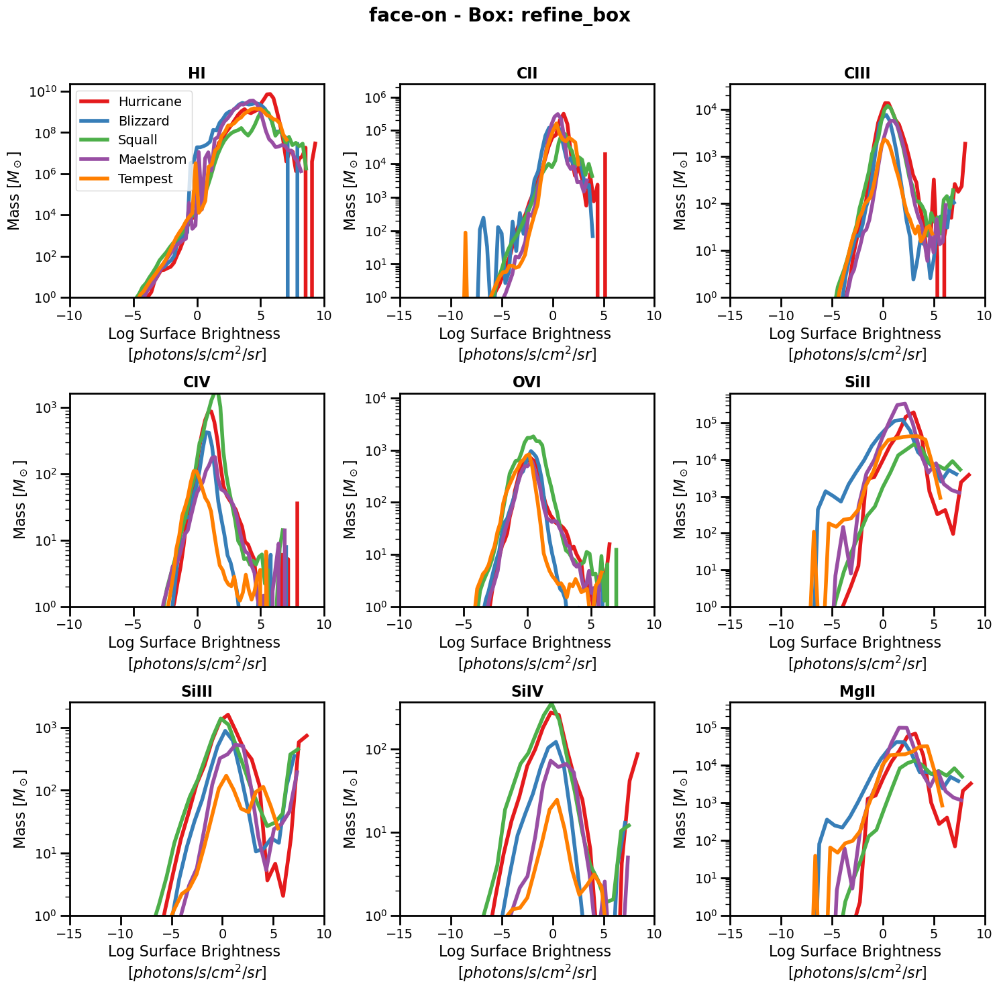

orientation edge
region all
orientation edge
region all
orientation edge
region all
orientation edge
region all
orientation edge
region all


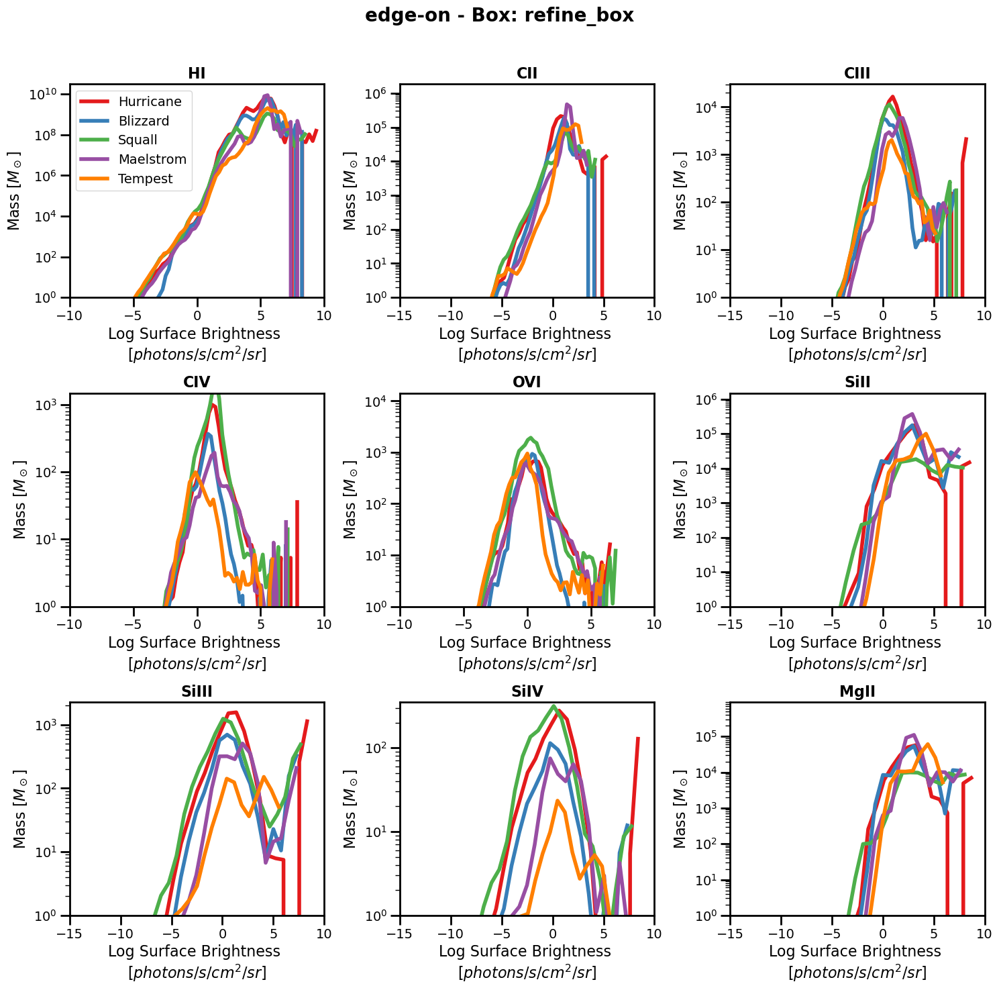

In [9]:
for orientation in orientations:
    
    detectable_ions = ions  
    num_ions = len(detectable_ions)
    cols = __builtins__.min(3, num_ions)  # Limit to max 3 columns per row 
    rows = math.ceil(num_ions / cols)  # Compute required rows
    fig, axes = plt.subplots(rows, cols, figsize=(5 * cols, 5 * rows), squeeze=False)

    i = -1
    for halo in halos:
        foggie_dir,code_path, snap_name, halo_c_v_name, trackname, output_dir = generate_foggie_paths(halo, run, snap)
        snap_name = foggie_dir + snap + '/' + snap

        prefix = output_dir + 'plots_halo_00' + halo + '/' + run + '/' + 'res_' + resolution + '/' + 'box_' + box_name + '/'

        i += 1
        print('orientation', orientation)
        
        for region in regions:
            print('region', region)
            
            
            halo_name = halo_dict[halo]
            
            
            # Set a single title for the whole figure
            plt.suptitle(f'{orientation}-on - Box: {box_name}', fontsize=20, fontweight='bold')

            for index, ion in enumerate(detectable_ions):
                row, col = divmod(index, cols)
                ax = axes[row, col]  # Select corresponding subplot
                
                color = cmap(i)  
                save_path = prefix + 'FRBs/'
                file_path = os.path.join(save_path, f"{halo_name}_emission_maps.hdf5")

                mass_dataset_name = f"z=0.0/{ion}_mass_{orientation}_{region}"
                emission_dataset_name = f"z=0.0/{ion}_emission_{orientation}_{region}"

                with h5py.File(file_path, 'r') as f:
                    mass_data = np.array(f[mass_dataset_name]).flatten()
                    emission_data = np.array(f[emission_dataset_name]).flatten()
                    
                    valid_indices = (emission_data > 1e-40) & (mass_data > 0)
                    emission_data = emission_data[valid_indices]
                    mass_data = mass_data[valid_indices]
                    total_mass = mass_data.sum()
                    

                    # Compute bins and mass per bin
                    flux_min = np.log10(emission_data).min()
                    flux_max = np.log10(emission_data).max()
                    bins = np.linspace(flux_min, flux_max, 64)
                    bin_centers = 0.5 * (bins[:-1] + bins[1:])
                    mass_per_bin = np.histogram(np.log10(emission_data), bins=bins, weights=mass_data)[0]

                    ax.plot(bin_centers, mass_per_bin, color=color, linewidth=4, label=halo_name)
                    
                    # if args.Juniper_limit and ion in ['OVI', 'CII', 'CIII', 'CIV']:
                    #     flux_lim = flux_threshold_dict[ion]
                    #     above_flux_lim_indices = emission_data > flux_lim
                    #     mass_above_flux_lim = mass_data[above_flux_lim_indices].sum()
                    #     mass_fraction = mass_above_flux_lim / total_mass if total_mass > 0 else 0
                    #     ax.fill_between(bin_centers, mass_per_bin, where=(bin_centers >= np.log10(flux_lim)), color=color, alpha=0.5)
                    #     ax.axvline(x=np.log10(flux_lim), color='k', linestyle='--', linewidth=2)

                    

                # if args.Juniper_limit and ion in ['OVI', 'CII', 'CIII', 'CIV']:
                #     annotation_text = "$M_{frac}$:" f"{mass_fraction:.1%}"
                #     ax.annotate(annotation_text, xy=(0.06, 0.94), xycoords='axes fraction', ha='left', va='top', fontsize=18, bbox=dict(facecolor='white', alpha=0.5))
                
                ax.set_xlabel('Log Surface Brightness \n[$photons/s/cm^2/sr$]', fontsize=16)
                ax.set_ylabel(r'Mass [$M_\odot$]', fontsize=16)
                ax.set_xlim(x_lim_dict[ion][0], x_lim_dict[ion][1])
                ax.set_ylim(1e0,np.max(mass_per_bin)*15)
                ax.set_yscale('log')
                

                # Make borders (spines) bold
                for spine in ax.spines.values():
                    spine.set_linewidth(2)
                    spine.set_color("k")

                # Set ticks outward
                ax.tick_params(axis='both', which='major', labelsize=14, length=10, width=2, color="k", labelcolor="k", direction="out", top=False, right=False)
                ax.tick_params(axis='both', which='minor', labelsize=14, length=5, width=1, color="k", labelcolor="k", direction="out", top=False, right=False)
                
                #ax.legend(fontsize=14)
                ax.yaxis.offsetText.set_fontsize(14)

                # Set subplot title with ion name
                ax.set_title(f'{ion}', fontsize=16, fontweight='bold')
                if ion == 'HI':
                    ax.legend(loc = 'upper left',fontsize=14)

    # Remove any empty subplots if they exist
    for j in range(index + 1, len(axes.flatten())):
        fig.delaxes(axes.flatten()[j])

    # Adjust layout and spacing
    plt.tight_layout(rect=[0, 0, 1, 0.96])  # Leaves space for suptitle
    

    # Save the figure
    plot_dir = os.path.join(output_dir, "allhalos_mass_vs_emission_plots")
    os.makedirs(plot_dir, exist_ok=True)
    plt.savefig(os.path.join(plot_dir, f"{orientation}_mass_vs_emission.png"))
    plt.show()
    plt.close()
    

            

orientation face
region all
orientation face
region all
orientation face
region all
orientation face
region all
orientation face
region all


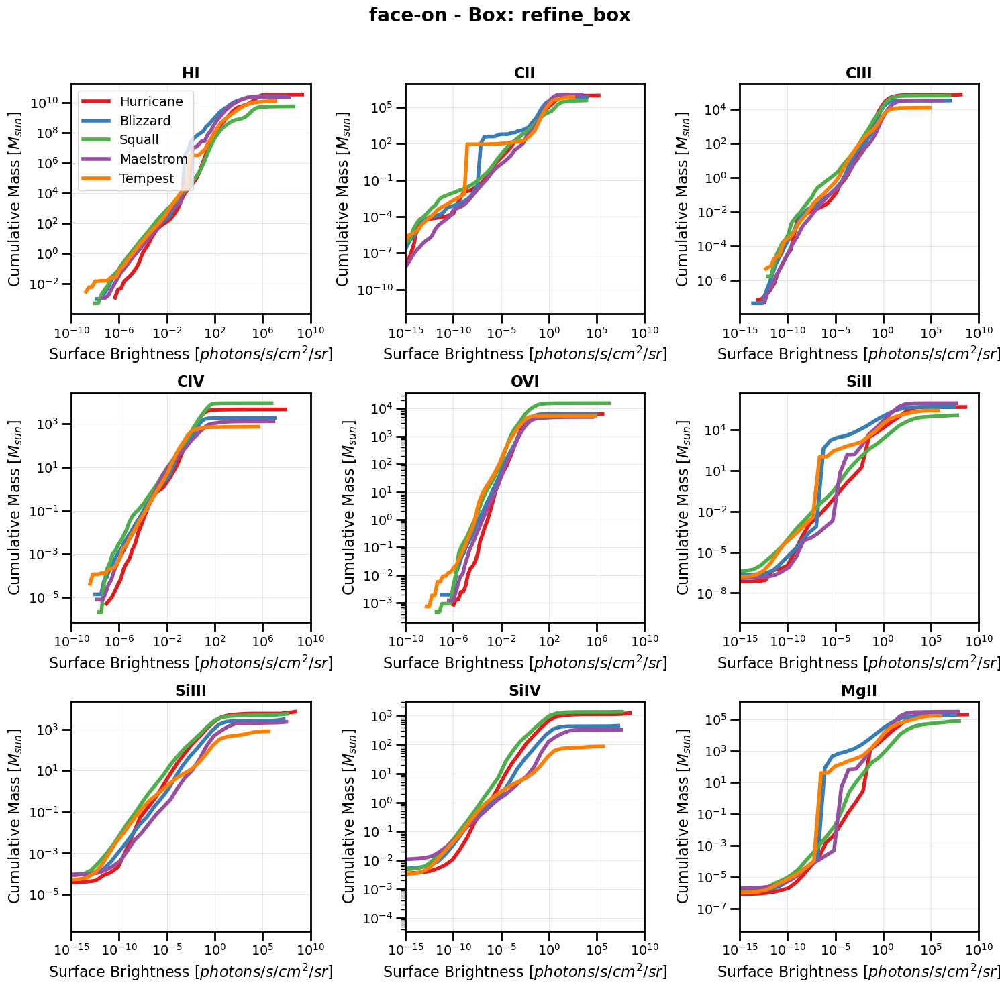

orientation edge
region all
orientation edge
region all
orientation edge
region all
orientation edge
region all
orientation edge
region all


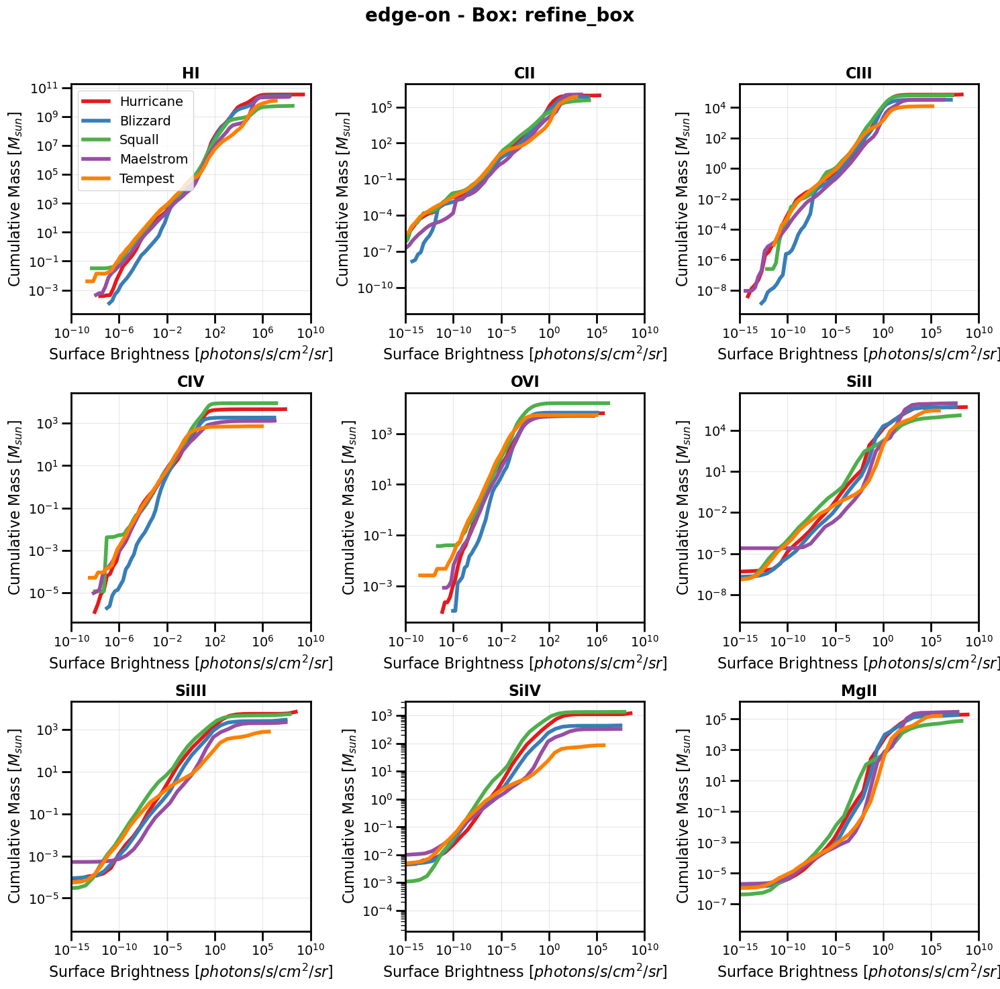

In [ ]:
for orientation in orientations:
    
    detectable_ions = ions  
    num_ions = len(detectable_ions)
    cols = __builtins__.min(3, num_ions)  # Limit to max 3 columns per row 
    rows = math.ceil(num_ions / cols)  # Compute required rows
    fig, axes = plt.subplots(rows, cols, figsize=(5 * cols, 5 * rows), squeeze=False)

    i = -1
    for halo in halos:
        foggie_dir,code_path, snap_name, halo_c_v_name, trackname, output_dir = generate_foggie_paths(halo, run, snap)
        snap_name = foggie_dir + snap + '/' + snap

        #ds, refine_box = foggie_load(snap_name, trackname, do_filter_particles=True, halo_c_v_name=halo_c_v_name, disk_relative=True, correct_bulk_velocity=True)#, smooth_AM_name=smooth_AM_name)
        #zsnap = ds.get_parameter('CosmologyCurrentRedshift')
        #prefix = output_dir + 'plots_halo_00' + halo + '/' + run + '/' + 'res_' + resolution + '/' + 'box_' + box_name + '/'
        prefix = output_dir + '/' + args.instrument + '/' + args.output + '/' + 'target_z_' + args.target_z + '/'+ 'box_' + box_name + '/'

        i += 1
        print('orientation', orientation)
        
        for region in regions:
            print('region', region)
            
            
            halo_name = halo_dict[halo]
            
            
            # Set a single title for the whole figure
            plt.suptitle(f'{orientation}-on - Box: {box_name}', fontsize=20, fontweight='bold')

            for index, ion in enumerate(detectable_ions):
                row, col = divmod(index, cols)
                ax = axes[row, col]  # Select corresponding subplot
                
                color = cmap(i)  
                save_path = prefix + 'FRBs/'
                file_path = os.path.join(save_path, f"{halo_name}_emission_maps.hdf5")

                mass_dataset_name = f"z=0.0/{ion}_mass_{orientation}_{region}"
                emission_dataset_name = f"z=0.0/{ion}_emission_{orientation}_{region}"

                with h5py.File(file_path, 'r') as f:
                        mass_data = np.array(f[mass_dataset_name]).flatten()
                        emission_data = np.array(f[emission_dataset_name]).flatten()

                        # Convert bin size and compute area
                        bin_size = float(bin_size_kpc) * kpc
                        bin_area = bin_size.to(cm) ** 2  

                        # Filter valid values
                        valid_indices = (emission_data > 1e-40) & (mass_data > 1e-40)
                        emission_data = emission_data[valid_indices]
                        mass_data = mass_data[valid_indices]

                        # Define log-spaced bins for emission
                        bins = np.logspace(np.log10(emission_data.min()), np.log10(emission_data.max()), 64)

                        # Calculate cumulative mass for each bin
                        bin_indices = np.digitize(emission_data, bins)
                        cumulative_mass = np.array([mass_data[bin_indices <= k].sum() for k in range(1, len(bins))])

                        # Plot the cumulative results
                        bin_centers = 0.5 * (bins[:-1] + bins[1:])
                        ax.plot(bin_centers, cumulative_mass, color=color, lw=4, label=halo_name)

                        # if args.Juniper_limit and ion in ['OVI', 'CII', 'CIII', 'CIV']:
                        #     flux_lim = flux_threshold_dict[ion]
                        #     ax.axvline(x=flux_lim, color='k', linestyle='--', linewidth=2)

                            
                # Formatting for each subplot
                ax.set_xscale('log')
                ax.set_xlabel('Surface Brightness [$photons/s/cm^2/sr$]', fontsize=16)
                ax.set_ylabel('Cumulative Mass [$M_{sun}$]', fontsize=16)
                ax.grid(True, alpha=0.3)
                ax.set_xlim(10**x_lim_dict[ion][0], 10**x_lim_dict[ion][1])
                ax.set_yscale('log')

                # Make borders (spines) bold
                for spine in ax.spines.values():
                    spine.set_linewidth(2)
                    spine.set_color("k")

                # Set ticks outward
                ax.tick_params(axis='both', which='major', labelsize=14, length=10, width=2, color="k", labelcolor="k", direction="out", top=False, right=False)
                ax.tick_params(axis='both', which='minor', labelsize=14, length=5, width=1, color="k", labelcolor="k", direction="out", top=False, right=False)
                
                #ax.legend(fontsize=14)
                ax.yaxis.offsetText.set_fontsize(14)

                # Set subplot title with ion name
                ax.set_title(f'{ion}', fontsize=16, fontweight='bold')
                if ion == 'HI':
                    ax.legend(loc = 'upper left',fontsize=14)

    # Remove any empty subplots if they exist
    for j in range(index + 1, len(axes.flatten())):
        fig.delaxes(axes.flatten()[j])

    # Adjust layout and spacing
    plt.tight_layout(rect=[0, 0, 1, 0.96])  # Leaves space for suptitle
    

    # Save the figure
    plot_dir = os.path.join(output_dir, "allhalos_mass_vs_emission_plots")
    os.makedirs(plot_dir, exist_ok=True)
    plt.savefig(os.path.join(plot_dir, f"{orientation}_cumulative_mass_vs_emission.png"))
    plt.show()
    plt.close()
    

            

orientation face
region all
orientation face
region all
orientation face
region all
orientation face
region all
orientation face
region all


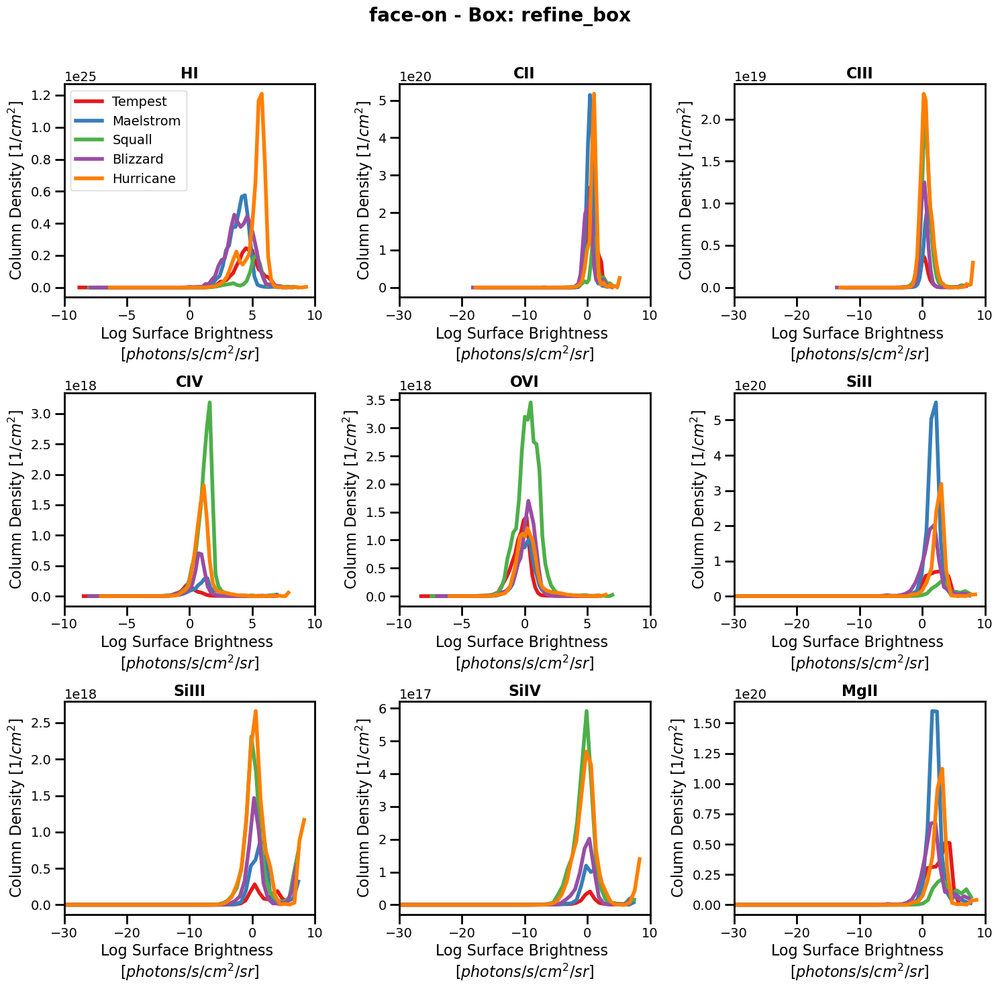

orientation edge
region all
orientation edge
region all
orientation edge
region all
orientation edge
region all
orientation edge
region all


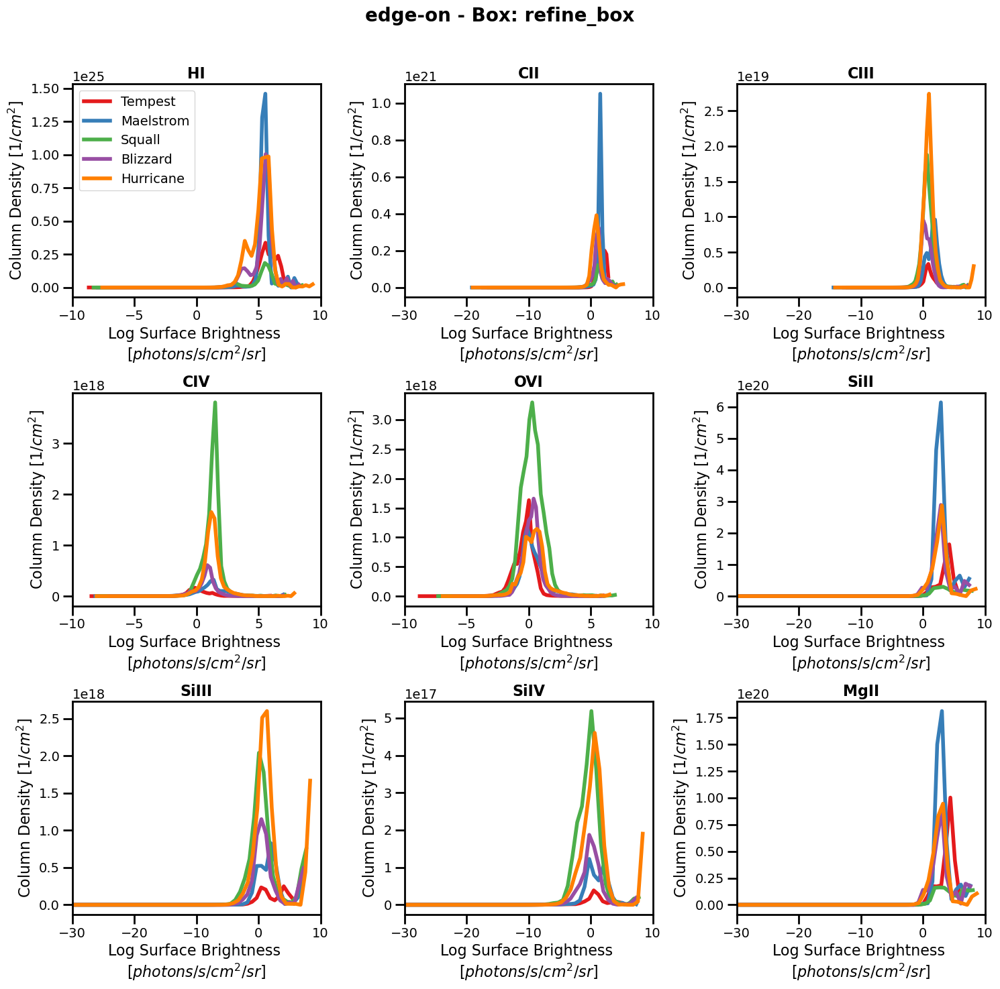

In [40]:
for orientation in orientations:
    
    detectable_ions = ions  
    num_ions = len(detectable_ions)
    cols = __builtins__.min(3, num_ions)  # Limit to max 3 columns per row 
    rows = math.ceil(num_ions / cols)  # Compute required rows
    fig, axes = plt.subplots(rows, cols, figsize=(5 * cols, 5 * rows), squeeze=False)

    i = -1
    for halo in halos:
        foggie_dir,code_path, snap_name, halo_c_v_name, trackname, output_dir = generate_foggie_paths(halo, run, snap)
        snap_name = foggie_dir + snap + '/' + snap

        prefix = output_dir + 'plots_halo_00' + halo + '/' + run + '/' + 'res_' + resolution + '/' + 'box_' + box_name + '/'

        i += 1
        print('orientation', orientation)
        
        for region in regions:
            print('region', region)
            
            
            halo_name = halo_dict[halo]
            
            
            # Set a single title for the whole figure
            plt.suptitle(f'{orientation}-on - Box: {box_name}', fontsize=20, fontweight='bold')

            for index, ion in enumerate(detectable_ions):
                row, col = divmod(index, cols)
                ax = axes[row, col]  # Select corresponding subplot
                
                color = cmap(i)  
                save_path = prefix + 'FRBs/'
                file_path = os.path.join(save_path, f"{halo_name}_emission_maps.hdf5")

                numdensity_dataset_name = f"z=0.0/{ion}_numdensity_{orientation}_{region}"
                emission_dataset_name = f"z=0.0/{ion}_emission_{orientation}_{region}"

                with h5py.File(file_path, 'r') as f:
                    numdensity_data = np.array(f[numdensity_dataset_name]).flatten()
                    emission_data = np.array(f[emission_dataset_name]).flatten()
                    
                    valid_indices = (emission_data > 1e-40) 
                    emission_data = emission_data[valid_indices]
                    numdensity_data = numdensity_data[valid_indices]
                    total_mass = numdensity_data.sum()
                    

                    # Compute bins and mass per bin
                    flux_min = np.log10(emission_data).min()
                    flux_max = np.log10(emission_data).max()
                    bins = np.linspace(flux_min, flux_max, 64)
                    bin_centers = 0.5 * (bins[:-1] + bins[1:])
                    numdensity_per_bin = np.histogram(np.log10(emission_data), bins=bins, weights=numdensity_data)[0]

                    ax.plot(bin_centers, numdensity_per_bin, color=color, linewidth=4, label=halo_name)
                    
                    # if args.Juniper_limit and ion in ['OVI', 'CII', 'CIII', 'CIV']:
                    #     flux_lim = flux_threshold_dict[ion]
                    #     above_flux_lim_indices = emission_data > flux_lim
                    #     mass_above_flux_lim = mass_data[above_flux_lim_indices].sum()
                    #     mass_fraction = mass_above_flux_lim / total_mass if total_mass > 0 else 0
                    #     ax.fill_between(bin_centers, mass_per_bin, where=(bin_centers >= np.log10(flux_lim)), color=color, alpha=0.5)
                    #     ax.axvline(x=np.log10(flux_lim), color='k', linestyle='--', linewidth=2)

                    

                # if args.Juniper_limit and ion in ['OVI', 'CII', 'CIII', 'CIV']:
                #     annotation_text = "$M_{frac}$:" f"{mass_fraction:.1%}"
                #     ax.annotate(annotation_text, xy=(0.06, 0.94), xycoords='axes fraction', ha='left', va='top', fontsize=18, bbox=dict(facecolor='white', alpha=0.5))
                
                ax.set_xlabel('Log Surface Brightness \n[$photons/s/cm^2/sr$]', fontsize=16)
                ax.set_ylabel('Column Density [$1/cm^2$]', fontsize=16)
                ax.set_xlim(x_lim_dict[ion][0], x_lim_dict[ion][1])
                

                # Make borders (spines) bold
                for spine in ax.spines.values():
                    spine.set_linewidth(2)
                    spine.set_color("k")

                # Set ticks outward
                ax.tick_params(axis='both', which='major', labelsize=14, length=10, width=2, color="k", labelcolor="k", direction="out", top=False, right=False)
                ax.tick_params(axis='both', which='minor', labelsize=14, length=5, width=1, color="k", labelcolor="k", direction="out", top=False, right=False)
                
                #ax.legend(fontsize=14)
                ax.yaxis.offsetText.set_fontsize(14)

                # Set subplot title with ion name
                ax.set_title(f'{ion}', fontsize=16, fontweight='bold')
                if ion == 'HI':
                    ax.legend(loc = 'upper left',fontsize=14)

    # Remove any empty subplots if they exist
    for j in range(index + 1, len(axes.flatten())):
        fig.delaxes(axes.flatten()[j])

    # Adjust layout and spacing
    plt.tight_layout(rect=[0, 0, 1, 0.96])  # Leaves space for suptitle
    

    # Save the figure
    plot_dir = os.path.join(output_dir, "allhalos_numdensity_vs_emission_plots")
    os.makedirs(plot_dir, exist_ok=True)
    plt.savefig(os.path.join(plot_dir, f"{orientation}_numdensity_vs_emission.png"))
    plt.show()
    plt.close()
    

            

number density lenghth 1098304
emission data length 1098304
number density lenghth 1098304
emission data length 1098304
number density lenghth 1098304
emission data length 1098304
number density lenghth 1098304
emission data length 1098304
number density lenghth 1098304
emission data length 1098304
number density lenghth 1098304
emission data length 1098304
number density lenghth 1098304
emission data length 1098304
number density lenghth 1098304
emission data length 1098304
number density lenghth 1098304
emission data length 1098304
number density lenghth 1098304
emission data length 1098304
number density lenghth 1098304
emission data length 1098304
number density lenghth 1098304
emission data length 1098304
number density lenghth 1098304
emission data length 1098304
number density lenghth 1098304
emission data length 1098304
number density lenghth 1098304
emission data length 1098304
number density lenghth 1098304
emission data length 1098304
number density lenghth 1098304
emission 

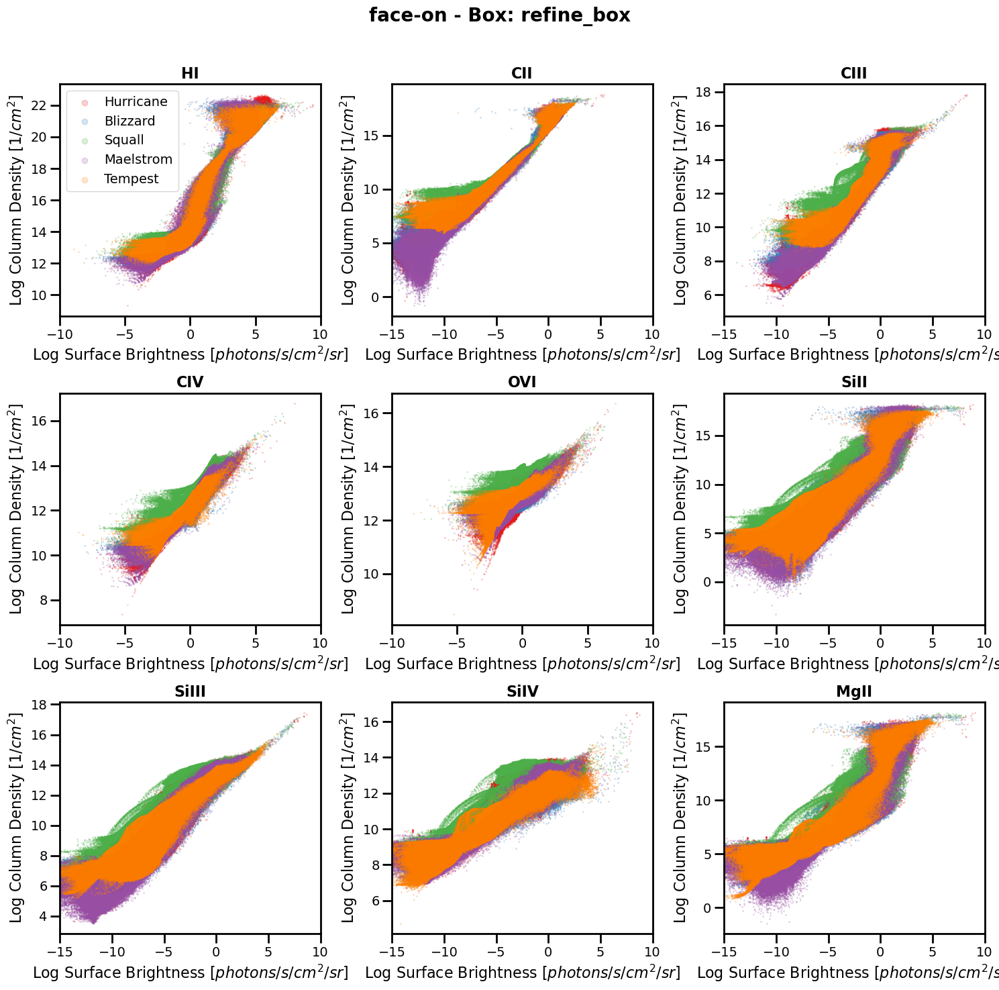

number density lenghth 1098304
emission data length 1098304
number density lenghth 1098304
emission data length 1098304
number density lenghth 1098304
emission data length 1098304
number density lenghth 1098304
emission data length 1098304
number density lenghth 1098304
emission data length 1098304
number density lenghth 1098304
emission data length 1098304
number density lenghth 1098304
emission data length 1098304
number density lenghth 1098304
emission data length 1098304
number density lenghth 1098304
emission data length 1098304
number density lenghth 1098304
emission data length 1098304
number density lenghth 1098304
emission data length 1098304
number density lenghth 1098304
emission data length 1098304
number density lenghth 1098304
emission data length 1098304
number density lenghth 1098304
emission data length 1098304
number density lenghth 1098304
emission data length 1098304
number density lenghth 1098304
emission data length 1098304
number density lenghth 1098304
emission 

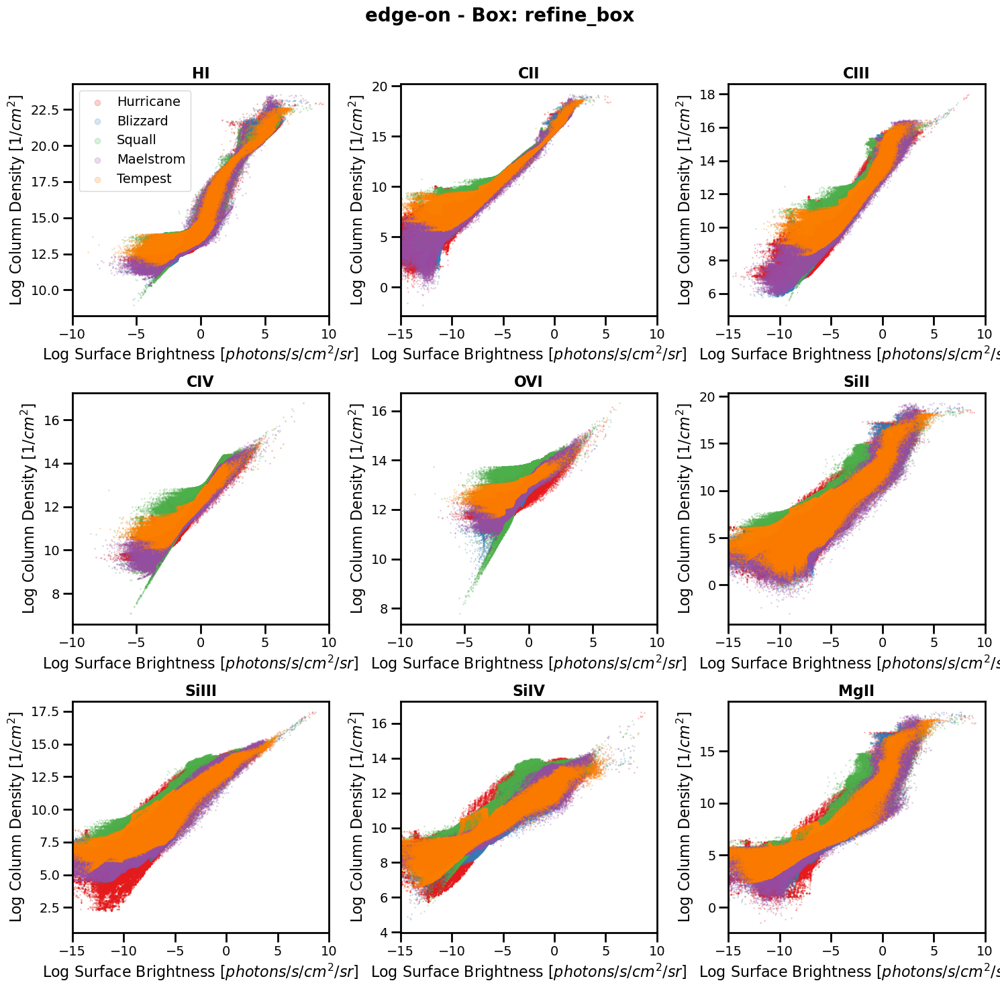

In [79]:
for orientation in orientations:
    detectable_ions = ions  
    num_ions = len(detectable_ions)
    cols = __builtins__.min(3, num_ions)  # Limit to max 3 columns per row 
    rows = math.ceil(num_ions / cols)  # Compute required rows
    fig, axes = plt.subplots(rows, cols, figsize=(5 * cols, 5 * rows), squeeze=False)
    i = -1
    for halo in halos:
        i += 1
        foggie_dir, code_path, snap_name, halo_c_v_name, trackname, output_dir = generate_foggie_paths(halo, run, snap)
        snap_name = foggie_dir + snap + '/' + snap
        prefix = output_dir + f'plots_halo_00{halo}/{run}/res_{resolution}/box_{box_name}/'
        halo_name = halo_dict[halo]
        color = cmap(i) 
        

        for region in regions:
            plt.suptitle(f'{orientation}-on - Box: {box_name}', fontsize=20, fontweight='bold')
            
            for index, ion in enumerate(detectable_ions):
                row, col = divmod(index, cols)
                ax = axes[row, col]  # Select corresponding subplot
                
                save_path = prefix + 'FRBs/'
                file_path = os.path.join(save_path, f"{halo_name}_emission_maps.hdf5")
                
                numdensity_dataset_name = f"z=0.0/{ion}_numdensity_{orientation}_{region}"
                emission_dataset_name = f"z=0.0/{ion}_emission_{orientation}_{region}"
                
                with h5py.File(file_path, 'r') as f:
                    numdensity_data = np.array(f[numdensity_dataset_name]).flatten()
                    emission_data = np.array(f[emission_dataset_name]).flatten()
                    print('number density lenghth',len(numdensity_data))
                    print('emission data length',len(emission_data))
                    
                    valid_indices = (emission_data > 1e-40) & (numdensity_data > 0)
                    emission_data = emission_data[valid_indices]
                    numdensity_data = numdensity_data[valid_indices]
                    
                    # Log scale transformation
                    log_emission = np.log10(emission_data)
                    log_numdensity = np.log10(numdensity_data)
                    
                    # Scatter plot
                    scatter_plot = ax.scatter(log_emission, log_numdensity, alpha=0.2, s=1, label=halo_name, color=color)



                    
                ax.set_xlabel('Log Surface Brightness [$photons/s/cm^2/sr$]', fontsize=16)
                ax.set_ylabel('Log Column Density [$1/cm^2$]', fontsize=16)
                
                ax.set_xlim(x_lim_dict[ion][0], x_lim_dict[ion][1])
                ax.set_title(f'{ion}', fontsize=16, fontweight='bold')
                
                
                # Formatting axes
                ax.spines.values()
                for spine in ax.spines.values():
                    spine.set_linewidth(2)
                    spine.set_color("k")
                
                ax.tick_params(axis='both', which='major', labelsize=14, length=10, width=2, color="k", labelcolor="k", direction="out", top=False, right=False)
                ax.tick_params(axis='both', which='minor', labelsize=14, length=5, width=1, color="k", labelcolor="k", direction="out", top=False, right=False)
                
                # Adjust legend separately to have larger marker size
                if ion == 'HI':
                    legend = ax.legend(loc='upper left', fontsize=14, handletextpad=0.5, markerscale=6)
    
    # Remove empty subplots
    for j in range(index + 1, len(axes.flatten())):
        fig.delaxes(axes.flatten()[j])
    
    plt.tight_layout(rect=[0, 0, 1, 0.96])  # Leaves space for suptitle
    
    # Save the figure
    plot_dir = os.path.join(output_dir, "allhalos_numdensity_vs_emission_plots")
    os.makedirs(plot_dir, exist_ok=True)
    plt.savefig(os.path.join(plot_dir, f"{orientation}_numdensity_vs_emission_scatter.png"))
    plt.show()
    plt.close()


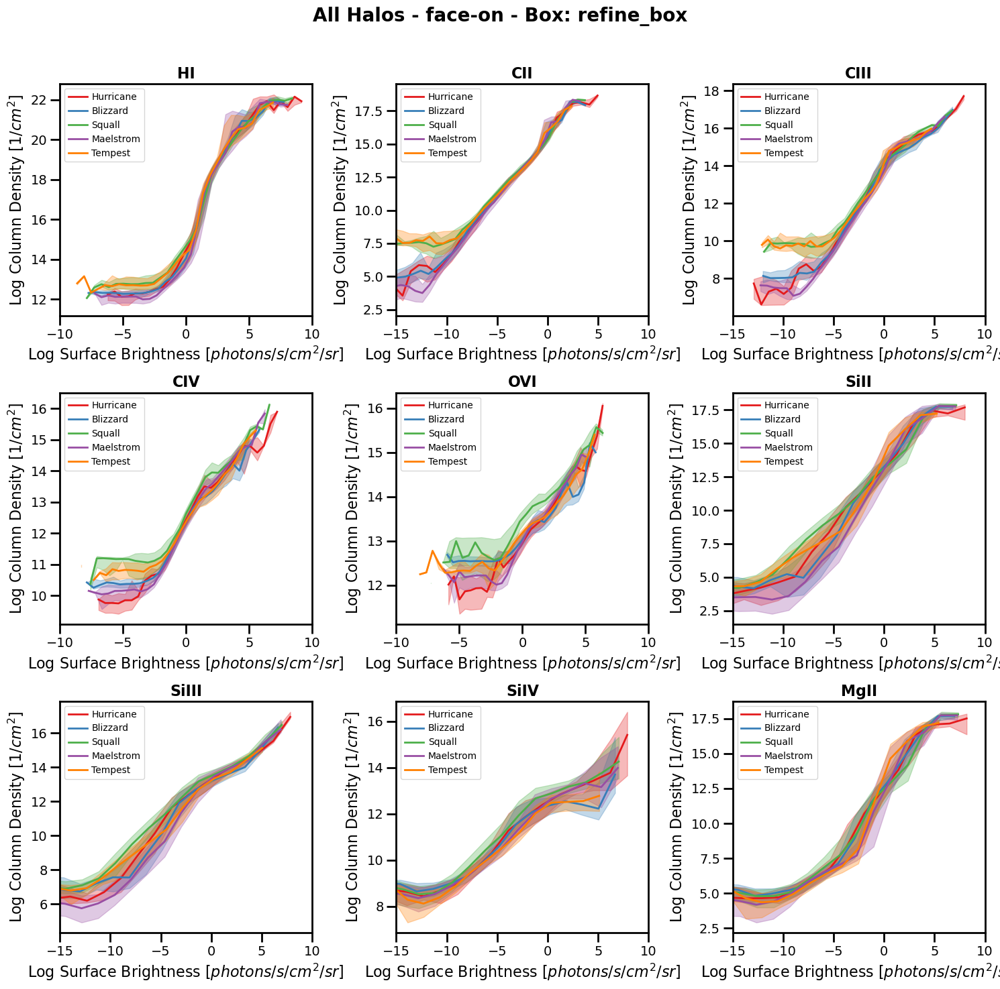

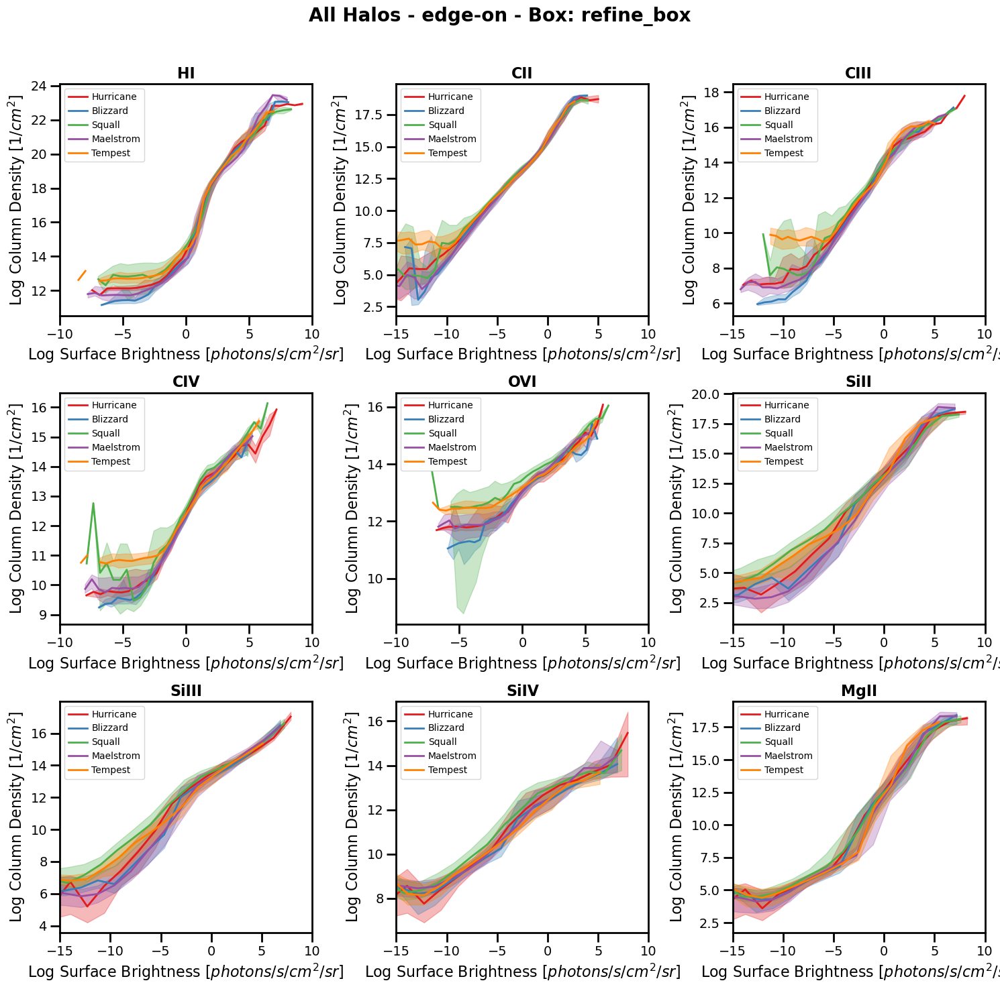

In [73]:

for orientation in orientations:
    num_ions = len(ions)
    cols = __builtins__.min(3, num_ions)  # Limit to max 3 columns per row
    rows = math.ceil(num_ions / cols)  # Compute required rows
    fig, axes = plt.subplots(rows, cols, figsize=(5 * cols, 5 * rows), squeeze=False)
    plt.suptitle(f'All Halos - {orientation}-on - Box: {box_name}', fontsize=20, fontweight='bold')
    
    for halo_index, halo in enumerate(halos):
        foggie_dir, code_path, snap_name, halo_c_v_name, trackname, output_dir = generate_foggie_paths(halo, run, snap)
        snap_name = foggie_dir + snap + '/' + snap
        prefix = output_dir + f'plots_halo_00{halo}/{run}/res_{resolution}/box_{box_name}/'
        halo_name = halo_dict[halo]
        color = cmap(halo_index) 
        
        for region in regions:
            for index, ion in enumerate(ions):
                row, col = divmod(index, cols)
                ax = axes[row, col]  # Select corresponding subplot
                
                save_path = prefix + 'FRBs/'
                file_path = os.path.join(save_path, f"{halo_name}_emission_maps.hdf5")
                
                numdensity_dataset_name = f"z=0.0/{ion}_numdensity_{orientation}_{region}"
                emission_dataset_name = f"z=0.0/{ion}_emission_{orientation}_{region}"
                
                with h5py.File(file_path, 'r') as f:
                    numdensity_data = np.array(f[numdensity_dataset_name]).flatten()
                    emission_data = np.array(f[emission_dataset_name]).flatten()
                    
                    valid_indices = (emission_data > 1e-40) & (numdensity_data > 0)
                    emission_data = emission_data[valid_indices]
                    numdensity_data = numdensity_data[valid_indices]
                    
                    # Log scale transformation
                    log_emission = np.log10(emission_data)
                    log_numdensity = np.log10(numdensity_data)
                    
                    # Compute median and spread
                    bins = np.linspace(log_emission.min(), log_emission.max(), 30)
                    bin_centers = 0.5 * (bins[:-1] + bins[1:])
                    median_values = []
                    lower_bounds = []
                    upper_bounds = []
                    
                    for j in range(len(bins) - 1):
                        bin_mask = (log_emission >= bins[j]) & (log_emission < bins[j+1])
                        if np.any(bin_mask):
                            median_values.append(np.median(log_numdensity[bin_mask]))
                            lower_bounds.append(np.percentile(log_numdensity[bin_mask], 16))
                            upper_bounds.append(np.percentile(log_numdensity[bin_mask], 84))
                        else:
                            median_values.append(np.nan)
                            lower_bounds.append(np.nan)
                            upper_bounds.append(np.nan)
                    
                    median_values = np.array(median_values)
                    lower_bounds = np.array(lower_bounds)
                    upper_bounds = np.array(upper_bounds)
                    
                    ax.plot(bin_centers, median_values, color=color, linewidth=2, label=halo_name)
                    ax.fill_between(bin_centers, lower_bounds, upper_bounds, color=color, alpha=0.3)
                
                ax.set_xlabel('Log Surface Brightness [$photons/s/cm^2/sr$]', fontsize=16)
                ax.set_ylabel('Log Column Density [$1/cm^2$]', fontsize=16)
                ax.set_xlim(x_lim_dict[ion][0], x_lim_dict[ion][1])
                ax.set_title(f'{ion}', fontsize=16, fontweight='bold')
                
                # Formatting axes
                for spine in ax.spines.values():
                    spine.set_linewidth(2)
                    spine.set_color("k")
                
                ax.tick_params(axis='both', which='major', labelsize=14, length=10, width=2, color="k", labelcolor="k", direction="out", top=False, right=False)
                ax.tick_params(axis='both', which='minor', labelsize=14, length=5, width=1, color="k", labelcolor="k", direction="out", top=False, right=False)
                
                ax.legend(loc='upper left', fontsize=10, handletextpad=0.5)
    
    plt.tight_layout(rect=[0, 0, 1, 0.96])  # Leaves space for suptitle
    
    # Save the figure
    plot_dir = os.path.join(output_dir, "allhalos_numdensity_vs_emission_plots")
    os.makedirs(plot_dir, exist_ok=True)
    plt.savefig(os.path.join(plot_dir, f"allhalos_{orientation}_numdensity_vs_emission_median.png"))
    plt.show()
    plt.close()


<>:64: SyntaxWarning: invalid escape sequence '\o'
<>:64: SyntaxWarning: invalid escape sequence '\o'
/var/folders/03/8m_yf9p11xd_2mlw7w_4dw4w0000gn/T/ipykernel_13823/3807748932.py:64: SyntaxWarning: invalid escape sequence '\o'
  ax.set_ylabel('Log Mass [$M_{\odot}$]', fontsize=16)


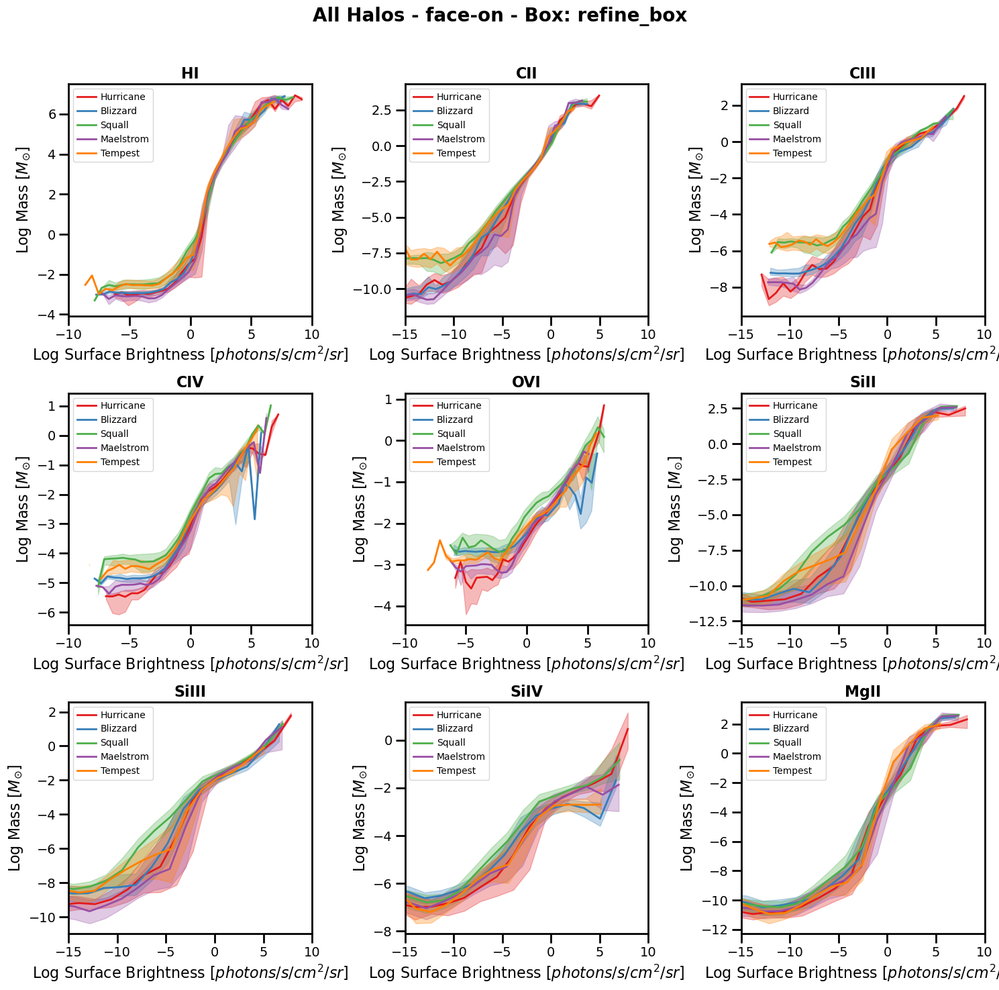

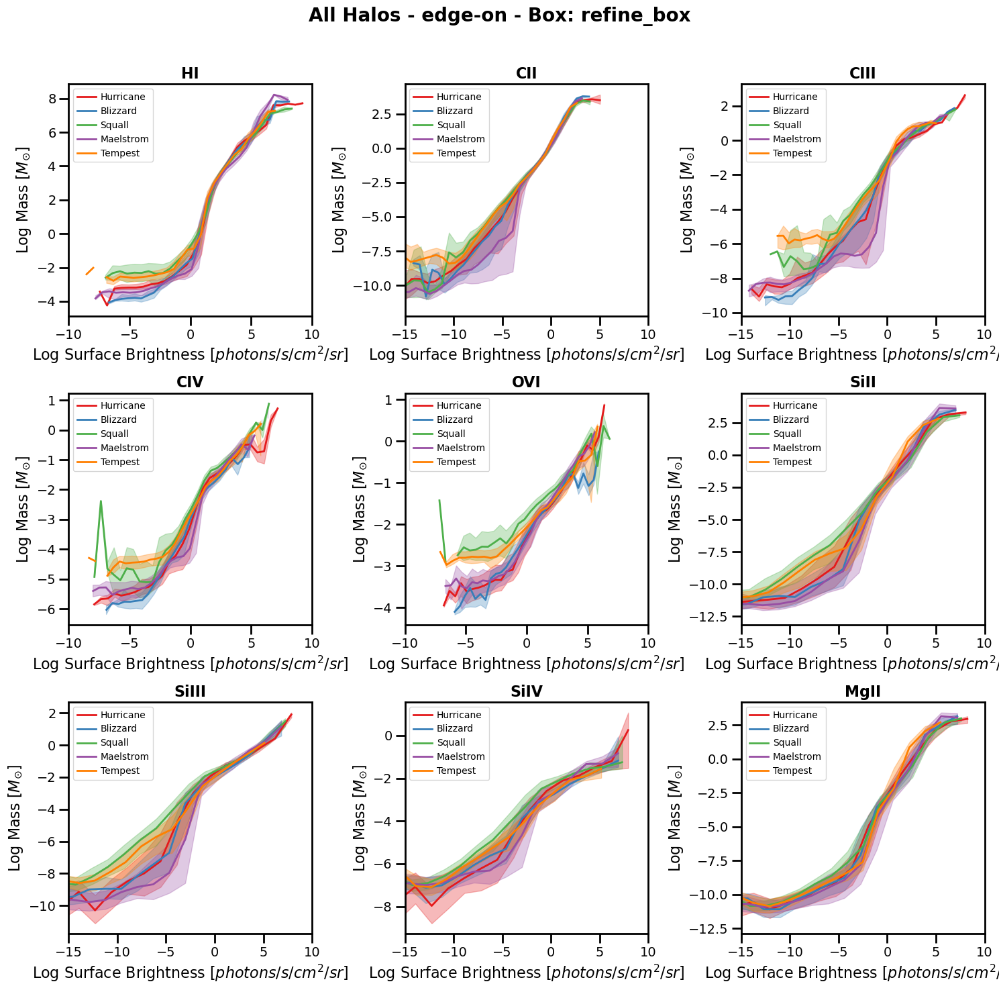

<>:44: SyntaxWarning: invalid escape sequence '\o'
<>:44: SyntaxWarning: invalid escape sequence '\o'
/var/folders/03/8m_yf9p11xd_2mlw7w_4dw4w0000gn/T/ipykernel_13823/3151680399.py:44: SyntaxWarning: invalid escape sequence '\o'
  ax.set_ylabel('Log Mass [$M_{\odot}$]', fontsize=16)


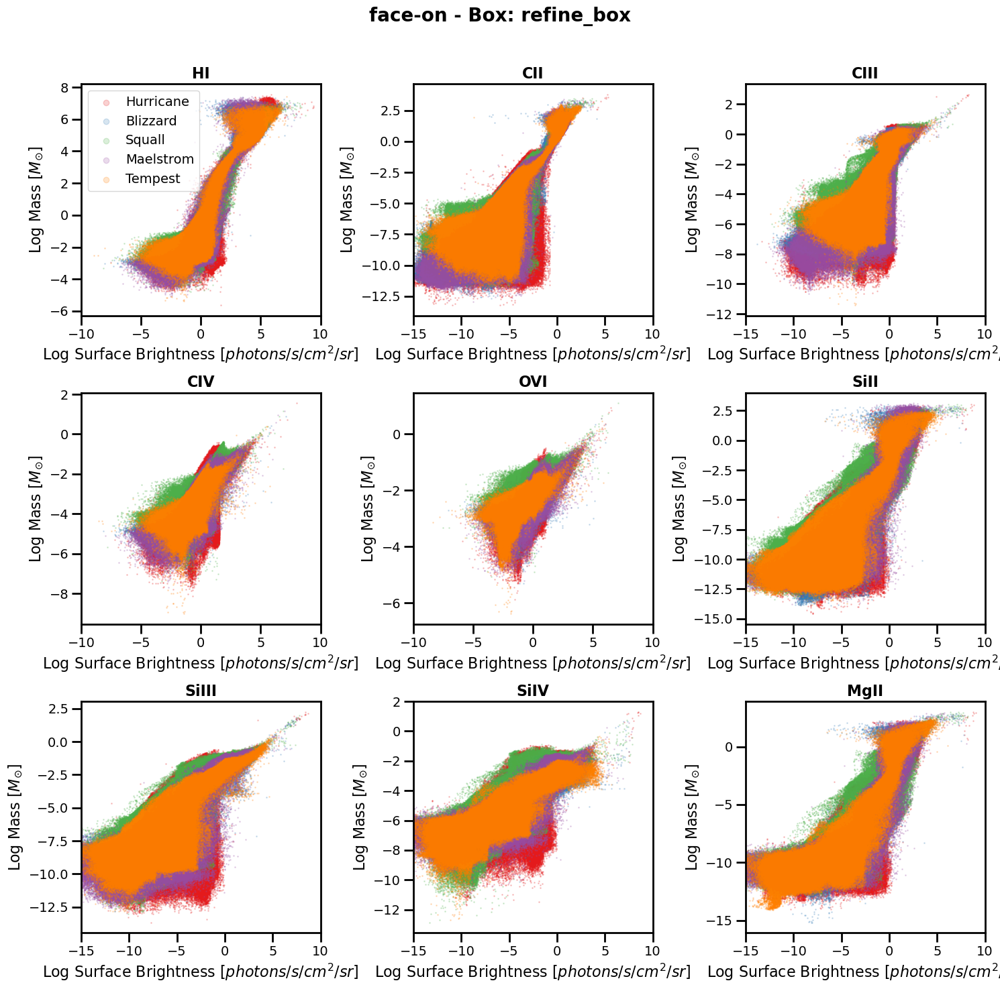

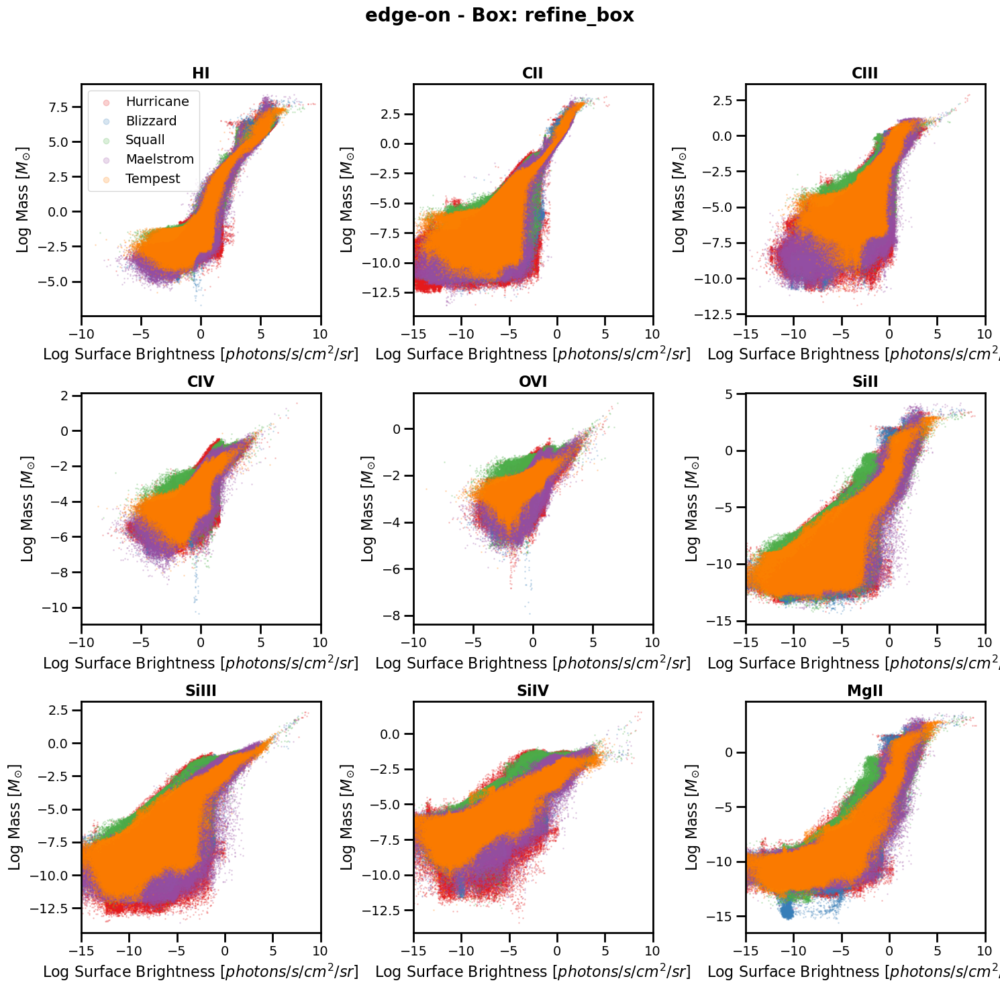

In [78]:
for orientation in orientations:
    detectable_ions = ions  
    num_ions = len(detectable_ions)
    cols = __builtins__.min(3, num_ions)  # Limit to max 3 columns per row
    rows = math.ceil(num_ions / cols)  # Compute required rows
    fig, axes = plt.subplots(rows, cols, figsize=(5 * cols, 5 * rows), squeeze=False)
    
    for halo_index, halo in enumerate(halos):
        foggie_dir, code_path, snap_name, halo_c_v_name, trackname, output_dir = generate_foggie_paths(halo, run, snap)
        snap_name = foggie_dir + snap + '/' + snap
        prefix = output_dir + f'plots_halo_00{halo}/{run}/res_{resolution}/box_{box_name}/'
        halo_name = halo_dict[halo]
        color = cmap(halo_index) 
        
        for region in regions:
            plt.suptitle(f'{orientation}-on - Box: {box_name}', fontsize=20, fontweight='bold')
            
            for index, ion in enumerate(detectable_ions):
                row, col = divmod(index, cols)
                ax = axes[row, col]  # Select corresponding subplot
                
                save_path = prefix + 'FRBs/'
                file_path = os.path.join(save_path, f"{halo_name}_emission_maps.hdf5")
                
                mass_dataset_name = f"z=0.0/{ion}_mass_{orientation}_{region}"
                emission_dataset_name = f"z=0.0/{ion}_emission_{orientation}_{region}"
                
                with h5py.File(file_path, 'r') as f:
                    mass_data = np.array(f[mass_dataset_name]).flatten()
                    emission_data = np.array(f[emission_dataset_name]).flatten()
                    
                    valid_indices = (emission_data > 1e-40) & (mass_data > 0)
                    emission_data = emission_data[valid_indices]
                    mass_data = mass_data[valid_indices]
                    
                    # Log scale transformation
                    log_emission = np.log10(emission_data)
                    log_mass = np.log10(mass_data)
                    
                    # Scatter plot
                    ax.scatter(log_emission, log_mass, alpha=0.2, s=1, label=halo_name, color=color)
                
                ax.set_xlabel('Log Surface Brightness [$photons/s/cm^2/sr$]', fontsize=16)
                ax.set_ylabel('Log Mass [$M_{\odot}$]', fontsize=16)
                ax.set_xlim(x_lim_dict[ion][0], x_lim_dict[ion][1])
                ax.set_title(f'{ion}', fontsize=16, fontweight='bold')
                
                # Formatting axes
                for spine in ax.spines.values():
                    spine.set_linewidth(2)
                    spine.set_color("k")
                
                ax.tick_params(axis='both', which='major', labelsize=14, length=10, width=2, color="k", labelcolor="k", direction="out", top=False, right=False)
                ax.tick_params(axis='both', which='minor', labelsize=14, length=5, width=1, color="k", labelcolor="k", direction="out", top=False, right=False)
                
                if ion == 'HI':
                    ax.legend(loc='upper left', fontsize=14, handletextpad=0.5, markerscale=6)
    
    # Remove empty subplots
    for j in range(index + 1, len(axes.flatten())):
        fig.delaxes(axes.flatten()[j])
    
    plt.tight_layout(rect=[0, 0, 1, 0.96])  # Leaves space for suptitle
    
    # Save the figure
    plot_dir = os.path.join(output_dir, "allhalos_mass_vs_emission_scatter_plots")
    os.makedirs(plot_dir, exist_ok=True)
    plt.savefig(os.path.join(plot_dir, f"{orientation}_mass_vs_emission_scatter.png"))
    plt.show()
    plt.close()

orientation face
region all
orientation face
region all
orientation face
region all
orientation face
region all
orientation face
region all


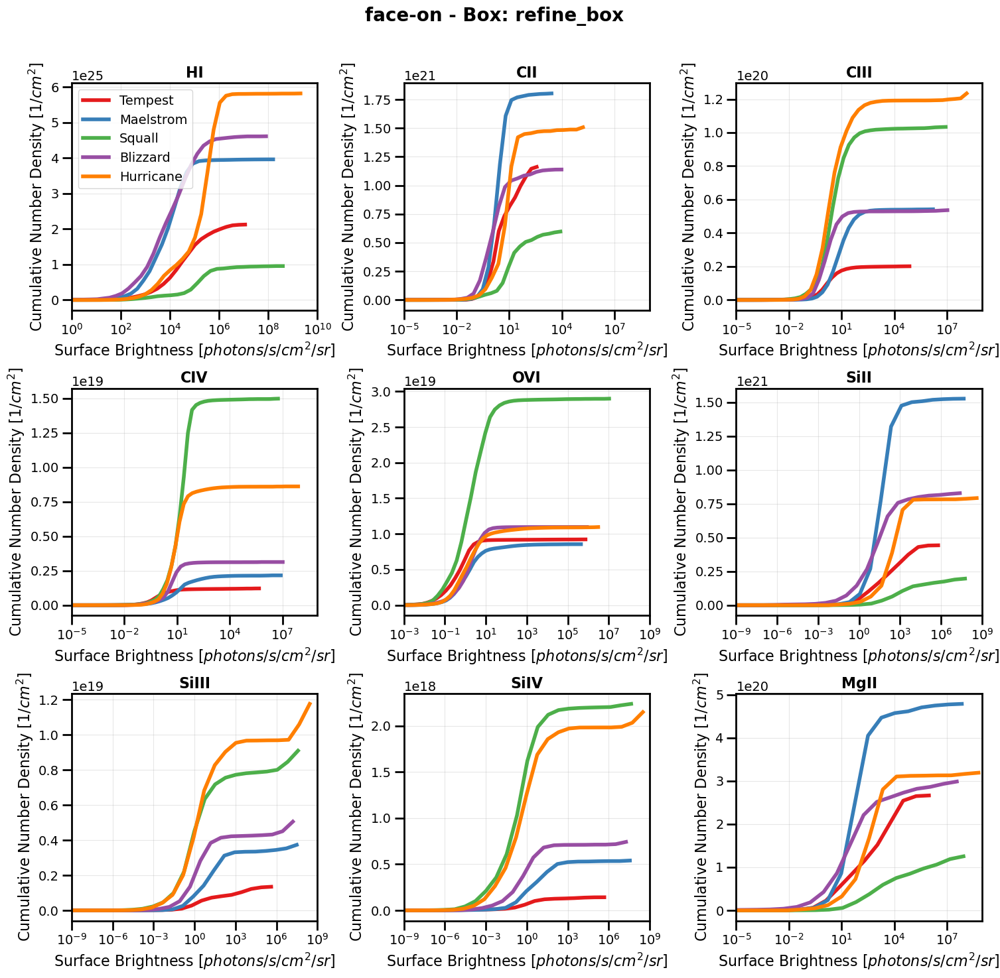

orientation edge
region all
orientation edge
region all
orientation edge
region all
orientation edge
region all
orientation edge
region all


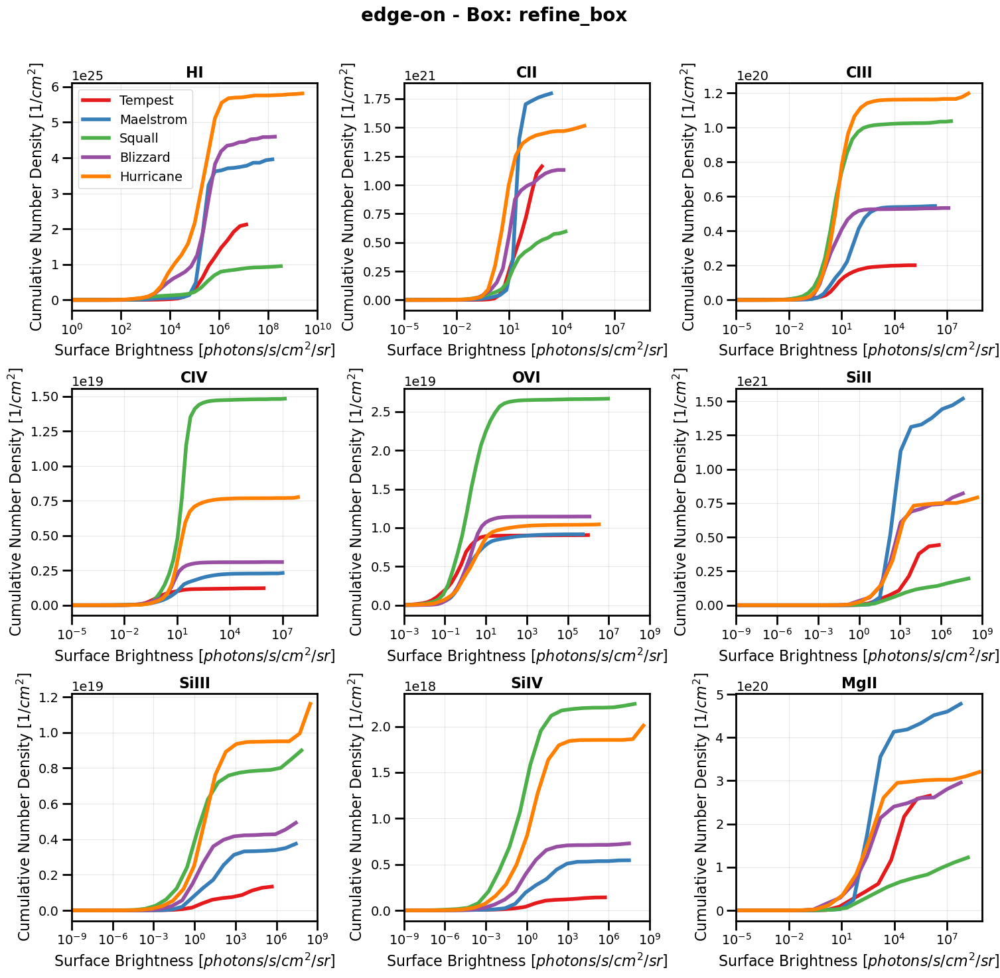

In [31]:
for orientation in orientations:
    
    detectable_ions = ions  
    num_ions = len(detectable_ions)
    cols = __builtins__.min(3, num_ions)  # Limit to max 3 columns per row 
    rows = math.ceil(num_ions / cols)  # Compute required rows
    fig, axes = plt.subplots(rows, cols, figsize=(5 * cols, 5 * rows), squeeze=False)

    i = -1
    for halo in halos:
        foggie_dir,code_path, snap_name, halo_c_v_name, trackname, output_dir = generate_foggie_paths(halo, run, snap)
        snap_name = foggie_dir + snap + '/' + snap

        #ds, refine_box = foggie_load(snap_name, trackname, do_filter_particles=True, halo_c_v_name=halo_c_v_name, disk_relative=True, correct_bulk_velocity=True)#, smooth_AM_name=smooth_AM_name)
        #zsnap = ds.get_parameter('CosmologyCurrentRedshift')
        prefix = output_dir + 'plots_halo_00' + halo + '/' + run + '/' + 'res_' + resolution + '/' + 'box_' + box_name + '/'

        i += 1
        print('orientation', orientation)
        
        for region in regions:
            print('region', region)
            
            
            halo_name = halo_dict[halo]
            
            
            # Set a single title for the whole figure
            plt.suptitle(f'{orientation}-on - Box: {box_name}', fontsize=20, fontweight='bold')

            for index, ion in enumerate(detectable_ions):
                row, col = divmod(index, cols)
                ax = axes[row, col]  # Select corresponding subplot
                
                color = cmap(i)  
                save_path = prefix + 'FRBs/'
                file_path = os.path.join(save_path, f"{halo_name}_emission_maps.hdf5")

                numdensity_dataset_name = f"z=0.0/{ion}_numdensity_{orientation}_{region}"
                emission_dataset_name = f"z=0.0/{ion}_emission_{orientation}_{region}"

                with h5py.File(file_path, 'r') as f:
                        numdensity_data = np.array(f[numdensity_dataset_name]).flatten()
                        emission_data = np.array(f[emission_dataset_name]).flatten()

                        # Convert bin size and compute area
                        bin_size = float(bin_size_kpc) * kpc
                        bin_area = bin_size.to(cm) ** 2  

                        # Filter valid values
                        valid_indices = (emission_data > 1e-40) 
                        emission_data = emission_data[valid_indices]
                        numdensity_data = numdensity_data[valid_indices]

                        # Define log-spaced bins for emission
                        bins = np.logspace(np.log10(emission_data.min()), np.log10(emission_data.max()), 64)

                        # Calculate cumulative mass for each bin
                        bin_indices = np.digitize(emission_data, bins)
                        cumulative_numdensity = np.array([numdensity_data[bin_indices <= k].sum() for k in range(1, len(bins))])

                        # Plot the cumulative results
                        bin_centers = 0.5 * (bins[:-1] + bins[1:])
                        ax.plot(bin_centers, cumulative_numdensity, color=color, lw=4, label=halo_name)

                        # if args.Juniper_limit and ion in ['OVI', 'CII', 'CIII', 'CIV']:
                        #     flux_lim = flux_threshold_dict[ion]
                        #     ax.axvline(x=flux_lim, color='k', linestyle='--', linewidth=2)

                            
                # Formatting for each subplot
                ax.set_xscale('log')
                ax.set_xlabel('Surface Brightness [$photons/s/cm^2/sr$]', fontsize=16)
                ax.set_ylabel('Cumulative Number Density [$1/cm^2$]', fontsize=16)
                ax.grid(True, alpha=0.3)
                ax.set_xlim(10**x_lim_dict[ion][0], 10**x_lim_dict[ion][1])

                # Make borders (spines) bold
                for spine in ax.spines.values():
                    spine.set_linewidth(2)
                    spine.set_color("k")

                # Set ticks outward
                ax.tick_params(axis='both', which='major', labelsize=14, length=10, width=2, color="k", labelcolor="k", direction="out", top=False, right=False)
                ax.tick_params(axis='both', which='minor', labelsize=14, length=5, width=1, color="k", labelcolor="k", direction="out", top=False, right=False)
                
                #ax.legend(fontsize=14)
                ax.yaxis.offsetText.set_fontsize(14)

                # Set subplot title with ion name
                ax.set_title(f'{ion}', fontsize=16, fontweight='bold')
                if ion == 'HI':
                    ax.legend(loc = 'upper left',fontsize=14)

    # Remove any empty subplots if they exist
    for j in range(index + 1, len(axes.flatten())):
        fig.delaxes(axes.flatten()[j])

    # Adjust layout and spacing
    plt.tight_layout(rect=[0, 0, 1, 0.96])  # Leaves space for suptitle
    

    # Save the figure
    plot_dir = os.path.join(output_dir, "allhalos_numdensity_vs_emission_plots")
    os.makedirs(plot_dir, exist_ok=True)
    plt.savefig(os.path.join(plot_dir, f"{orientation}_cumulative_numdensity_vs_emission.png"))
    plt.show()
    plt.close()
    

            

<>:72: SyntaxWarning: invalid escape sequence '\o'
<>:72: SyntaxWarning: invalid escape sequence '\o'
/var/folders/03/8m_yf9p11xd_2mlw7w_4dw4w0000gn/T/ipykernel_4980/3955960814.py:72: SyntaxWarning: invalid escape sequence '\o'
  ax_mass.set_xlabel('Log Mass \n[$M_\odot$]', fontsize=16)


orientation face
region all
orientation face
region all
orientation face
region all
orientation face
region all
orientation face
region all


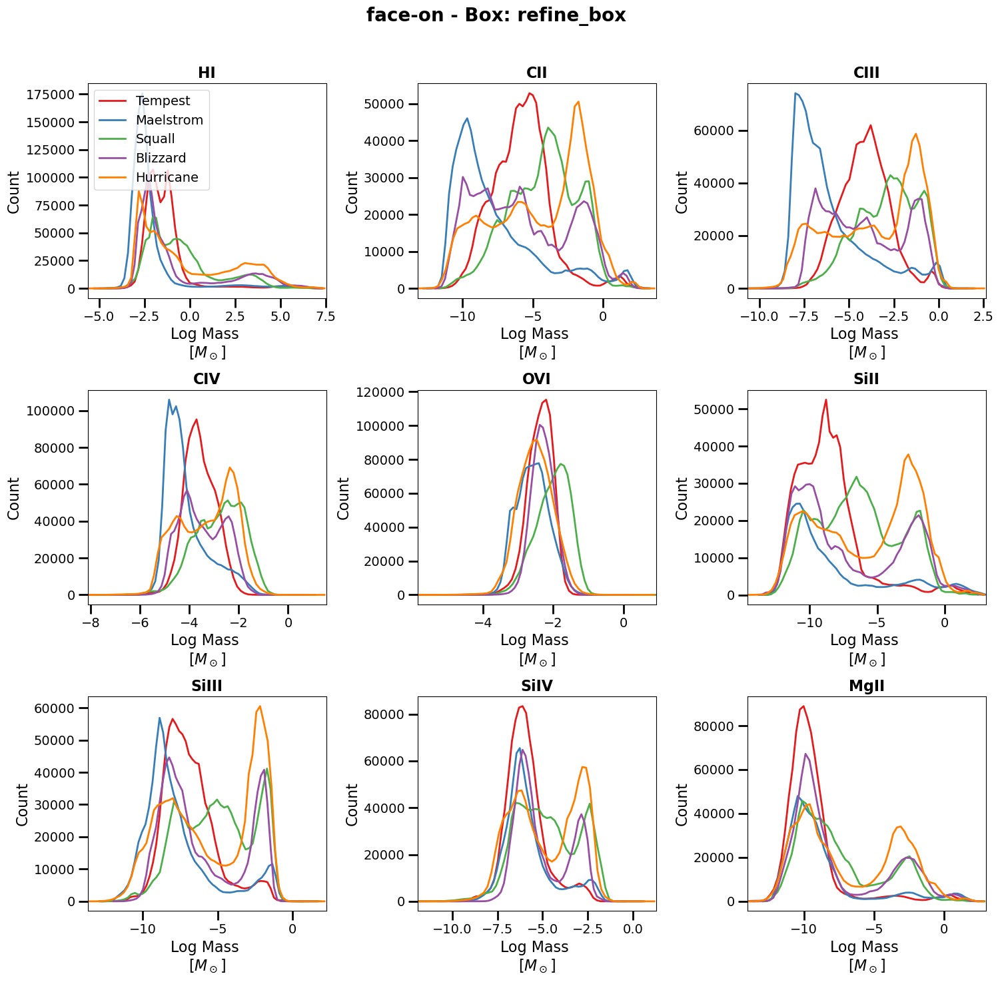

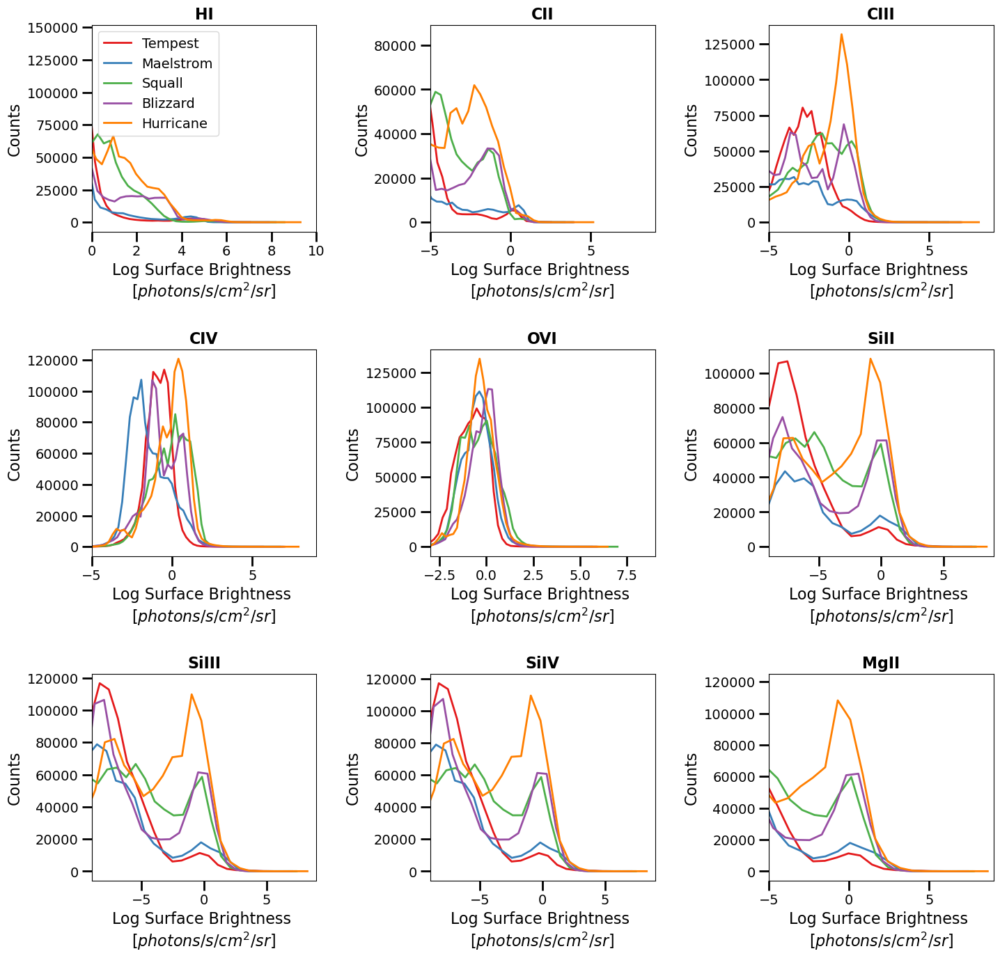

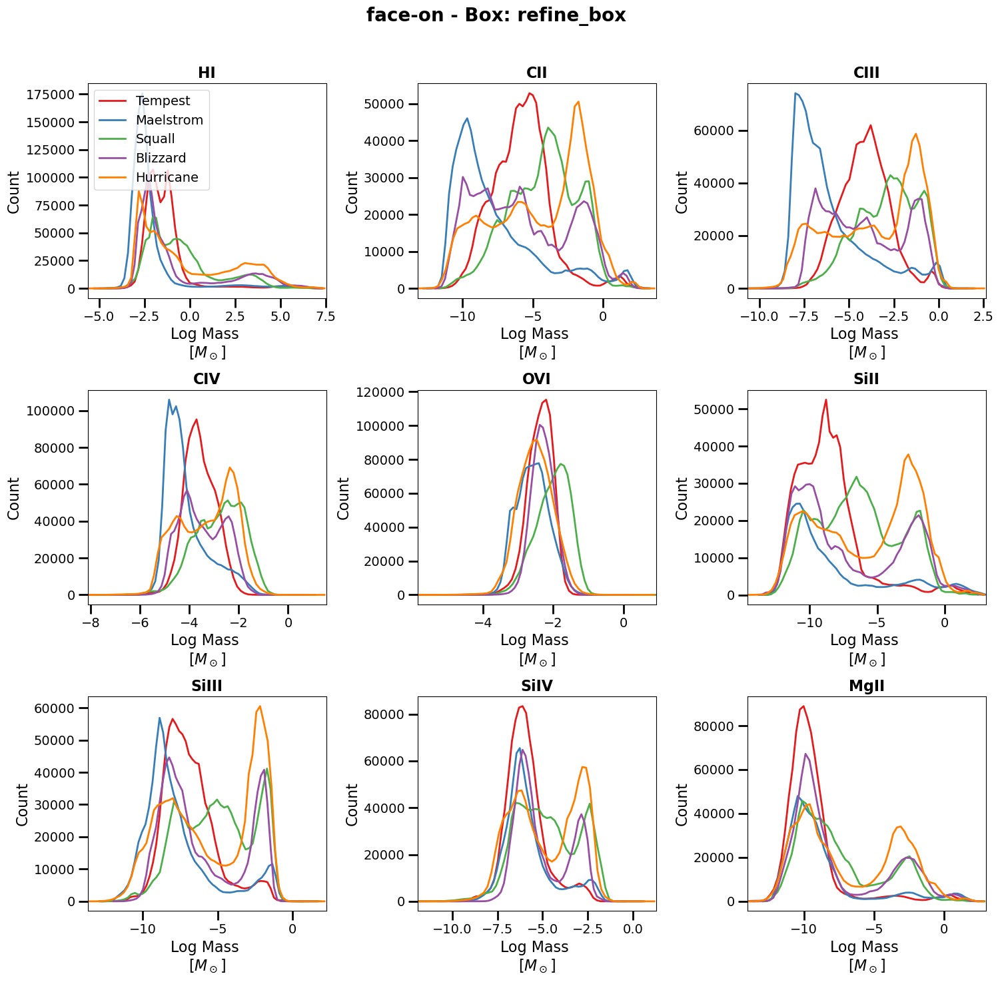

orientation edge
region all
orientation edge
region all
orientation edge
region all
orientation edge
region all
orientation edge
region all


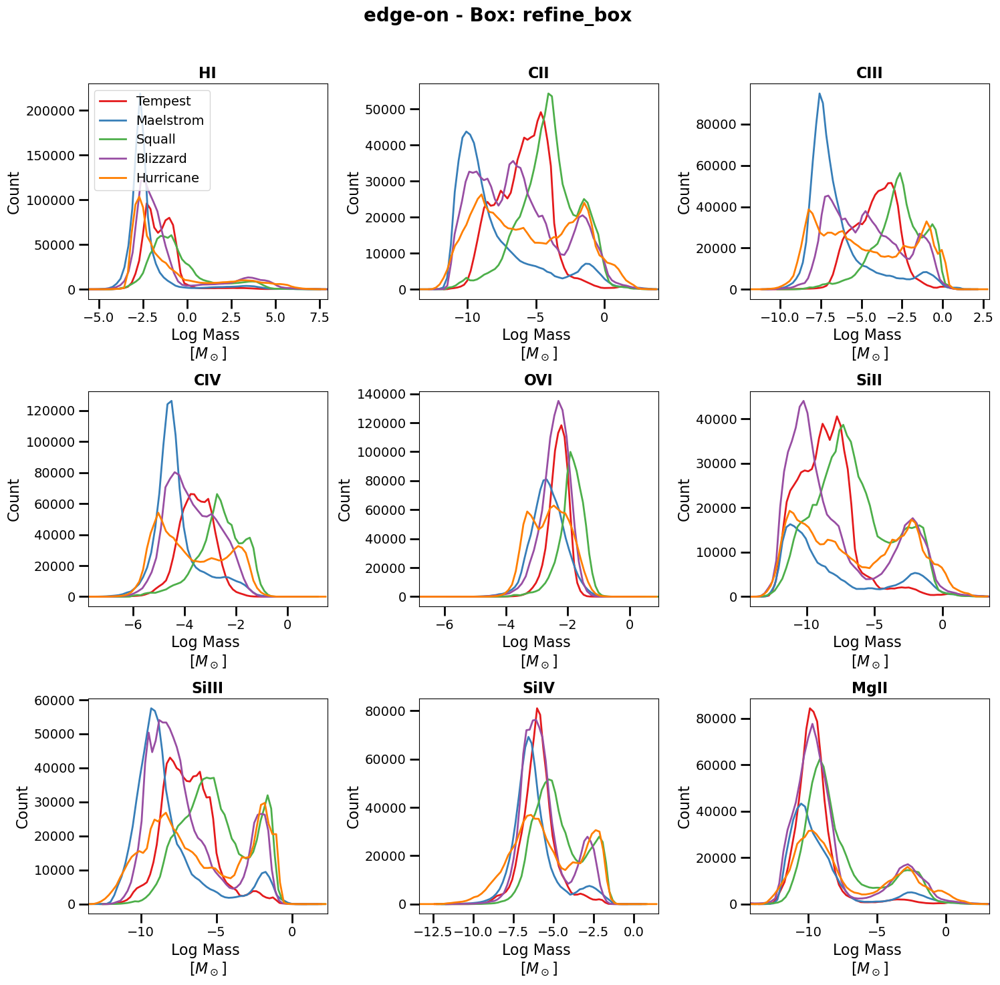

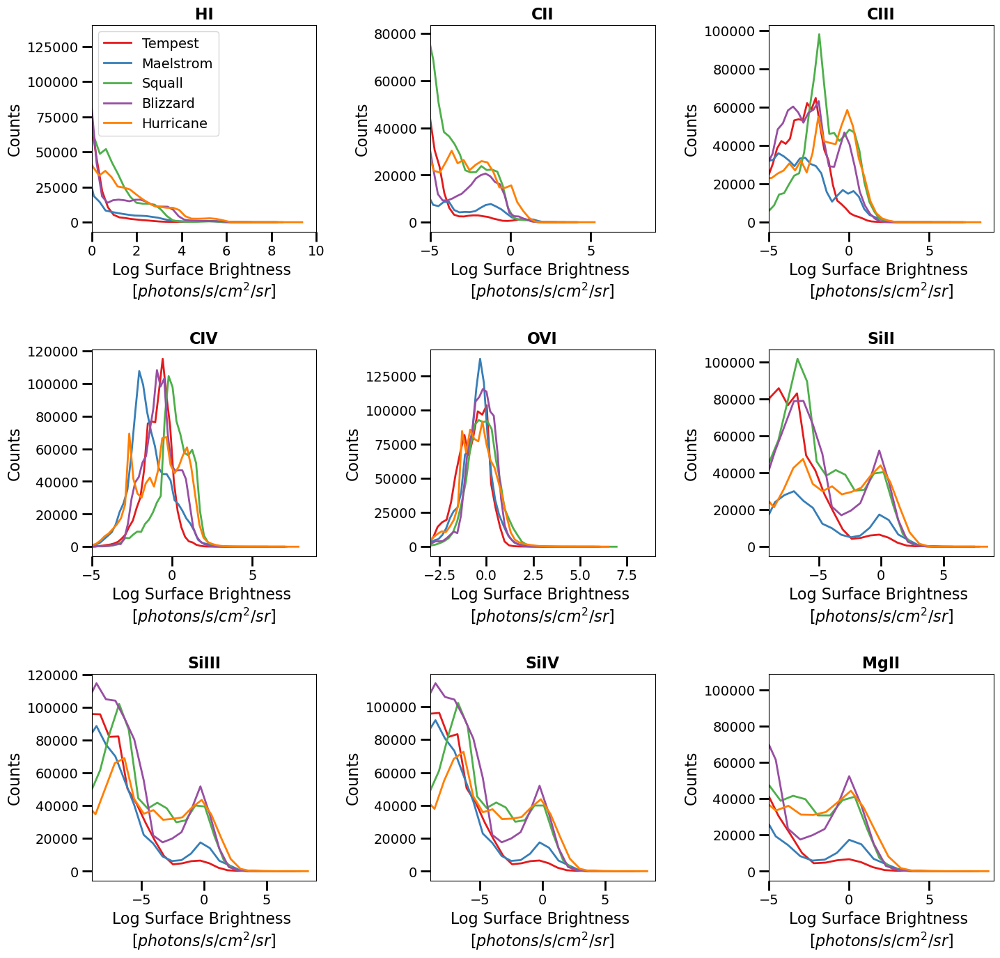

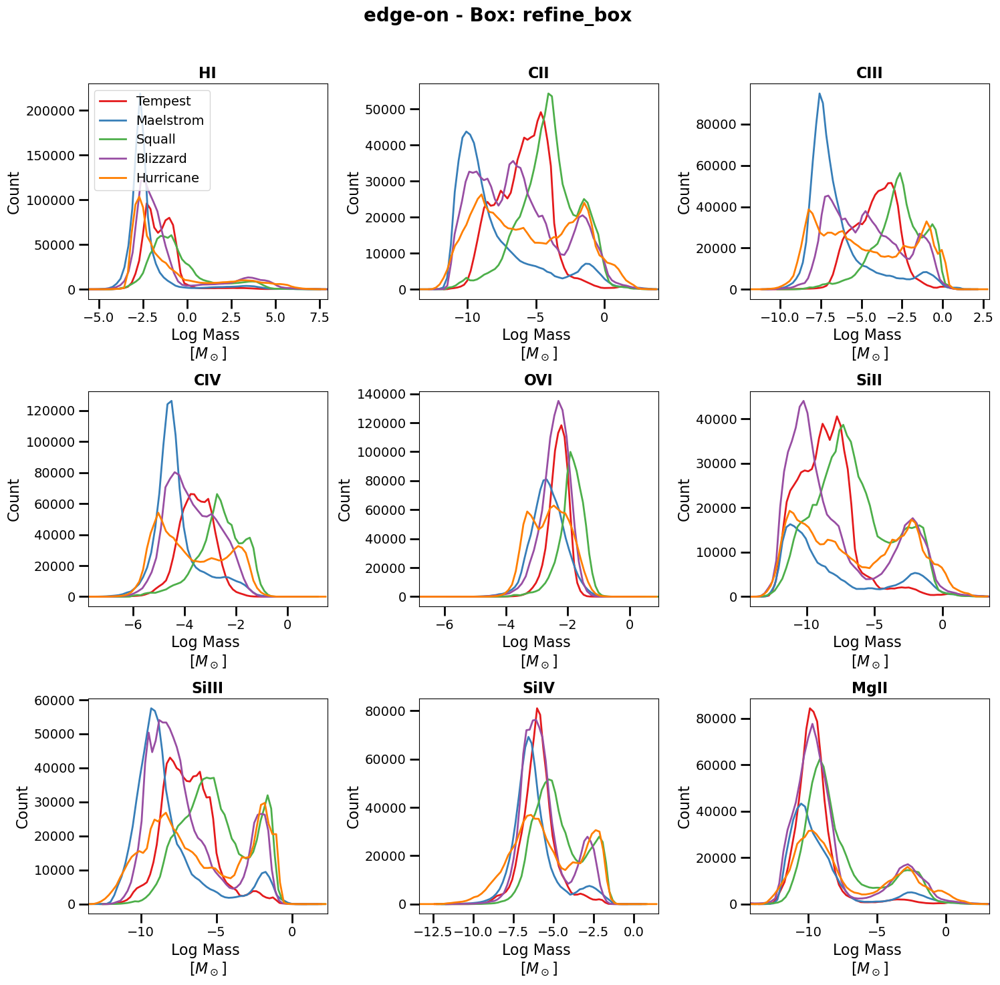

In [25]:
for orientation in orientations:
    detectable_ions = ions
    num_ions = len(detectable_ions)
    cols = __builtins__.min(3, num_ions)  # Limit to max 3 columns per row 
    rows = math.ceil(num_ions / cols)  # Compute required rows

    # --- EMISSION DISTRIBUTION FIGURE ---
    fig_emission, axes_emission = plt.subplots(rows, cols, figsize=(5 * cols, 5 * rows), squeeze=False)
    
    # --- MASS DISTRIBUTION FIGURE ---
    fig_mass, axes_mass = plt.subplots(rows, cols, figsize=(5 * cols, 5 * rows), squeeze=False)

    plt.suptitle(f'{orientation}-on - Box: {box_name}', fontsize=20, fontweight='bold')

    for i, halo in enumerate(halos):
        foggie_dir, code_path, snap_name, halo_c_v_name, trackname, output_dir = generate_foggie_paths(halo, run, snap)
        snap_name = foggie_dir + snap + '/' + snap
        prefix = output_dir + 'plots_halo_00' + halo + '/' + run + '/' + 'res_' + resolution + '/' + 'box_' + box_name + '/'
        
        print('orientation', orientation)

        for region in regions:
            print('region', region)

            halo_name = halo_dict[halo]

            save_path = prefix + 'FRBs/'
            file_path = os.path.join(save_path, f"{halo_name}_emission_maps.hdf5")

            with h5py.File(file_path, 'r') as f:
                for index, ion in enumerate(detectable_ions):
                    row, col = divmod(index, cols)

                    # Axes for emission and mass
                    ax_emission = axes_emission[row, col]
                    ax_mass = axes_mass[row, col]

                    color = cmap(i)  

                    mass_dataset_name = f"z=0.0/{ion}_mass_{orientation}_{region}"
                    emission_dataset_name = f"z=0.0/{ion}_emission_{orientation}_{region}"

                    mass_data = np.array(f[mass_dataset_name]).flatten()
                    emission_data = np.array(f[emission_dataset_name]).flatten()
                    
                    # Filter out invalid values
                    valid_indices = (emission_data > 1e-40) & (mass_data > 0)
                    emission_data = emission_data[valid_indices]
                    mass_data = mass_data[valid_indices]

                    # --- Emission Distribution Plot ---
                    flux_min = np.log10(emission_data).min()
                    flux_max = np.log10(emission_data).max()
                    bins = np.linspace(flux_min, flux_max, 64)
                    bin_centers = 0.5 * (bins[:-1] + bins[1:])
                    mass_per_bin = np.histogram(np.log10(emission_data), bins=bins)[0]#, weights=mass_data)[0]

                    ax_emission.plot(bin_centers, mass_per_bin, color=color, linewidth=2, label=halo_name)
                    ax_emission.set_xlabel('Log Surface Brightness \n[$photons/s/cm^2/sr$]', fontsize=16)
                    ax_emission.set_ylabel('Counts', fontsize=16)#(r'Mass [$M_\odot$]', fontsize=16)
                    ax_emission.set_xlim(x_lim_dict[ion][0], x_lim_dict[ion][1])
                    ax_emission.set_title(f'{ion}', fontsize=16, fontweight='bold')

                    # --- Mass Distribution Plot ---
                    mass_min = np.log10(mass_data).min()
                    mass_max = np.log10(mass_data).max()
                    bins_mass = np.linspace(mass_min, mass_max, 64)
                    bin_centers_mass = 0.5 * (bins_mass[:-1] + bins_mass[1:])
                    mass_histogram = np.histogram(np.log10(mass_data), bins=bins_mass)[0]

                    ax_mass.plot(bin_centers_mass, mass_histogram, color=color, linewidth=2, label=halo_name)
                    ax_mass.set_xlabel('Log Mass \n[$M_\odot$]', fontsize=16)
                    ax_mass.set_ylabel('Count', fontsize=16)
                    ax_mass.set_xlim(mass_min, mass_max)
                    ax_mass.set_title(f'{ion}', fontsize=16, fontweight='bold')

                    # Formatting for both plots
                    for ax in [ax_emission, ax_mass]:
                        ax.spines.values()
                        ax.tick_params(axis='both', which='major', labelsize=14, length=10, width=2, color="k", labelcolor="k", direction="out", top=False, right=False)
                        ax.tick_params(axis='both', which='minor', labelsize=14, length=5, width=1, color="k", labelcolor="k", direction="out", top=False, right=False)
                        ax.yaxis.offsetText.set_fontsize(14)

                    if ion == 'HI':
                        ax_emission.legend(loc='upper left', fontsize=14)
                        ax_mass.legend(loc='upper left', fontsize=14)

    # Remove empty subplots if any
    for j in range(index + 1, len(axes_emission.flatten())):
        fig_emission.delaxes(axes_emission.flatten()[j])
        fig_mass.delaxes(axes_mass.flatten()[j])

    plt.tight_layout(rect=[0, 0, 1, 0.96])

    # Save figures
    plot_dir = os.path.join(output_dir, "allhalos_distribution_plots")
    os.makedirs(plot_dir, exist_ok=True)

    # Adjust layout and spacing for Emission Distribution Figure
    fig_emission.tight_layout(rect=[0, 0, 1, 0.96], pad=3.0, h_pad=3.0)
    plt.figure(fig_emission)
    plt.savefig(os.path.join(plot_dir, f"{orientation}_emission_distribution.png"))
    plt.show()
    plt.close(fig_emission)

    plt.figure(fig_mass)
    plt.savefig(os.path.join(plot_dir, f"{orientation}_mass_distribution.png"))
    plt.show()
    plt.close(fig_mass)


yt : [INFO     ] 2025-03-17 11:16:22,393 Parameters: current_time              = 639.44480357087
yt : [INFO     ] 2025-03-17 11:16:22,394 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2025-03-17 11:16:22,394 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2025-03-17 11:16:22,394 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2025-03-17 11:16:22,394 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2025-03-17 11:16:22,395 Parameters: current_redshift          = 0
yt : [INFO     ] 2025-03-17 11:16:22,395 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2025-03-17 11:16:22,395 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2025-03-17 11:16:22,395 Parameters: omega_radiation           = 0
yt : [INFO     ] 2025-03-17 11:16:22,396 Parameters: hubble_constant           = 0.695


orientation face
Opening snapshot /Users/vidasaeedzadeh/Projects/foggie_data/halo_008508/nref11c_nref9f/RD0042/RD0042
get_refine_box: using this location:         col1          col2     col3     col4    col5     col6     col7  col8
------------------- -------- -------- ------- -------- -------- ------- ----
4.4408920985006e-16 0.488865 0.470316 0.50854 0.490865 0.472316 0.51054    9


Parsing Hierarchy : 100%|██████████| 4251/4251 [00:00<00:00, 13471.59it/s]
yt : [INFO     ] 2025-03-17 11:16:22,784 Gathering a field list (this may take a moment.)
yt : [WARNING  ] 2025-03-17 11:16:23,057 The young_stars particle filter already exists. Overriding.
yt : [WARNING  ] 2025-03-17 11:16:23,062 The young_stars3 particle filter already exists. Overriding.
yt : [WARNING  ] 2025-03-17 11:16:23,067 The young_stars8 particle filter already exists. Overriding.
yt : [WARNING  ] 2025-03-17 11:16:23,073 The old_stars particle filter already exists. Overriding.
yt : [WARNING  ] 2025-03-17 11:16:23,078 The stars particle filter already exists. Overriding.
yt : [WARNING  ] 2025-03-17 11:16:23,082 The dm particle filter already exists. Overriding.


Pulling halo center from catalog file
filtering young_stars particles...
filtering young_stars3 particles...
filtering young_stars8 particles...
filtering old_stars particles...
filtering stars particles...
filtering dm particles...
using particle type  young_stars  to derive angular momentum


yt : [WARNING  ] 2025-03-17 11:16:33,666 Field ('gas', 'H_p0_number_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:16:33,667 Field ('gas', 'H_p0_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:16:33,667 Field ('gas', 'H_p0_mass') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:16:33,731 Field ('gas', 'H_p0_ion_fraction') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:16:33,731 Field ('gas', 'H_p0_number_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:16:33,732 Field ('gas', 'H_p0_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:16:33,732 Field ('gas', 'H_p0_mass') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:16:33,732 Field ('gas', 'C_p1_ion_fraction') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:16:33,732 Field ('gas', 'C_p1_number_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:16:33,732 Field (

found angular momentum vector
region all


yt : [WARNING  ] 2025-03-17 11:16:35,347 Field ('gas', 'H_p0_ion_fraction') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:16:35,347 Field ('gas', 'H_p0_number_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:16:35,348 Field ('gas', 'H_p0_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:16:35,348 Field ('gas', 'H_p0_mass') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:16:35,348 Field ('gas', 'C_p1_ion_fraction') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:16:35,348 Field ('gas', 'C_p1_number_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:16:35,349 Field ('gas', 'C_p1_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:16:35,349 Field ('gas', 'C_p1_mass') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:16:35,349 Field ('gas', 'C_p2_ion_fraction') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:16:35,349 Field ('g

orientation face
Opening snapshot /Users/vidasaeedzadeh/Projects/foggie_data/halo_005036/nref11c_nref9f/RD0042/RD0042
get_refine_box: using this location: col1   col2     col3     col4     col5     col6     col7   col8
---- -------- -------- -------- -------- -------- -------- ----
 0.0 0.465138 0.500866 0.499993 0.467138 0.502866 0.501993    9


Parsing Hierarchy : 100%|██████████| 6108/6108 [00:00<00:00, 15411.54it/s]
yt : [INFO     ] 2025-03-17 11:17:18,277 Gathering a field list (this may take a moment.)
yt : [WARNING  ] 2025-03-17 11:17:18,564 The young_stars particle filter already exists. Overriding.
yt : [WARNING  ] 2025-03-17 11:17:18,569 The young_stars3 particle filter already exists. Overriding.
yt : [WARNING  ] 2025-03-17 11:17:18,573 The young_stars8 particle filter already exists. Overriding.
yt : [WARNING  ] 2025-03-17 11:17:18,577 The old_stars particle filter already exists. Overriding.
yt : [WARNING  ] 2025-03-17 11:17:18,582 The stars particle filter already exists. Overriding.
yt : [WARNING  ] 2025-03-17 11:17:18,587 The dm particle filter already exists. Overriding.


Pulling halo center from catalog file
filtering young_stars particles...
filtering young_stars3 particles...
filtering young_stars8 particles...
filtering old_stars particles...
filtering stars particles...
filtering dm particles...
using particle type  young_stars  to derive angular momentum


yt : [WARNING  ] 2025-03-17 11:17:28,719 Field ('gas', 'H_p0_number_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:17:28,719 Field ('gas', 'H_p0_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:17:28,720 Field ('gas', 'H_p0_mass') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:17:28,787 Field ('gas', 'H_p0_ion_fraction') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:17:28,787 Field ('gas', 'H_p0_number_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:17:28,787 Field ('gas', 'H_p0_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:17:28,788 Field ('gas', 'H_p0_mass') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:17:28,788 Field ('gas', 'C_p1_ion_fraction') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:17:28,788 Field ('gas', 'C_p1_number_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:17:28,788 Field (

found angular momentum vector
region all


yt : [WARNING  ] 2025-03-17 11:17:32,483 Field ('gas', 'H_p0_ion_fraction') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:17:32,484 Field ('gas', 'H_p0_number_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:17:32,484 Field ('gas', 'H_p0_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:17:32,484 Field ('gas', 'H_p0_mass') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:17:32,484 Field ('gas', 'C_p1_ion_fraction') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:17:32,484 Field ('gas', 'C_p1_number_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:17:32,485 Field ('gas', 'C_p1_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:17:32,485 Field ('gas', 'C_p1_mass') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:17:32,485 Field ('gas', 'C_p2_ion_fraction') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:17:32,486 Field ('g

orientation face
Opening snapshot /Users/vidasaeedzadeh/Projects/foggie_data/halo_005016/nref11c_nref9f/RD0042/RD0042
get_refine_box: using this location: col1   col2     col3     col4    col5     col6     col7  col8
---- -------- -------- ------- -------- -------- ------- ----
 0.0 0.540194 0.449845 0.51256 0.542194 0.451845 0.51456    9


Parsing Hierarchy : 100%|██████████| 9304/9304 [00:00<00:00, 21117.38it/s]
yt : [INFO     ] 2025-03-17 11:18:24,976 Gathering a field list (this may take a moment.)
yt : [WARNING  ] 2025-03-17 11:18:25,258 The young_stars particle filter already exists. Overriding.
yt : [WARNING  ] 2025-03-17 11:18:25,263 The young_stars3 particle filter already exists. Overriding.
yt : [WARNING  ] 2025-03-17 11:18:25,267 The young_stars8 particle filter already exists. Overriding.
yt : [WARNING  ] 2025-03-17 11:18:25,271 The old_stars particle filter already exists. Overriding.
yt : [WARNING  ] 2025-03-17 11:18:25,275 The stars particle filter already exists. Overriding.
yt : [WARNING  ] 2025-03-17 11:18:25,279 The dm particle filter already exists. Overriding.


Pulling halo center from catalog file
filtering young_stars particles...
filtering young_stars3 particles...
filtering young_stars8 particles...
filtering old_stars particles...
filtering stars particles...
filtering dm particles...
using particle type  young_stars  to derive angular momentum


yt : [WARNING  ] 2025-03-17 11:18:32,566 Field ('gas', 'H_p0_number_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:18:32,567 Field ('gas', 'H_p0_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:18:32,567 Field ('gas', 'H_p0_mass') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:18:32,638 Field ('gas', 'H_p0_ion_fraction') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:18:32,638 Field ('gas', 'H_p0_number_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:18:32,638 Field ('gas', 'H_p0_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:18:32,639 Field ('gas', 'H_p0_mass') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:18:32,639 Field ('gas', 'C_p1_ion_fraction') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:18:32,639 Field ('gas', 'C_p1_number_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:18:32,639 Field (

found angular momentum vector
region all


yt : [WARNING  ] 2025-03-17 11:18:37,769 Field ('gas', 'H_p0_ion_fraction') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:18:37,770 Field ('gas', 'H_p0_number_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:18:37,770 Field ('gas', 'H_p0_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:18:37,770 Field ('gas', 'H_p0_mass') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:18:37,770 Field ('gas', 'C_p1_ion_fraction') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:18:37,771 Field ('gas', 'C_p1_number_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:18:37,771 Field ('gas', 'C_p1_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:18:37,771 Field ('gas', 'C_p1_mass') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:18:37,771 Field ('gas', 'C_p2_ion_fraction') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:18:37,771 Field ('g

orientation face
Opening snapshot /Users/vidasaeedzadeh/Projects/foggie_data/halo_004123/nref11c_nref9f/RD0042/RD0042
get_refine_box: using this location: col1   col2     col3     col4     col5     col6     col7   col8
---- -------- -------- -------- -------- -------- -------- ----
 0.0 0.470478 0.453589 0.468129 0.472478 0.455589 0.470129    9


Parsing Hierarchy : 100%|██████████| 11709/11709 [00:00<00:00, 21344.82it/s]
yt : [INFO     ] 2025-03-17 11:19:57,432 Gathering a field list (this may take a moment.)
yt : [WARNING  ] 2025-03-17 11:19:57,718 The young_stars particle filter already exists. Overriding.
yt : [WARNING  ] 2025-03-17 11:19:57,723 The young_stars3 particle filter already exists. Overriding.
yt : [WARNING  ] 2025-03-17 11:19:57,727 The young_stars8 particle filter already exists. Overriding.
yt : [WARNING  ] 2025-03-17 11:19:57,731 The old_stars particle filter already exists. Overriding.
yt : [WARNING  ] 2025-03-17 11:19:57,736 The stars particle filter already exists. Overriding.
yt : [WARNING  ] 2025-03-17 11:19:57,741 The dm particle filter already exists. Overriding.


Pulling halo center from catalog file
filtering young_stars particles...
filtering young_stars3 particles...
filtering young_stars8 particles...
filtering old_stars particles...
filtering stars particles...
filtering dm particles...
using particle type  young_stars  to derive angular momentum


yt : [WARNING  ] 2025-03-17 11:20:12,486 Field ('gas', 'H_p0_number_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:20:12,486 Field ('gas', 'H_p0_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:20:12,486 Field ('gas', 'H_p0_mass') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:20:12,548 Field ('gas', 'H_p0_ion_fraction') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:20:12,549 Field ('gas', 'H_p0_number_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:20:12,549 Field ('gas', 'H_p0_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:20:12,549 Field ('gas', 'H_p0_mass') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:20:12,549 Field ('gas', 'C_p1_ion_fraction') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:20:12,550 Field ('gas', 'C_p1_number_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:20:12,550 Field (

found angular momentum vector
region all


yt : [WARNING  ] 2025-03-17 11:20:18,353 Field ('gas', 'H_p0_ion_fraction') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:20:18,353 Field ('gas', 'H_p0_number_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:20:18,354 Field ('gas', 'H_p0_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:20:18,354 Field ('gas', 'H_p0_mass') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:20:18,354 Field ('gas', 'C_p1_ion_fraction') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:20:18,354 Field ('gas', 'C_p1_number_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:20:18,355 Field ('gas', 'C_p1_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:20:18,355 Field ('gas', 'C_p1_mass') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:20:18,355 Field ('gas', 'C_p2_ion_fraction') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:20:18,355 Field ('g

orientation face
Opening snapshot /Users/vidasaeedzadeh/Projects/foggie_data/halo_002392/nref11c_nref9f/RD0042/RD0042
get_refine_box: using this location: col1   col2     col3     col4     col5     col6     col7   col8
---- -------- -------- -------- -------- -------- -------- ----
 0.0 0.494542 0.471819 0.457278 0.496542 0.473819 0.459278    9


Parsing Hierarchy : 100%|██████████| 16682/16682 [00:00<00:00, 25257.29it/s]
yt : [INFO     ] 2025-03-17 11:21:47,510 Gathering a field list (this may take a moment.)
yt : [WARNING  ] 2025-03-17 11:21:47,798 The young_stars particle filter already exists. Overriding.
yt : [WARNING  ] 2025-03-17 11:21:47,802 The young_stars3 particle filter already exists. Overriding.
yt : [WARNING  ] 2025-03-17 11:21:47,807 The young_stars8 particle filter already exists. Overriding.
yt : [WARNING  ] 2025-03-17 11:21:47,811 The old_stars particle filter already exists. Overriding.
yt : [WARNING  ] 2025-03-17 11:21:47,815 The stars particle filter already exists. Overriding.
yt : [WARNING  ] 2025-03-17 11:21:47,820 The dm particle filter already exists. Overriding.


Pulling halo center from catalog file
filtering young_stars particles...
filtering young_stars3 particles...
filtering young_stars8 particles...
filtering old_stars particles...
filtering stars particles...
filtering dm particles...
using particle type  young_stars  to derive angular momentum


yt : [WARNING  ] 2025-03-17 11:22:04,855 Field ('gas', 'H_p0_number_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:22:04,855 Field ('gas', 'H_p0_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:22:04,855 Field ('gas', 'H_p0_mass') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:22:04,917 Field ('gas', 'H_p0_ion_fraction') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:22:04,917 Field ('gas', 'H_p0_number_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:22:04,918 Field ('gas', 'H_p0_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:22:04,918 Field ('gas', 'H_p0_mass') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:22:04,918 Field ('gas', 'C_p1_ion_fraction') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:22:04,918 Field ('gas', 'C_p1_number_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:22:04,919 Field (

found angular momentum vector
region all


yt : [WARNING  ] 2025-03-17 11:22:13,157 Field ('gas', 'H_p0_ion_fraction') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:22:13,157 Field ('gas', 'H_p0_number_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:22:13,158 Field ('gas', 'H_p0_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:22:13,158 Field ('gas', 'H_p0_mass') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:22:13,158 Field ('gas', 'C_p1_ion_fraction') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:22:13,158 Field ('gas', 'C_p1_number_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:22:13,158 Field ('gas', 'C_p1_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:22:13,159 Field ('gas', 'C_p1_mass') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:22:13,159 Field ('gas', 'C_p2_ion_fraction') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:22:13,159 Field ('g

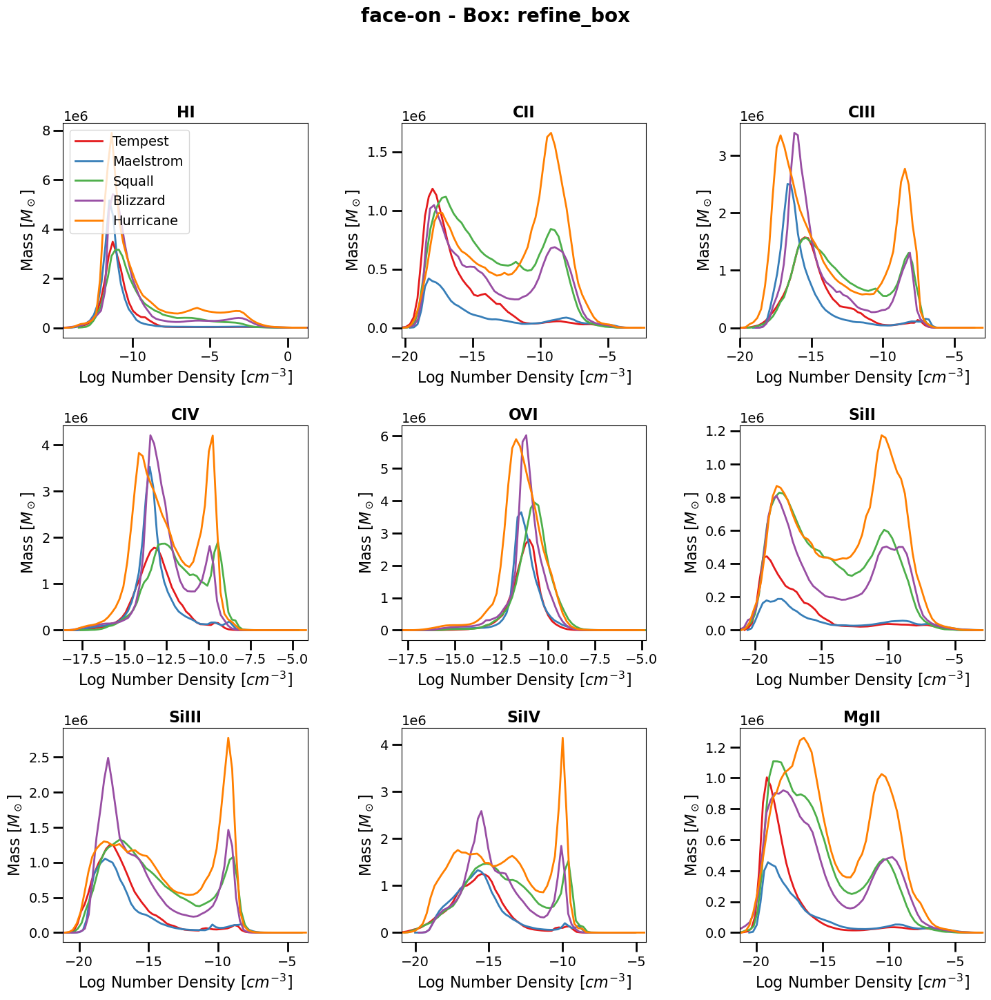

yt : [INFO     ] 2025-03-17 11:24:22,537 Parameters: current_time              = 639.44480357087
yt : [INFO     ] 2025-03-17 11:24:22,537 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2025-03-17 11:24:22,537 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2025-03-17 11:24:22,538 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2025-03-17 11:24:22,538 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2025-03-17 11:24:22,538 Parameters: current_redshift          = 0
yt : [INFO     ] 2025-03-17 11:24:22,538 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2025-03-17 11:24:22,538 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2025-03-17 11:24:22,539 Parameters: omega_radiation           = 0
yt : [INFO     ] 2025-03-17 11:24:22,539 Parameters: hubble_constant           = 0.695


orientation edge
Opening snapshot /Users/vidasaeedzadeh/Projects/foggie_data/halo_008508/nref11c_nref9f/RD0042/RD0042
get_refine_box: using this location:         col1          col2     col3     col4    col5     col6     col7  col8
------------------- -------- -------- ------- -------- -------- ------- ----
4.4408920985006e-16 0.488865 0.470316 0.50854 0.490865 0.472316 0.51054    9


Parsing Hierarchy : 100%|██████████| 4251/4251 [00:00<00:00, 50038.83it/s]
yt : [INFO     ] 2025-03-17 11:24:22,695 Gathering a field list (this may take a moment.)
yt : [WARNING  ] 2025-03-17 11:24:22,959 The young_stars particle filter already exists. Overriding.
yt : [WARNING  ] 2025-03-17 11:24:22,965 The young_stars3 particle filter already exists. Overriding.
yt : [WARNING  ] 2025-03-17 11:24:22,969 The young_stars8 particle filter already exists. Overriding.
yt : [WARNING  ] 2025-03-17 11:24:22,974 The old_stars particle filter already exists. Overriding.
yt : [WARNING  ] 2025-03-17 11:24:22,978 The stars particle filter already exists. Overriding.
yt : [WARNING  ] 2025-03-17 11:24:22,984 The dm particle filter already exists. Overriding.


Pulling halo center from catalog file
filtering young_stars particles...
filtering young_stars3 particles...
filtering young_stars8 particles...
filtering old_stars particles...
filtering stars particles...
filtering dm particles...
using particle type  young_stars  to derive angular momentum


yt : [WARNING  ] 2025-03-17 11:24:32,627 Field ('gas', 'H_p0_number_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:24:32,628 Field ('gas', 'H_p0_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:24:32,628 Field ('gas', 'H_p0_mass') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:24:32,694 Field ('gas', 'H_p0_ion_fraction') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:24:32,694 Field ('gas', 'H_p0_number_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:24:32,695 Field ('gas', 'H_p0_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:24:32,695 Field ('gas', 'H_p0_mass') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:24:32,695 Field ('gas', 'C_p1_ion_fraction') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:24:32,695 Field ('gas', 'C_p1_number_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:24:32,695 Field (

found angular momentum vector
region all


yt : [WARNING  ] 2025-03-17 11:24:34,239 Field ('gas', 'H_p0_ion_fraction') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:24:34,239 Field ('gas', 'H_p0_number_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:24:34,239 Field ('gas', 'H_p0_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:24:34,239 Field ('gas', 'H_p0_mass') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:24:34,240 Field ('gas', 'C_p1_ion_fraction') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:24:34,240 Field ('gas', 'C_p1_number_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:24:34,240 Field ('gas', 'C_p1_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:24:34,240 Field ('gas', 'C_p1_mass') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:24:34,241 Field ('gas', 'C_p2_ion_fraction') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:24:34,241 Field ('g

orientation edge
Opening snapshot /Users/vidasaeedzadeh/Projects/foggie_data/halo_005036/nref11c_nref9f/RD0042/RD0042
get_refine_box: using this location: col1   col2     col3     col4     col5     col6     col7   col8
---- -------- -------- -------- -------- -------- -------- ----
 0.0 0.465138 0.500866 0.499993 0.467138 0.502866 0.501993    9


Parsing Hierarchy : 100%|██████████| 6108/6108 [00:00<00:00, 10381.93it/s]
yt : [INFO     ] 2025-03-17 11:25:17,708 Gathering a field list (this may take a moment.)
yt : [WARNING  ] 2025-03-17 11:25:17,971 The young_stars particle filter already exists. Overriding.
yt : [WARNING  ] 2025-03-17 11:25:17,975 The young_stars3 particle filter already exists. Overriding.
yt : [WARNING  ] 2025-03-17 11:25:17,979 The young_stars8 particle filter already exists. Overriding.
yt : [WARNING  ] 2025-03-17 11:25:17,983 The old_stars particle filter already exists. Overriding.
yt : [WARNING  ] 2025-03-17 11:25:17,988 The stars particle filter already exists. Overriding.
yt : [WARNING  ] 2025-03-17 11:25:17,992 The dm particle filter already exists. Overriding.


Pulling halo center from catalog file
filtering young_stars particles...
filtering young_stars3 particles...
filtering young_stars8 particles...
filtering old_stars particles...
filtering stars particles...
filtering dm particles...
using particle type  young_stars  to derive angular momentum


yt : [WARNING  ] 2025-03-17 11:25:27,717 Field ('gas', 'H_p0_number_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:25:27,717 Field ('gas', 'H_p0_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:25:27,718 Field ('gas', 'H_p0_mass') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:25:27,787 Field ('gas', 'H_p0_ion_fraction') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:25:27,788 Field ('gas', 'H_p0_number_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:25:27,788 Field ('gas', 'H_p0_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:25:27,788 Field ('gas', 'H_p0_mass') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:25:27,788 Field ('gas', 'C_p1_ion_fraction') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:25:27,789 Field ('gas', 'C_p1_number_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:25:27,789 Field (

found angular momentum vector
region all


yt : [WARNING  ] 2025-03-17 11:25:29,653 Field ('gas', 'H_p0_ion_fraction') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:25:29,654 Field ('gas', 'H_p0_number_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:25:29,654 Field ('gas', 'H_p0_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:25:29,654 Field ('gas', 'H_p0_mass') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:25:29,654 Field ('gas', 'C_p1_ion_fraction') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:25:29,654 Field ('gas', 'C_p1_number_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:25:29,655 Field ('gas', 'C_p1_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:25:29,655 Field ('gas', 'C_p1_mass') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:25:29,655 Field ('gas', 'C_p2_ion_fraction') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:25:29,655 Field ('g

orientation edge
Opening snapshot /Users/vidasaeedzadeh/Projects/foggie_data/halo_005016/nref11c_nref9f/RD0042/RD0042
get_refine_box: using this location: col1   col2     col3     col4    col5     col6     col7  col8
---- -------- -------- ------- -------- -------- ------- ----
 0.0 0.540194 0.449845 0.51256 0.542194 0.451845 0.51456    9


Parsing Hierarchy : 100%|██████████| 9304/9304 [00:00<00:00, 10440.01it/s]
yt : [INFO     ] 2025-03-17 11:26:21,290 Gathering a field list (this may take a moment.)
yt : [WARNING  ] 2025-03-17 11:26:21,556 The young_stars particle filter already exists. Overriding.
yt : [WARNING  ] 2025-03-17 11:26:21,560 The young_stars3 particle filter already exists. Overriding.
yt : [WARNING  ] 2025-03-17 11:26:21,564 The young_stars8 particle filter already exists. Overriding.
yt : [WARNING  ] 2025-03-17 11:26:21,569 The old_stars particle filter already exists. Overriding.
yt : [WARNING  ] 2025-03-17 11:26:21,573 The stars particle filter already exists. Overriding.
yt : [WARNING  ] 2025-03-17 11:26:21,578 The dm particle filter already exists. Overriding.


Pulling halo center from catalog file
filtering young_stars particles...
filtering young_stars3 particles...
filtering young_stars8 particles...
filtering old_stars particles...
filtering stars particles...
filtering dm particles...
using particle type  young_stars  to derive angular momentum


yt : [WARNING  ] 2025-03-17 11:26:29,127 Field ('gas', 'H_p0_number_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:26:29,128 Field ('gas', 'H_p0_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:26:29,128 Field ('gas', 'H_p0_mass') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:26:29,197 Field ('gas', 'H_p0_ion_fraction') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:26:29,198 Field ('gas', 'H_p0_number_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:26:29,198 Field ('gas', 'H_p0_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:26:29,198 Field ('gas', 'H_p0_mass') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:26:29,199 Field ('gas', 'C_p1_ion_fraction') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:26:29,199 Field ('gas', 'C_p1_number_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:26:29,199 Field (

found angular momentum vector
region all


yt : [WARNING  ] 2025-03-17 11:26:31,916 Field ('gas', 'H_p0_ion_fraction') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:26:31,916 Field ('gas', 'H_p0_number_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:26:31,917 Field ('gas', 'H_p0_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:26:31,917 Field ('gas', 'H_p0_mass') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:26:31,917 Field ('gas', 'C_p1_ion_fraction') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:26:31,917 Field ('gas', 'C_p1_number_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:26:31,918 Field ('gas', 'C_p1_density') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:26:31,918 Field ('gas', 'C_p1_mass') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:26:31,918 Field ('gas', 'C_p2_ion_fraction') already exists. Not clobbering.
yt : [WARNING  ] 2025-03-17 11:26:31,919 Field ('g

KeyboardInterrupt: 

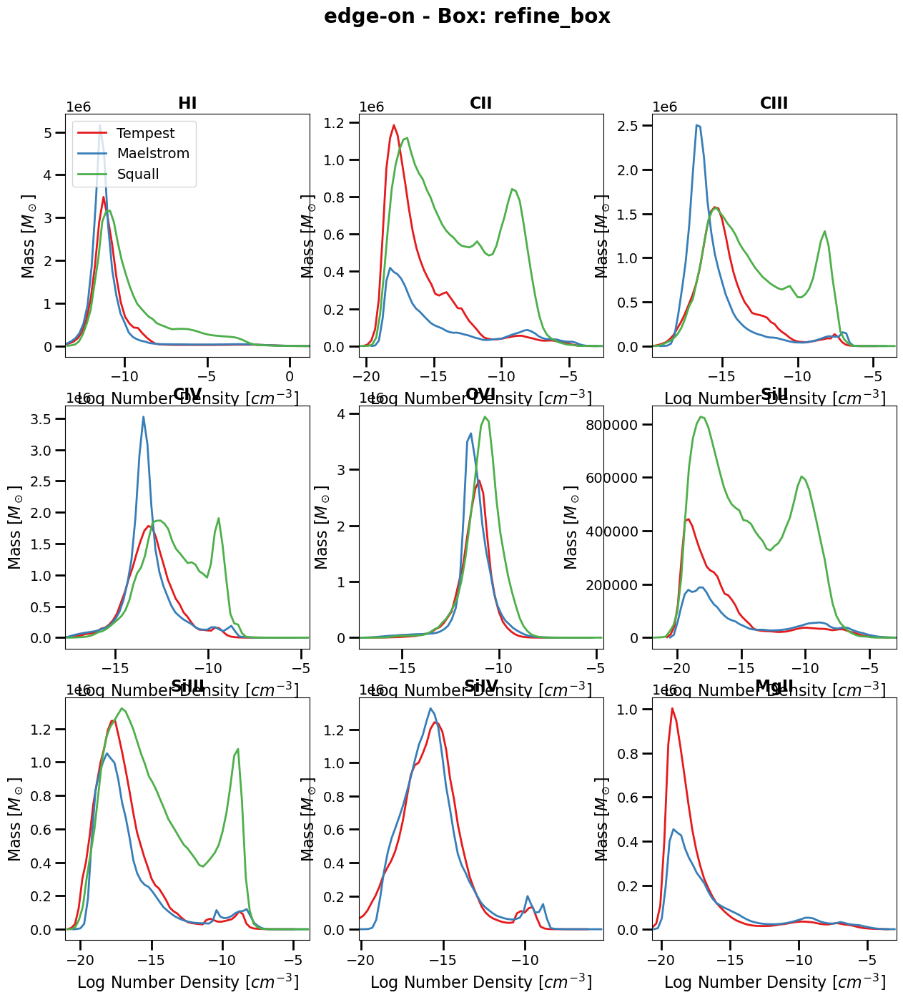

In [24]:
for orientation in orientations:
    detectable_ions = ions
    num_ions = len(detectable_ions)
    cols = __builtins__.min(3, num_ions)  # Limit to max 3 columns per row 
    rows = math.ceil(num_ions / cols)  # Compute required rows

    

    # --- NUMBER DENSITY DISTRIBUTION FIGURE ---
    fig_density, axes_density = plt.subplots(rows, cols, figsize=(5 * cols, 5 * rows), squeeze=False)

    plt.suptitle(f'{orientation}-on - Box: {box_name}', fontsize=20, fontweight='bold')

    for i, halo in enumerate(halos):
        foggie_dir, code_path, snap_name, halo_c_v_name, trackname, output_dir = generate_foggie_paths(halo, run, snap)
        snap_name = foggie_dir + snap + '/' + snap
        prefix = output_dir + 'plots_halo_00' + halo + '/' + run + '/' + 'res_' + resolution + '/' + 'box_' + box_name + '/'

        print('orientation', orientation)
            
        ds, refine_box = foggie_load(snap_name, trackname, do_filter_particles=True, halo_c_v_name=halo_c_v_name, disk_relative=True, correct_bulk_velocity=True)#, smooth_AM_name=smooth_AM_name)
        zsnap = ds.get_parameter('CosmologyCurrentRedshift')
        add_ion_fields(ds,ions)

        for region in regions:
            print('region', region)

            halo_name = halo_dict[halo]

            save_path = prefix + 'FRBs/'
            file_path = os.path.join(save_path, f"{halo_name}_emission_maps.hdf5")

            with h5py.File(file_path, 'r') as f:
                for index, ion in enumerate(detectable_ions):
                    row, col = divmod(index, cols)

                    ax_density = axes_density[row, col]
                    color = cmap(i)  

                    add_ion_fields(ds, ions)
                    add_ion_fields(ds, ions)

                    ion_density_field = ions_number_density_dict[ion]
                    number_density_data = refine_box[("gas", ion_density_field)].to('cm**-3').flatten().v
                    mass_data = refine_box[("gas", "mass")].to('Msun').flatten().v
                    
                    # Apply the same filtering as in the previous plots
                    valid_indices = (number_density_data > 0)
                    mass_data = mass_data[valid_indices]
                    number_density_data = number_density_data[valid_indices]  # Apply same filter

                    # --- Number Density Distribution Plot ---
                    density_min = np.log10(number_density_data).min()
                    density_max = np.log10(number_density_data).max()
                    bins = np.linspace(density_min, density_max, 64)
                    bin_centers = 0.5 * (bins[:-1] + bins[1:])
                    density_histogram = np.histogram(np.log10(number_density_data), bins=bins)[0]

                    ax_density.plot(bin_centers, density_histogram, color=color, linewidth=2, label=halo_name)
                    ax_density.set_xlabel(r'Log Number Density [$cm^{-3}$]', fontsize=16)
                    ax_density.set_ylabel(r'Mass [$M_\odot$]', fontsize=16)
                    ax_density.set_xlim(density_min, density_max)
                    ax_density.set_title(f'{ion}', fontsize=16, fontweight='bold')

                    # Formatting
                    for ax in [ax_density]:
                        ax.spines.values()
                        ax.tick_params(axis='both', which='major', labelsize=14, length=10, width=2, color="k", labelcolor="k", direction="out", top=False, right=False)
                        ax.tick_params(axis='both', which='minor', labelsize=14, length=5, width=1, color="k", labelcolor="k", direction="out", top=False, right=False)
                        ax.yaxis.offsetText.set_fontsize(14)

                    if ion == 'HI':
                        ax_density.legend(loc='upper left', fontsize=14)

    # Remove empty subplots if any
    for j in range(index + 1, len(axes_density.flatten())):
        fig_density.delaxes(axes_density.flatten()[j])

    # Adjust layout and spacing
    fig_density.tight_layout(rect=[0, 0, 1, 0.96], pad=3.0, h_pad=2.0)

    # Save figure
    plot_dir = os.path.join(output_dir, "allhalos_number_density_plots")
    os.makedirs(plot_dir, exist_ok=True)

    plt.figure(fig_density)
    plt.savefig(os.path.join(plot_dir, f"{orientation}_number_density_distribution.png"))
    plt.show()
    plt.close(fig_density)
